<a href="https://colab.research.google.com/github/ayefern/Senior-Capstone/blob/main/MLB_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import display
from seaborn.regression import statsmodels
# Import libraries
import statsmodels as sm
from statsmodels.tsa.api import ExponentialSmoothing, SimpleExpSmoothing, Holt
!git clone https://github.com/aborbon5/MLB_Capstone2025
%cd MLB_Capstone2025/datasets

Cloning into 'MLB_Capstone2025'...
remote: Enumerating objects: 50, done.
remote: Counting objects: 100% (50/50), done.
remote: Compressing objects: 100% (47/47), done.
remote: Total 50 (delta 14), reused 0 (delta 0), pack-reused 0 (from 0)
Receiving objects: 100% (50/50), 24.45 MiB | 6.52 MiB/s, done.
Resolving deltas: 100% (14/14), done.
/content/MLB_Capstone2025/datasets


# Function Definitions and Implementations

## Get Data Function


In [ ]:
def get_data(excel_name, sheet):
  df = pd.read_excel(excel_name, sheet_name = sheet)
  df['Date'] = df['Date'].str.strip()
  df['Date'] = df['Date'].str.replace(r'\s\(\d+\)', '', regex = True)
  df['Date'] = df['Date'].str.replace(r'^[A-Za-z]+,', '', regex = True)

  df['Date'] = df['Date'] + ' ' + df['Year'].astype(str)

  df['Date'] = pd.to_datetime(df['Date'], format = 'mixed')
  return df


## Clean Data and Get Time Series Function

In [ ]:
def get_time_series(df):
  full_date_range = pd.date_range(start=df['Date'].min(), end=df['Date'].max(), freq='D')
  df = df.drop_duplicates(subset=['Date'])
  df = df.set_index('Date').reindex(full_date_range)
  df['Attendance'] = df['Attendance'].fillna(0)
  df['30_Day_MA'] = df['Attendance'].rolling(window=30, center=True, min_periods=1).mean()
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
  df_prior_attendance = df[(df.index >= '2014-03-01') & (df.index <= '2019-09-30')]['30_Day_MA']
  df_after_attendance = df[(df.index >= '2023-03-01') & (df.index <= '2024-09-30')]['30_Day_MA']
  df_prior_attendance = df_prior_attendance.clip(lower=1)
  df_after_attendance = df_after_attendance.clip(lower=1)
  return df_prior_attendance, df_after_attendance

## Show Ten Years Function

In [ ]:
def show_ten_years(df, team_name):
  #Create 10 Year Attendance (base plot)
  sns.set(rc={"figure.figsize":(14,10)})
  sns.set_style("darkgrid")
  custom_palette = sns.color_palette(["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd",
                                    "#8c564b", "#e377c2", "#7f7f7f", "#bcbd22", "#17becf", "#ff99cc"])

  sns.lineplot(data = df, x = "Date", y = "Attendance", hue = "Year", palette = custom_palette).set(xlabel = "Game", ylabel = "Attendance", title = f"{team_name} Attendance");
  #Set x-axis limits
  plt.xlim(df['Date'].min(), df['Date'].max())
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
  plt.show()

  #Create zoomed in plot
  sns.lineplot(data = df, x = "Date", y = "Attendance")
  plt.xlim(pd.to_datetime('2014-03-22'), pd.to_datetime('2014-09-30')) #Games typically start in March and end in Sept
  plt.show()

### Exponential Smoothing Function

In [ ]:
def exponential_smoothing_method(df, team_name, time_period):
  fit1 = SimpleExpSmoothing(df, initialization_method="heuristic").fit(
      smoothing_level=0.2, optimized=False
  )
  fcast1 = fit1.forecast(3).rename(r"$\alpha=0.2$")
  fit2 = SimpleExpSmoothing(df, initialization_method="heuristic").fit(
      smoothing_level=0.6, optimized=False
  )
  fcast2 = fit2.forecast(3).rename(r"$\alpha=0.6$")
  fit3 = SimpleExpSmoothing(df, initialization_method="estimated").fit()
  fcast3 = fit3.forecast(3).rename(r"$\alpha=%s$" % fit3.model.params["smoothing_level"])

  plt.figure(figsize=(12, 8))
  plt.plot(df, marker="o", color="black")
  plt.plot(fit1.fittedvalues, marker="o", color="blue")
  (line1,) = plt.plot(fcast1, marker="o", color="blue")
  plt.plot(fit2.fittedvalues, marker="o", color="red")
  (line2,) = plt.plot(fcast2, marker="o", color="red")
  plt.plot(fit3.fittedvalues, marker="o", color="green")
  (line3,) = plt.plot(fcast3, marker="o", color="green")
  plt.xlim(df.index.min(), df.index.max())
  plt.ylabel("Attendance")
  plt.xlabel("Year")
  plt.title(f"Exponential Smoothing on {team_name} Attendance {time_period} Rule Change")
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
  plt.legend([line1, line2, line3], [fcast1.name, fcast2.name, fcast3.name])
  plt.show()

## Holts Method Function

In [ ]:
def holt_method(df, team_name, time_period):
  #df = df.clip(lower=1)

  fit1 = Holt(df, initialization_method="estimated").fit(
      smoothing_level=0.8, smoothing_trend=0.2, optimized=False
  )
  fcast1 = fit1.forecast(5).rename("Holt's linear trend")
  fit2 = Holt(df, exponential=True, initialization_method="estimated").fit(
      smoothing_level=0.8, smoothing_trend=0.2, optimized=False
  )
  #fcast2 = fit2.forecast(5).rename("Exponential trend")
  fit3 = Holt(df, damped_trend=True, initialization_method="estimated").fit(
      smoothing_level=0.8, smoothing_trend=0.2
  )
  fcast3 = fit3.forecast(5).rename("Additive damped trend")

  plt.figure(figsize=(12, 8))
  plt.plot(df, marker="o", color="black")
  plt.plot(fit1.fittedvalues, color="blue")
  (line1,) = plt.plot(fcast1, marker="o", color="blue")
  #plt.plot(fit2.fittedvalues, color="red")
  #(line2,) = plt.plot(fcast2, marker="o", color="red")
  plt.plot(fit3.fittedvalues, color="green")
  (line3,) = plt.plot(fcast3, marker="o", color="green")
  plt.ylabel("Attendance")
  plt.xlabel("Year")
  plt.title(f"Holt's Method for the {team_name} {time_period} Rule Change")
  plt.xlim(df.index.min(), df.index.max())
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
  plt.legend([line1, line3], [fcast1.name, fcast3.name])

  ######

  fit1 = SimpleExpSmoothing(df, initialization_method="estimated").fit()
  fit2 = Holt(df, initialization_method="estimated").fit()
  fit3 = Holt(df, exponential=True, initialization_method="estimated").fit()
  fit4 = Holt(df, damped_trend=True, initialization_method="estimated").fit(
      damping_trend=0.98
  )
  fit5 = Holt(
      df, exponential=True, damped_trend=True, initialization_method="estimated"
  ).fit()
  params = [
      "smoothing_level",
      "smoothing_trend",
      "damping_trend",
      "initial_level",
      "initial_trend",
  ]
  results = pd.DataFrame(
      index=[r"$\alpha$", r"$\beta$", r"$\phi$", r"$l_0$", "$b_0$", "SSE"],
      columns=["SES", "Holt's", "Exponential", "Additive", "Multiplicative"],
  )
  results["SES"] = [fit1.params[p] for p in params] + [fit1.sse]
  results["Holt's"] = [fit2.params[p] for p in params] + [fit2.sse]
  results["Exponential"] = [fit3.params[p] for p in params] + [fit3.sse]
  results["Additive"] = [fit4.params[p] for p in params] + [fit4.sse]
  results["Multiplicative"] = [fit5.params[p] for p in params] + [fit5.sse]
  results
  plt.show()

  for fit in [fit2, fit4]:
      pd.DataFrame(np.c_[fit.level, fit.trend]).rename(
          columns={0: "level", 1: "slope"}
      ).plot(subplots=True)
  plt.show()
  print(
      "Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method."
  )

## Holts Winters Seasonal Method Function


In [ ]:
def holt_winters_method(df, team_name, time_period):
  fit1 = ExponentialSmoothing(
      df,
      seasonal_periods=4,
      trend="add",
      seasonal="add",
      use_boxcox=True,
      initialization_method="estimated",
  ).fit()
  #fit2 = ExponentialSmoothing(
      #df_prior_attendance,
      #seasonal_periods=4,
      #trend="add",
      #seasonal="mul",
      #use_boxcox=True,
      #initialization_method="estimated",
  #).fit()
  fit3 = ExponentialSmoothing(
      df,
      seasonal_periods=4,
      trend="add",
      seasonal="add",
      damped_trend=True,
      use_boxcox=True,
      initialization_method="estimated",
  ).fit()
  #fit4 = ExponentialSmoothing(
      #df_prior_attendance,
      #seasonal_periods=4,
      #trend="add",
      #seasonal="mul",
      #damped_trend=True,
      #use_boxcox=True,
      #initialization_method="estimated",
  #).fit()
  results = pd.DataFrame(
      index=[r"$\alpha$", r"$\beta$", r"$\phi$", r"$\gamma$", r"$l_0$", "$b_0$", "SSE"]
  )
  params = [
      "smoothing_level",
      "smoothing_trend",
      "damping_trend",
      "smoothing_seasonal",
      "initial_level",
      "initial_trend",
  ]
  results["Additive"] = [fit1.params[p] for p in params] + [fit1.sse]
  #results["Multiplicative"] = [fit2.params[p] for p in params] + [fit2.sse]
  results["Additive Dam"] = [fit3.params[p] for p in params] + [fit3.sse]
  #results["Multiplica Dam"] = [fit4.params[p] for p in params] + [fit4.sse]

  ax = df.plot(
      figsize=(10, 6),
      marker="o",
      color="black",
      title=f"Forecasts from Holt-Winters' multiplicative method for the {team_name} {time_period} Rule Change",
  )
  ax.set_ylabel("Attendance")
  ax.set_xlabel("Year")
  #ax.set_ylim(0,50000)
  ax.set_xlim(df.index.min(), df.index.max())
  fit1.fittedvalues.plot(ax=ax, style="--", color="red")
  #fit2.fittedvalues.plot(ax=ax, style="--", color="green")

  fit1.forecast(8).rename("Holt-Winters (add-add-seasonal)").plot(
      ax=ax, style="--", marker="o", color="red", legend=True
  )
  #fit2.forecast(8).rename("Holt-Winters (add-mul-seasonal)").plot(
      #ax=ax, style="--", marker="o", color="green", legend=True
  #)

  plt.show()
  print(
      "Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality."
  )

  results

## Slope Function

In [ ]:
def calculate_display_slope(df):
  fit1 = ExponentialSmoothing(
      df,
      seasonal_periods=4,
      trend="add",
      seasonal="add",
      initialization_method="estimated",
  ).fit()
  #fit2 = ExponentialSmoothing(
      #df_after_attendance,
      #seasonal_periods=4,
      #trend="add",
      #seasonal="mul",
      #initialization_method="estimated",
  #).fit()
  df = pd.DataFrame(
      np.c_[df, fit1.level, fit1.trend, fit1.season, fit1.fittedvalues],
      columns=[r"$y_t$", r"$l_t$", r"$b_t$", r"$s_t$", r"$\hat{y}_t$"],
      index=df.index,
  )
  forecasts = fit1.forecast(8).rename(r"$\hat{y}_t$").to_frame()
  df = pd.concat([df, forecasts], axis=0, sort=True)
  #df = pd.DataFrame(
      #np.c_[df_after_attendance, fit2.level, fit2.trend, fit2.season, fit2.fittedvalues],
      #columns=[r"$y_t$", r"$l_t$", r"$b_t$", r"$s_t$", r"$\hat{y}_t$"],
      #index=df_after_attendance.index,
  #)
  #forecasts = fit2.forecast(8).rename(r"$\hat{y}_t$").to_frame()
  df = pd.concat([df, forecasts], axis=0, sort=True)

  states1 = pd.DataFrame(
      np.c_[fit1.level, fit1.trend, fit1.season],
      columns=["level", "slope", "seasonal"],
      index=df.index,
  )
  #states2 = pd.DataFrame(
      #np.c_[fit2.level, fit2.trend, fit2.season],
      #columns=["level", "slope", "seasonal"],
      #index=df_after_attendance.index,
  #)
  fig, [[ax1, ax4], [ax2, ax5], [ax3, ax6]] = plt.subplots(3, 2, figsize=(12, 8))
  states1[["level"]].plot(ax=ax1)
  states1[["slope"]].plot(ax=ax2)
  states1[["seasonal"]].plot(ax=ax3)
  #states2[["level"]].plot(ax=ax4)
  #states2[["slope"]].plot(ax=ax5)
  #states2[["seasonal"]].plot(ax=ax6)
  plt.show()

## Calculate Average Yearly Attendance Function

In [ ]:
def calculate_average_yearly_attendance(df_prior_attendance, df_after_attendance, team_name):
  attendance2019 = df_prior_attendance[df_prior_attendance.index.year == 2019].mean()
  attendance2014 = df_prior_attendance[df_prior_attendance.index.year == 2014].mean()
  attendance2024 = df_after_attendance[df_after_attendance.index.year == 2024].mean()
  attendance2023 = df_after_attendance[df_after_attendance.index.year == 2023].mean()

  print(attendance2014)
  print(attendance2019)
  print(attendance2023)
  print(attendance2024)


  previousTrend = (attendance2019 - attendance2014) / 6
  afterTrend = (attendance2024 - attendance2023) / 2

  print("Average Change in Yearly Attendance before rule changes " + str(previousTrend))
  print("Average Change in Yearly Attendance after rule changes " + str(afterTrend))
  print("")

  percentChangeBefore = (previousTrend/ attendance2014) * 100
  percentChangeAfter = (afterTrend / attendance2023) * 100

  print("Average Percent Change in Yearly Attendance before rule changes " + str(percentChangeBefore) + "%")
  print("Average Percent Change in Yearly Attendance after rule changes " + str(percentChangeAfter) + "%")

  print("")

  return previousTrend, afterTrend, percentChangeBefore, percentChangeAfter

## Total Average Change Function


In [ ]:
def total_average_change(df, df_2):

  total_average_previous_trend = df.loc[:, 'Previous Trend'].mean()
  total_average_after_trend = df.loc[:, 'After Trend'].mean()
  total_average_percent_change_before = df.loc[:, 'Percentage Before'].mean()
  total_average_percent_change_after = df.loc[:, 'Percentage After'].mean()

  total_average_gametime_before = df_2.loc[:, 'Before Change'].mean()
  total_average_gametime_after = df_2.loc[:, 'After Change'].mean()

  # Melt just the attendance columns
  gametime_melted = df_2[['Before Change', 'After Change']].reset_index().melt(id_vars='index', var_name='Metric', value_name='Value')
  gametime_melted.rename(columns={'index': 'Team'}, inplace=True)

  # Melt just the percentage columns
  percentage_melted = df[['Percentage Before', 'Percentage After']].reset_index().melt(id_vars='index', var_name='Metric', value_name='Value')
  percentage_melted.rename(columns={'index': 'Team'}, inplace=True)

  # Plot them side-by-side
  fig, axes = plt.subplots(1, 2, figsize=(14, 6))

  sns.boxplot(data=gametime_melted, x='Metric', y='Value', ax=axes[0], palette=['skyblue', 'coral'])
  axes[0].set_title('Distribution of Average Game Time Trends')
  axes[0].set_xlabel('Metric')
  axes[0].set_ylabel('Average Game Time (minutes)')

  sns.boxplot(data=percentage_melted, x='Metric', y='Value', ax=axes[1], palette=['skyblue', 'coral'])
  axes[1].set_title('Distribution of Average Yearly Percentage Change in Attendance')
  axes[1].set_xlabel('Metric')
  axes[1].set_ylabel('Percentage Change')

  plt.tight_layout()
  plt.show()

  print("")


  print("")

  print(f"Total Average Percent Change in Yearly Attendance before rule changes {total_average_percent_change_before:.2f}%")
  print(f"Total Average Percent Change in Yearly Attendance after rule changes {total_average_percent_change_after:.2f}%")

  print("")

  print(f"Total Average Change in game time before rule changes {total_average_gametime_before:.2f} mins")
  print(f"Total Average Change in game time after rule changes {total_average_gametime_after:.2f} mins")

  plt.show()

## Game Time Function

In [ ]:
def game_time_analysis(df):
  df['Time'] = df['Time'].apply(lambda t: str(t).strip() if pd.notnull(t) else '00:00')
  df['TimeMinutes'] = df['Time'].apply(lambda t: int(t.split(':')[0]) * 60 + int(t.split(':')[1]) if isinstance(t, str) else None)
  avg_time_per_year = df.groupby('Year')['TimeMinutes'].mean().reset_index()
  sns.lineplot(data = avg_time_per_year, x = "Year", y = "TimeMinutes").set(xlabel = "Year", ylabel = "Gametime (Minutes)", title = "MLB Average Gametime 2014-2024");

  df_prior = df[(df['Year'] >= 2014) & (df['Year'] <= 2022)]
  df_after = df[(df['Year'] >= 2023) & (df['Year'] <= 2024)] #Feb (Spring Training)

  df_prior_time = avg_time_per_year[(avg_time_per_year['Year'] >= 2014) & (avg_time_per_year['Year'] <= 2022)]
  df_after_time = avg_time_per_year[(avg_time_per_year['Year'] >= 2023) & (avg_time_per_year['Year'] <= 2024)] #Feb (Spring Training)

  ## Gametime before the 2023 rule changes
  data = df_prior_time['TimeMinutes'].values
  df_prior_rules = pd.Series(data, df_prior_time.index)


  ## Gametime after the 2023 rule changes
  data = df_after_time['TimeMinutes'].values
  df_after_rules = pd.Series(data, df_after_time.index)

  fit1 = SimpleExpSmoothing(df_prior_time["TimeMinutes"], initialization_method="estimated").fit(
    smoothing_level=0.2, optimized=False
  )
  fcast1 = fit1.forecast(3).rename(r"$\alpha=0.2$")
  fit2 = SimpleExpSmoothing(df_prior_time["TimeMinutes"], initialization_method="estimated").fit(
      smoothing_level=0.6, optimized=False
  )
  fcast2 = fit2.forecast(3).rename(r"$\alpha=0.6$")
  fit3 = SimpleExpSmoothing(df_prior_time["TimeMinutes"], initialization_method="estimated").fit()
  fcast3 = fit3.forecast(3).rename(r"$\alpha=%s$" % fit3.model.params["smoothing_level"])

  plt.figure(figsize=(12, 8))
  plt.plot(df_prior_time['Year'], fit1.fittedvalues, marker="o", color="blue")
  (line1,) = plt.plot(np.arange(df_prior_time['Year'].max() + 1, df_prior_time['Year'].max() + 4), fcast1, marker="o", color="blue")
  plt.plot(df_prior_time['Year'], fit2.fittedvalues, marker="o", color="red")
  (line2,) = plt.plot(np.arange(df_prior_time['Year'].max() + 1, df_prior_time['Year'].max() + 4), fcast2, marker="o", color="red")
  plt.plot(df_prior_time['Year'], fit3.fittedvalues, marker="o", color="green")
  (line3,) = plt.plot(np.arange(df_prior_time['Year'].max() + 1, df_prior_time['Year'].max() + 4), fcast3, marker="o", color="green")
  plt.legend([line1, line2, line3], [fcast1.name, fcast2.name, fcast3.name])

  return df_prior, df_after

## Team Analysis Code


<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


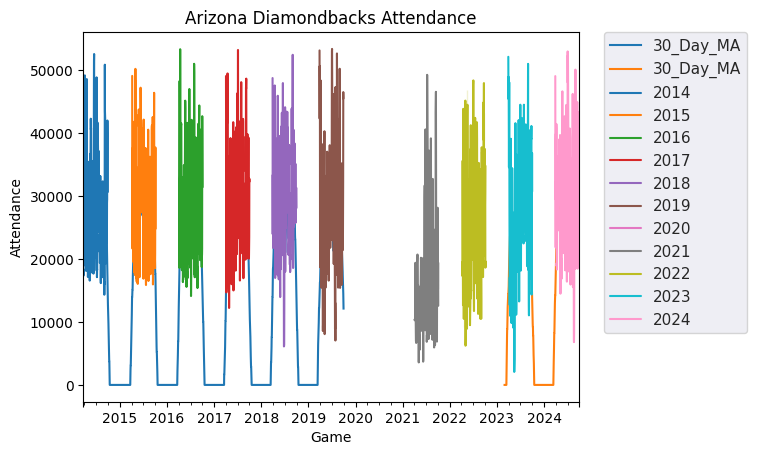

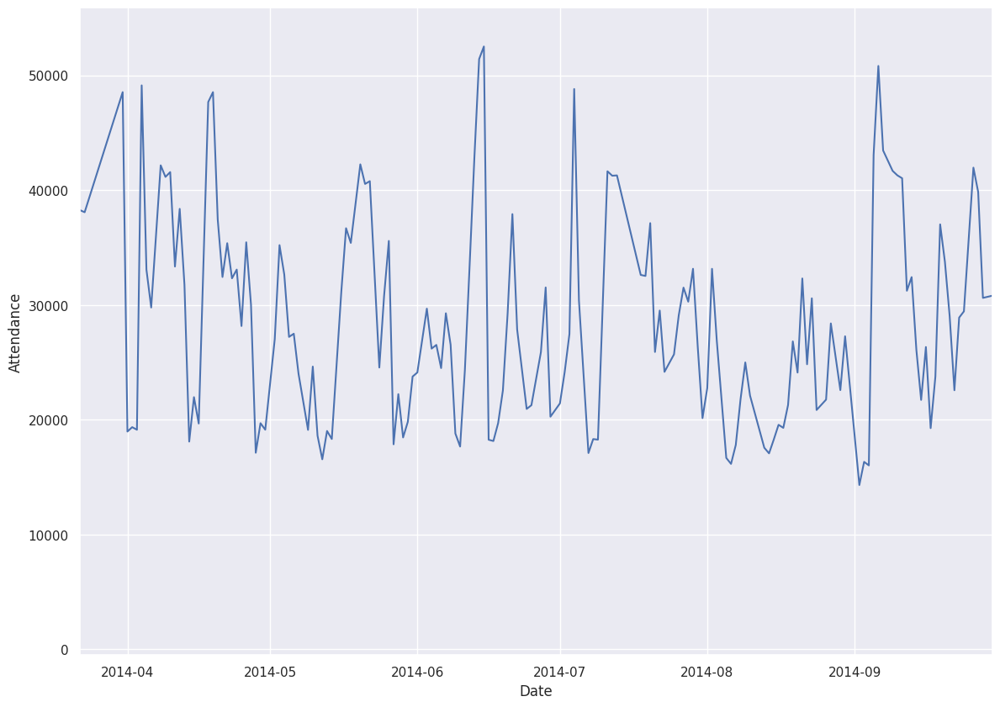

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


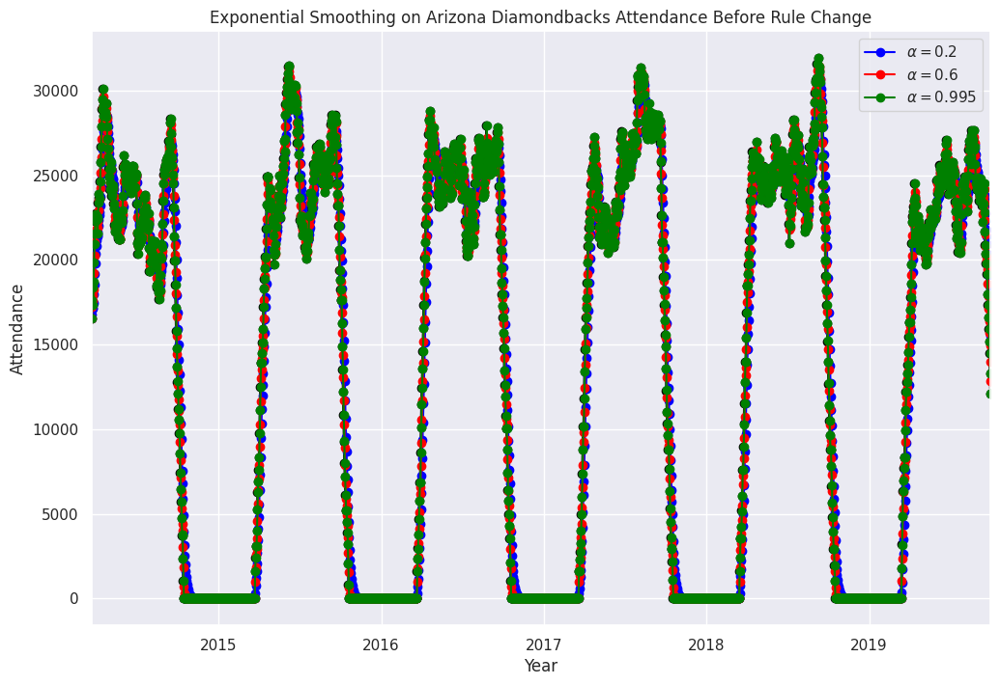

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

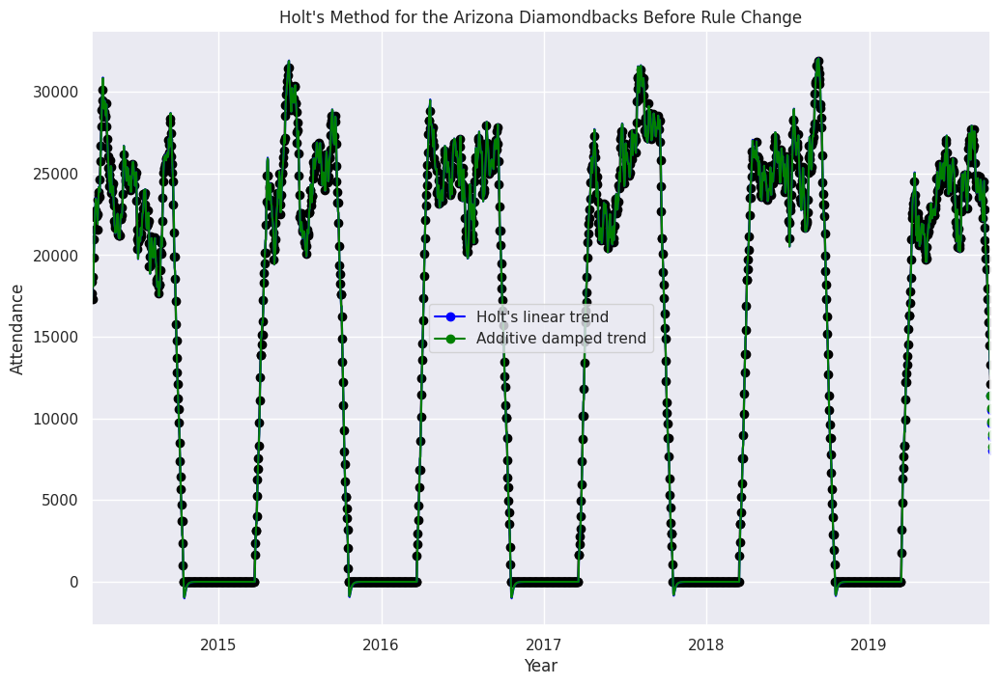

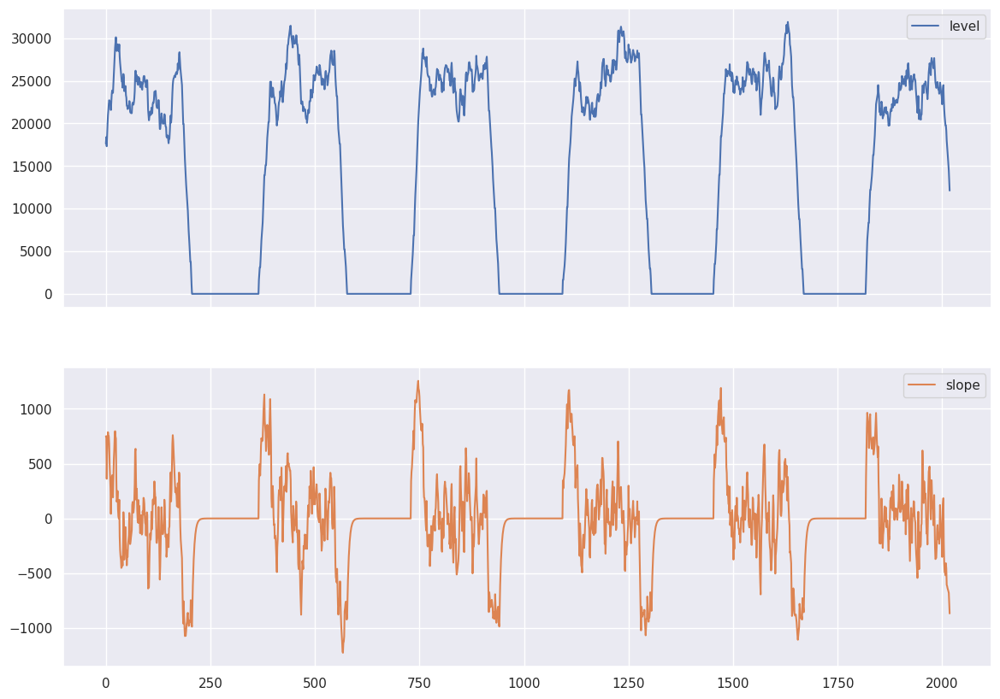

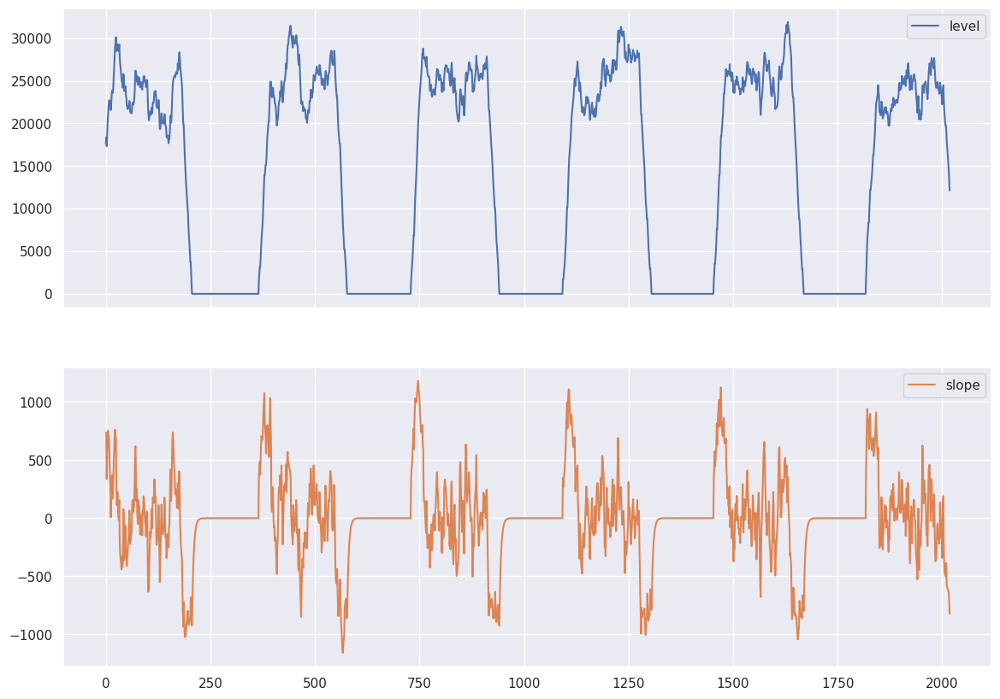

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


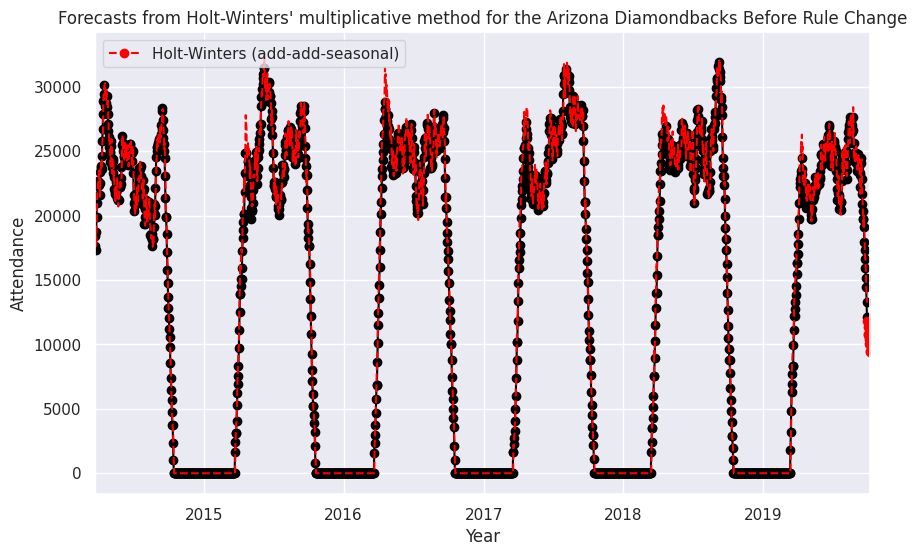

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


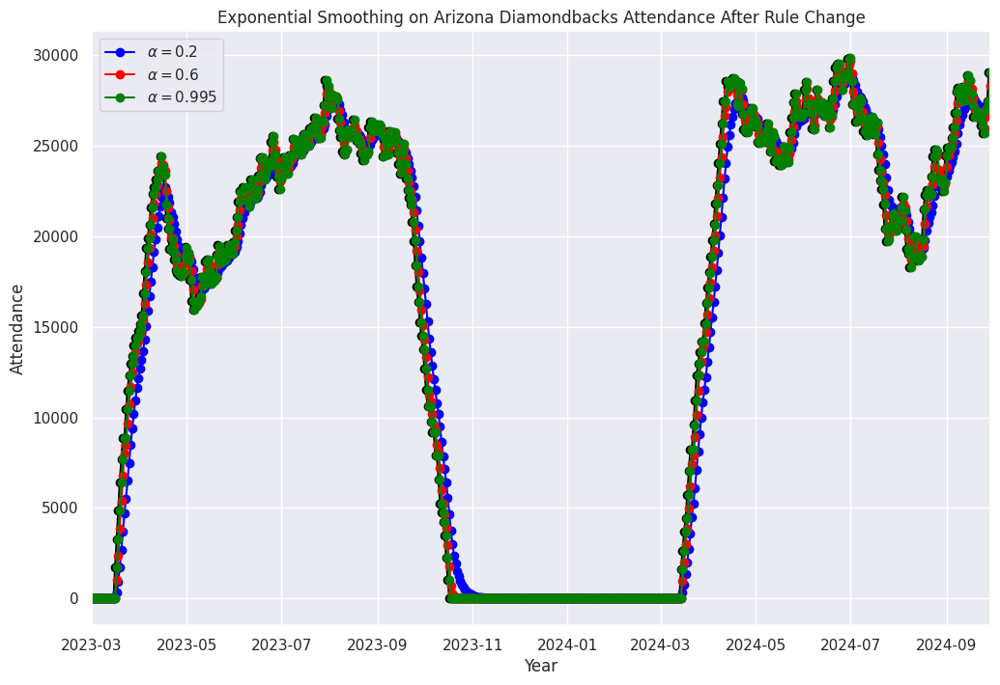

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

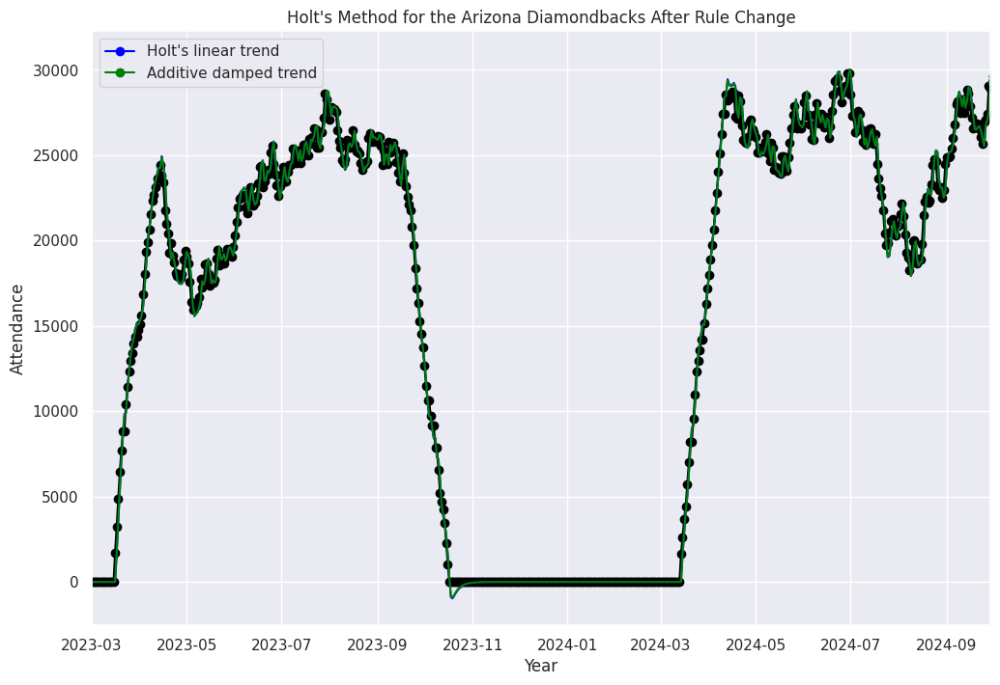

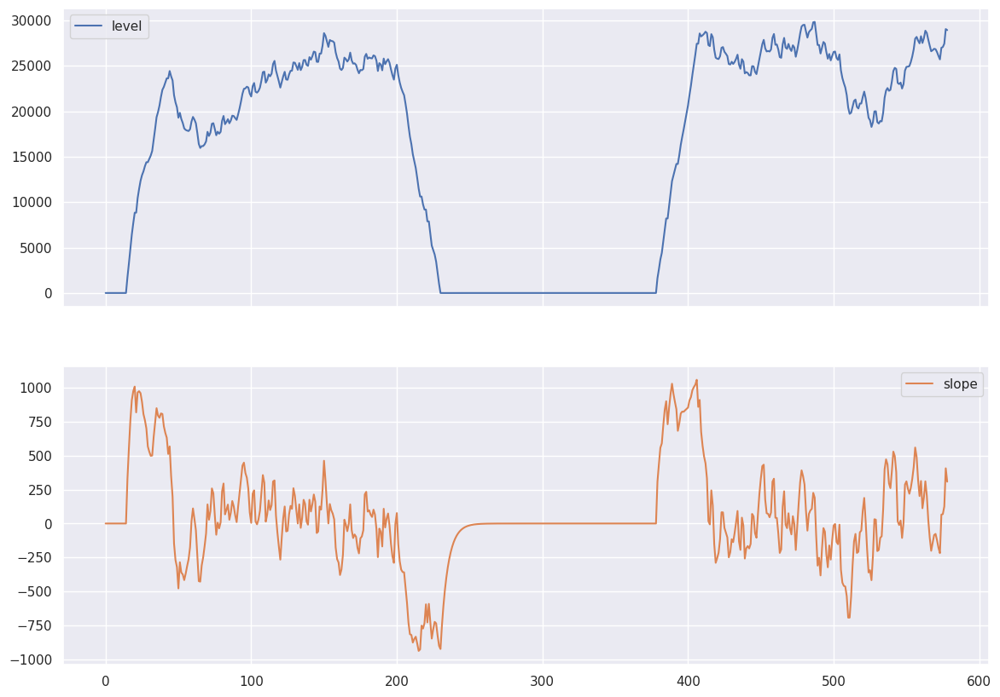

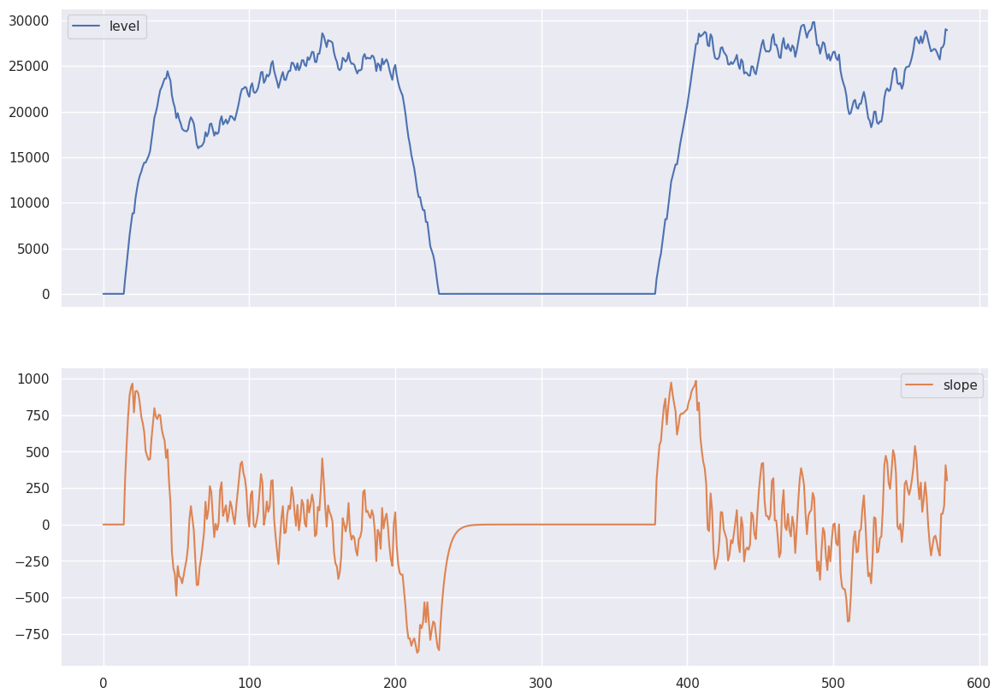

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


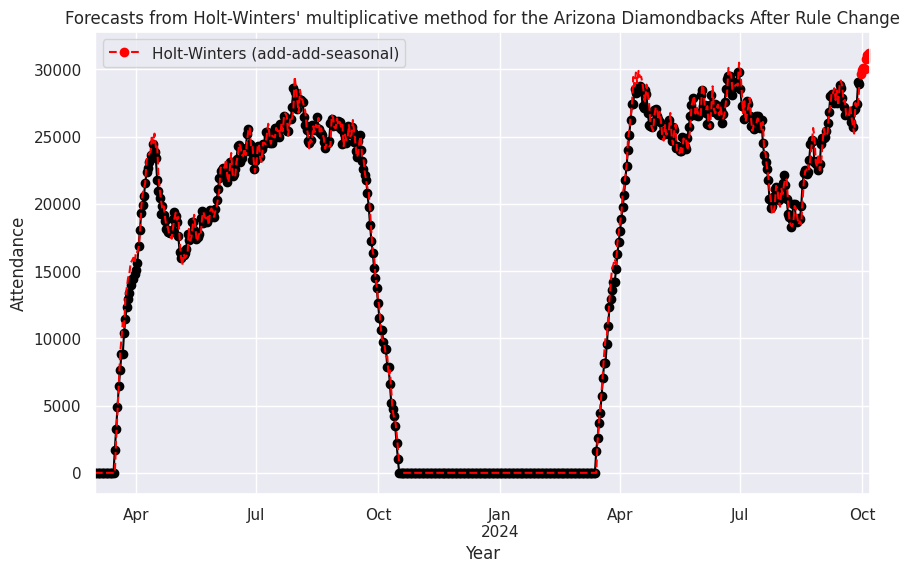

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers                 NaN          NaN
Miami Marlins                  NaN          NaN
Oakland Athletics              NaN          NaN
Seattle Mariners               NaN          NaN
Cincinnati Reds                NaN          NaN
Colorado Rockies               NaN          NaN
Pittsburgh Pirates             NaN          NaN
San Diego Padres               NaN          NaN
New York Mets                  NaN          NaN
New York Yankees               NaN          NaN
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
15939.479506606007
16068.702564102563
14364.79411764706
17496.724021241225
Average Change in Yearly Attendance before ru

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


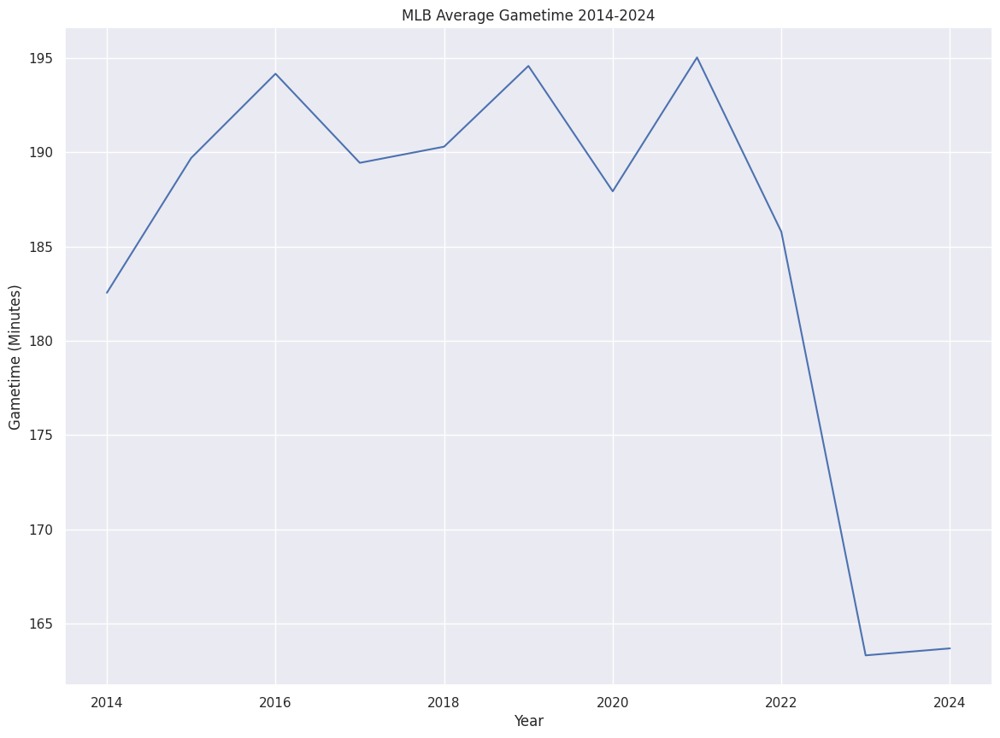

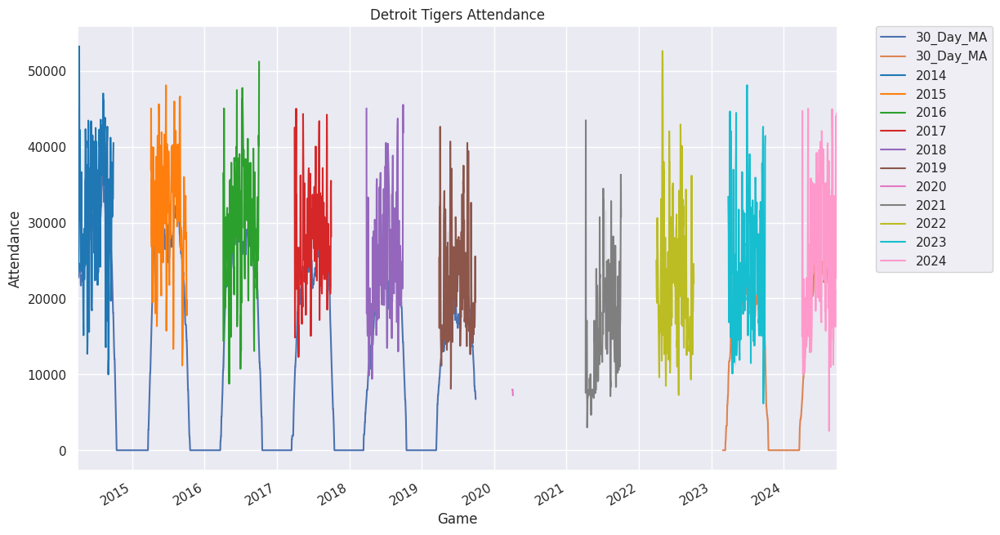

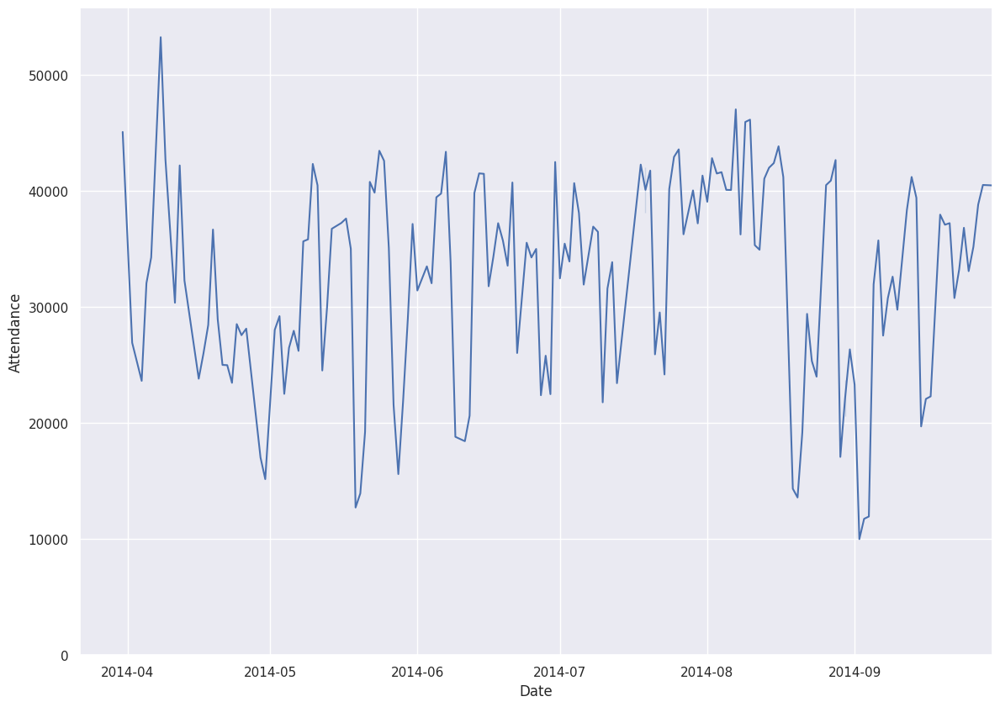

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


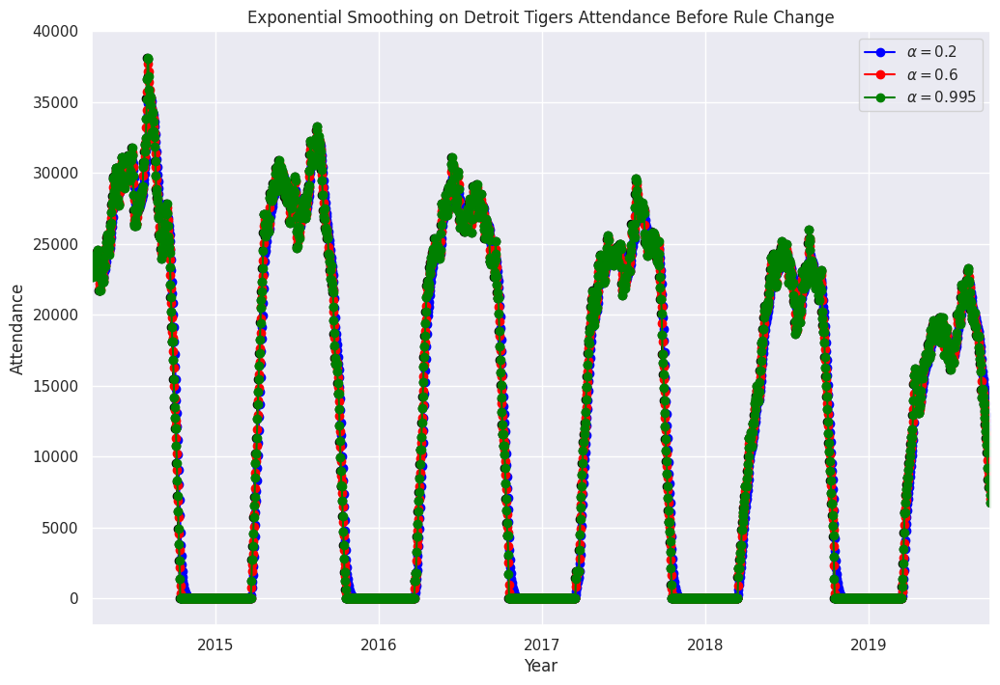

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

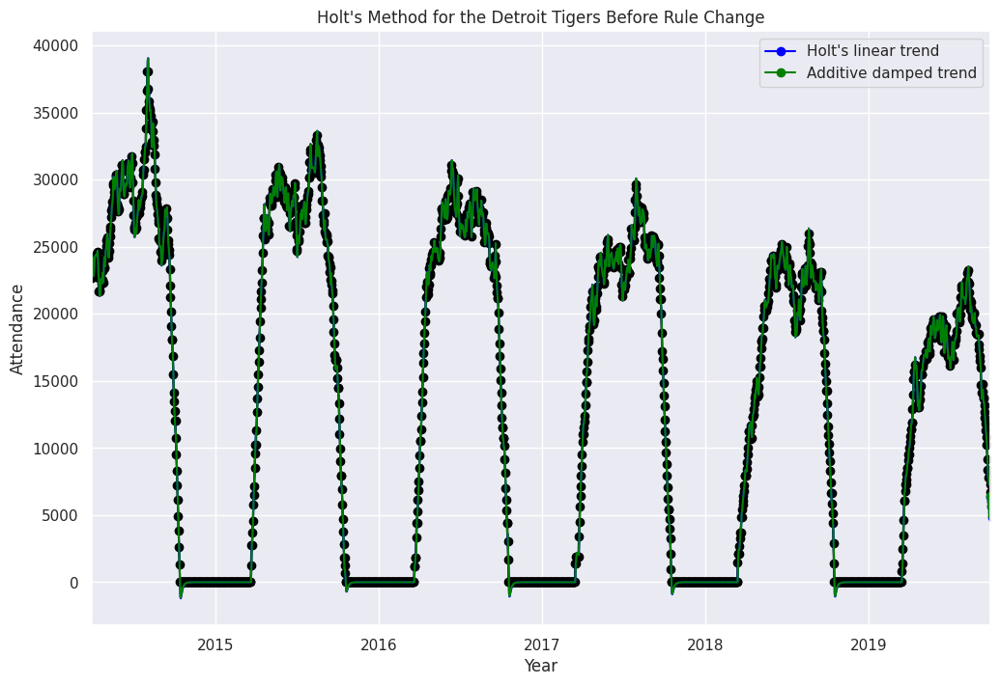

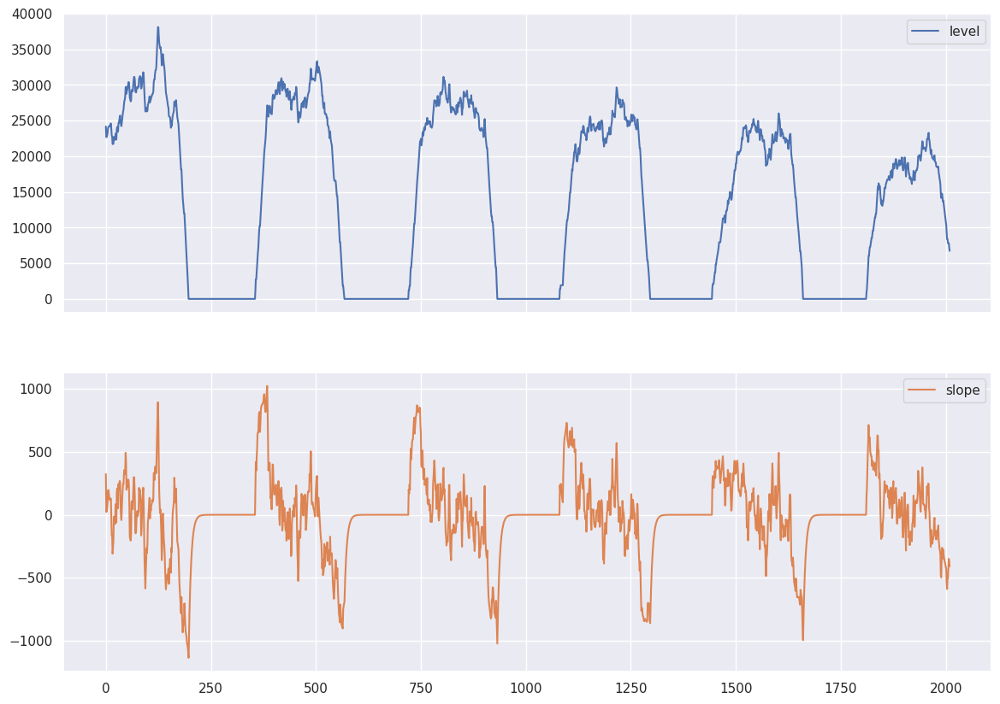

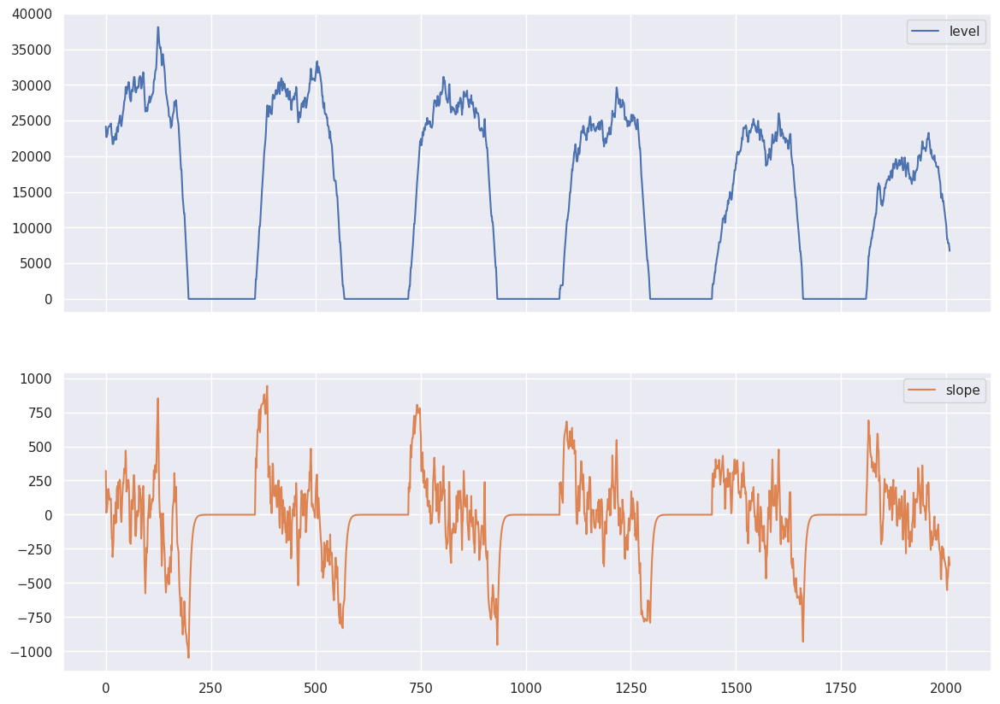

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


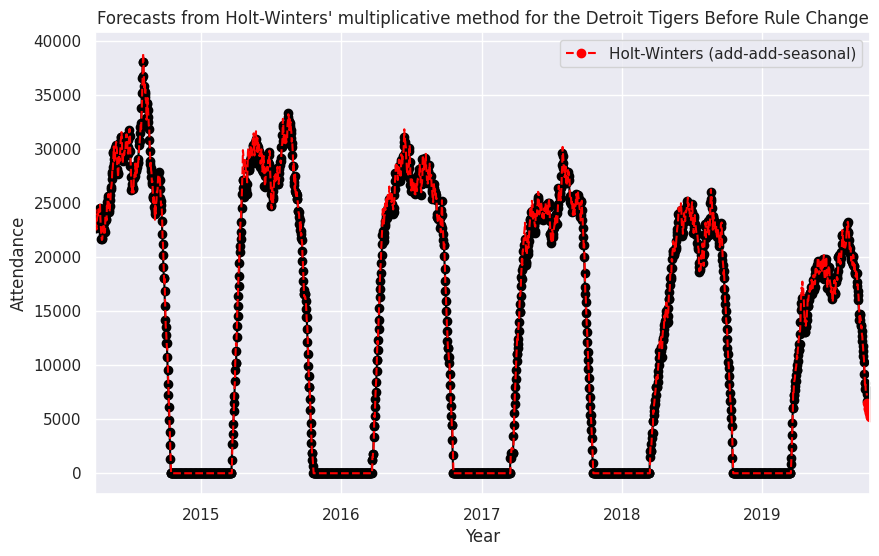

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


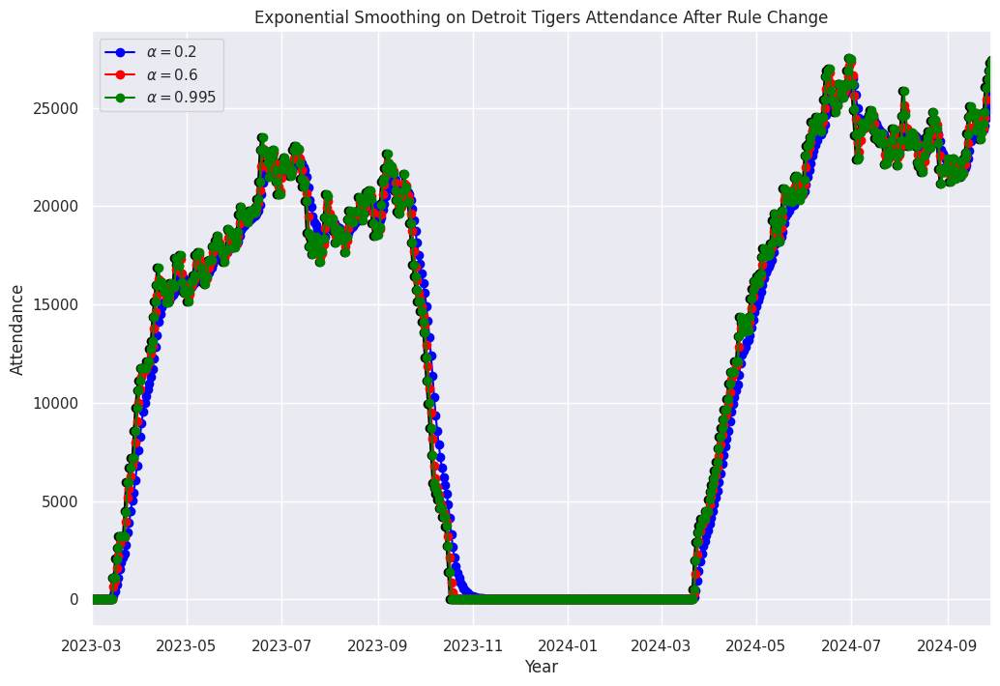

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

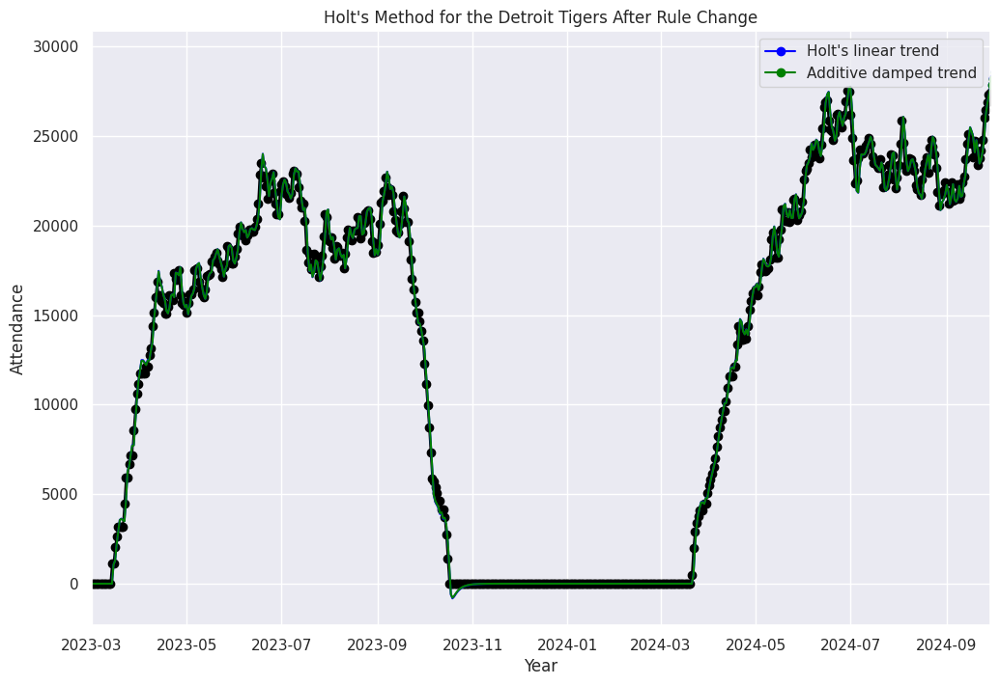

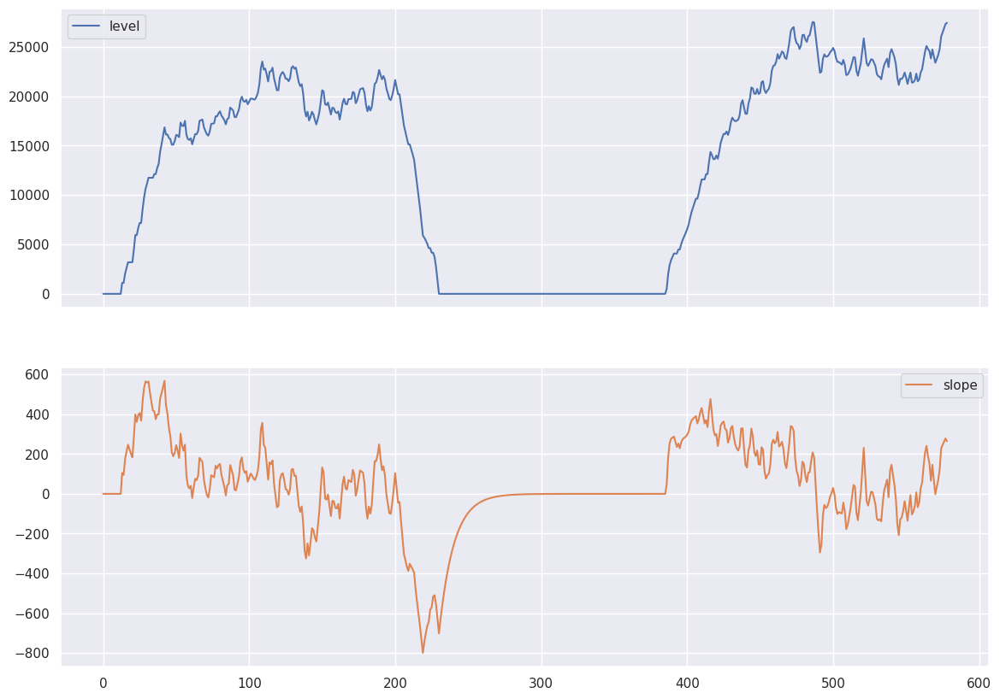

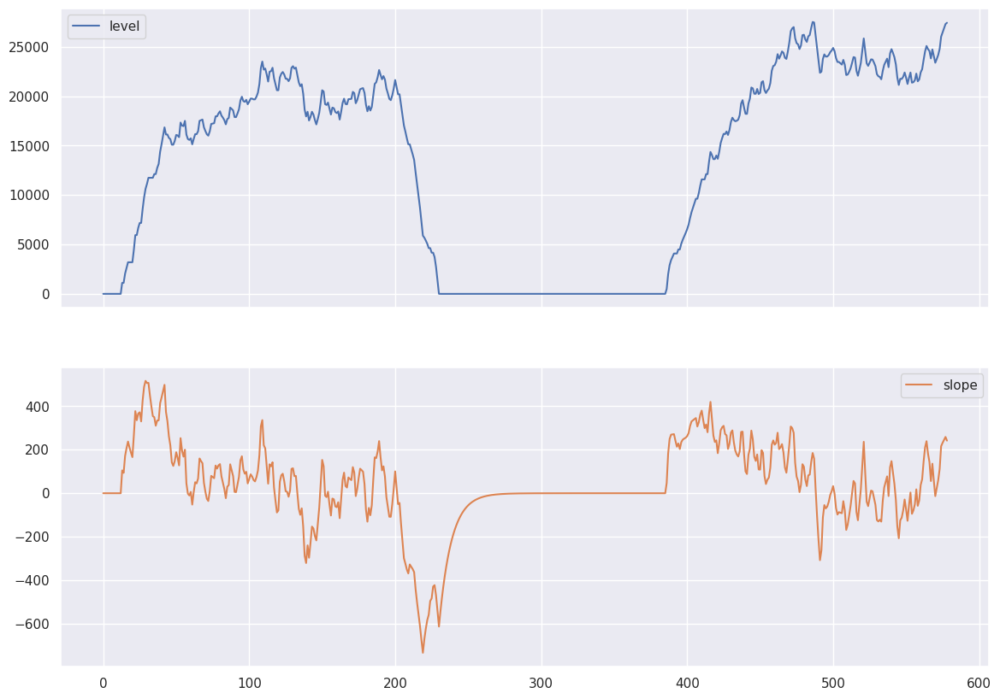

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


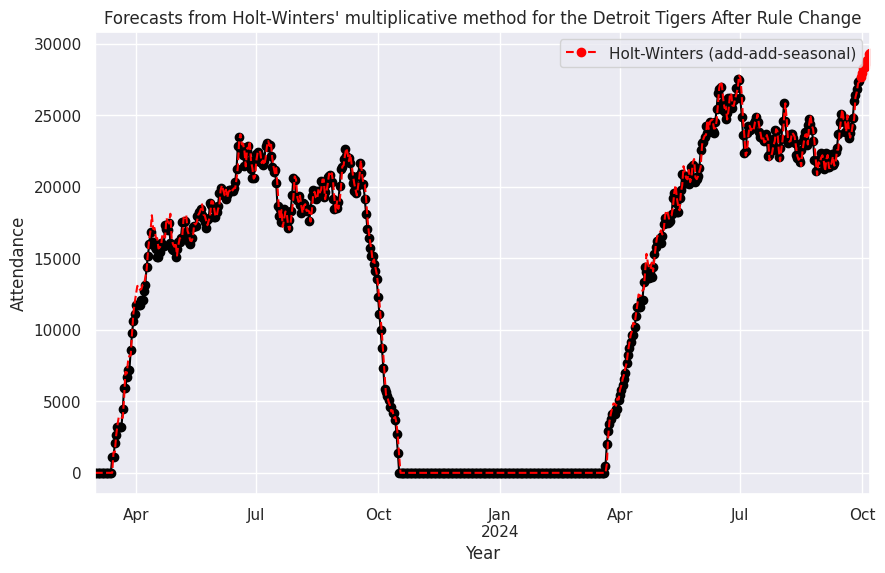

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins                  NaN          NaN
Oakland Athletics              NaN          NaN
Seattle Mariners               NaN          NaN
Cincinnati Reds                NaN          NaN
Colorado Rockies               NaN          NaN
Pittsburgh Pirates             NaN          NaN
San Diego Padres               NaN          NaN
New York Mets                  NaN          NaN
New York Yankees               NaN          NaN
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
18732.275901160046
11809.784004884004
11791.379084967322
14160.152022179902
Average Change in Yearly Attendance before r

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


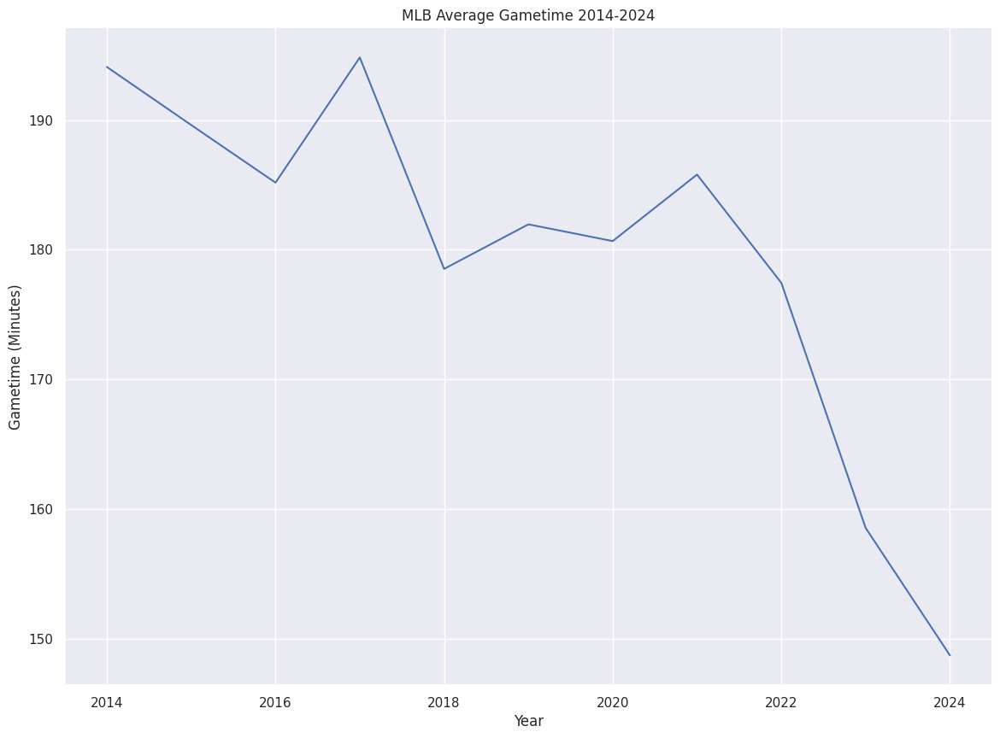

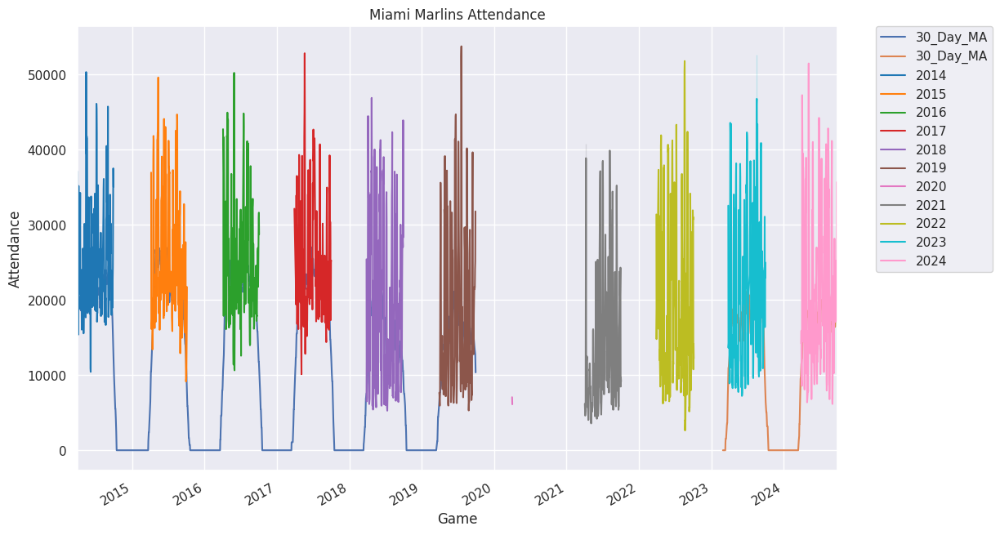

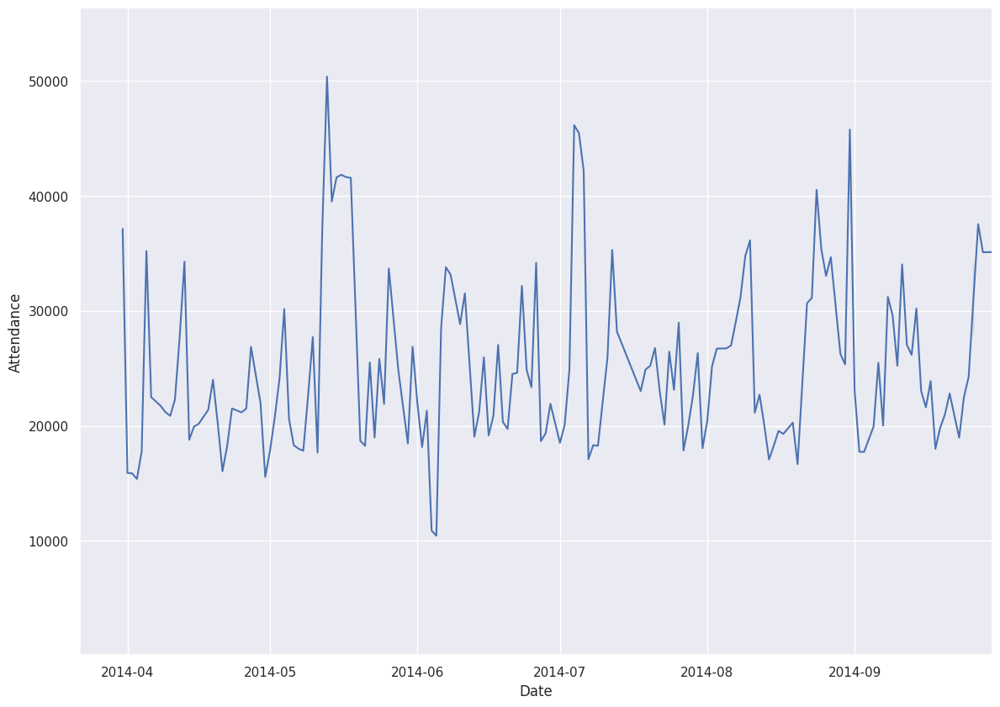

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


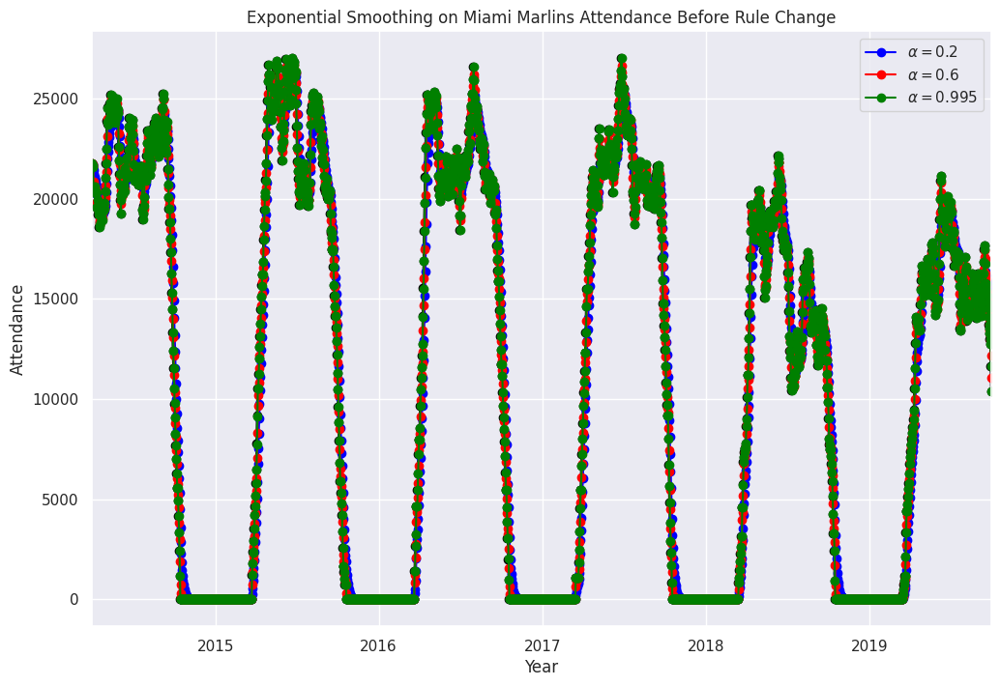

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

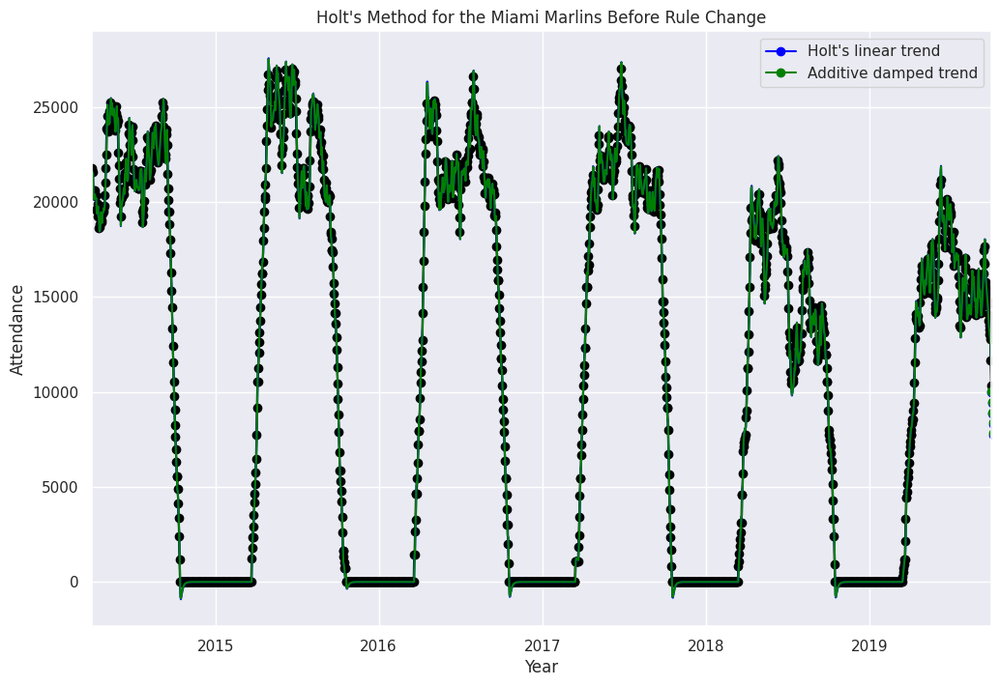

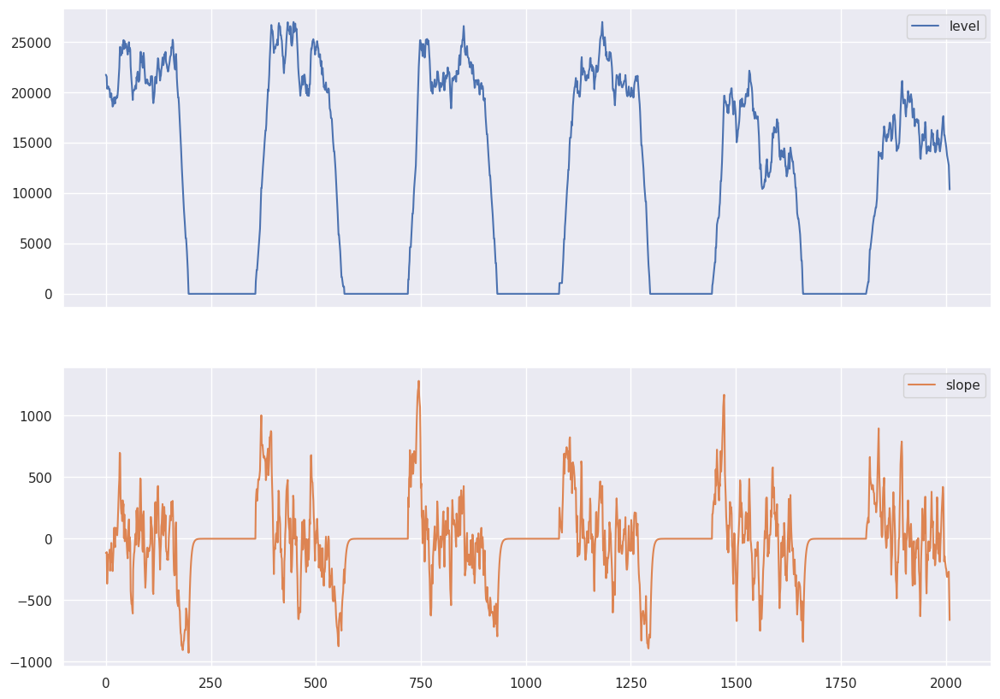

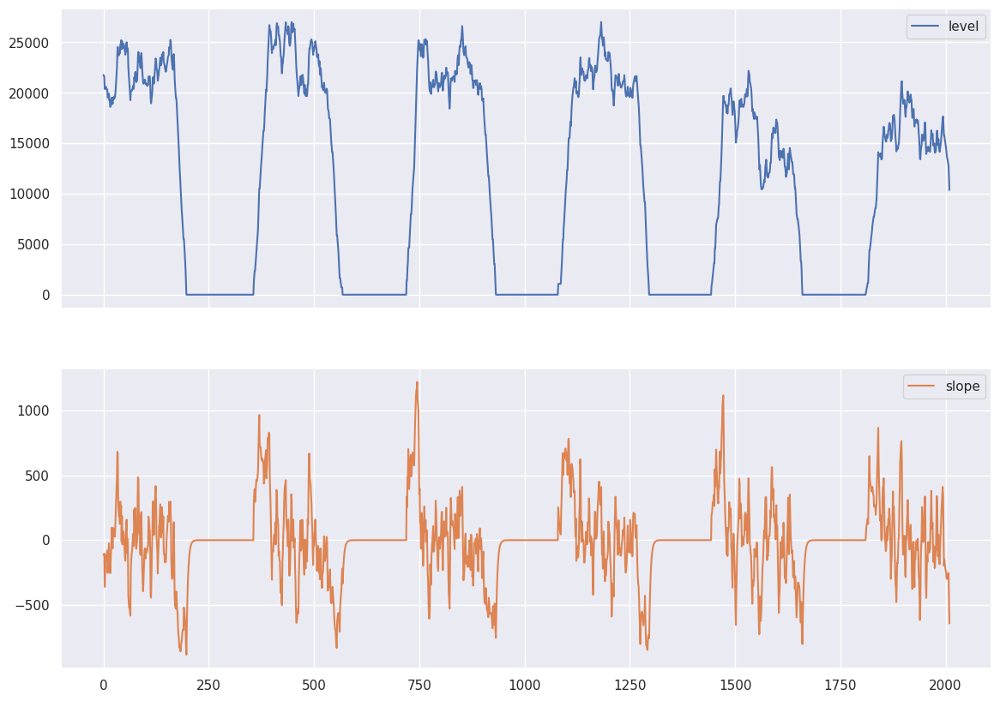

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


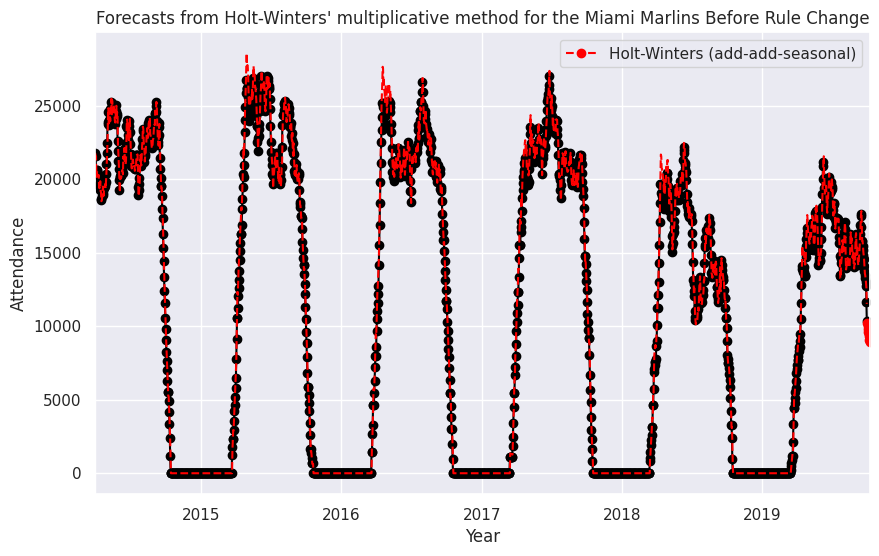

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


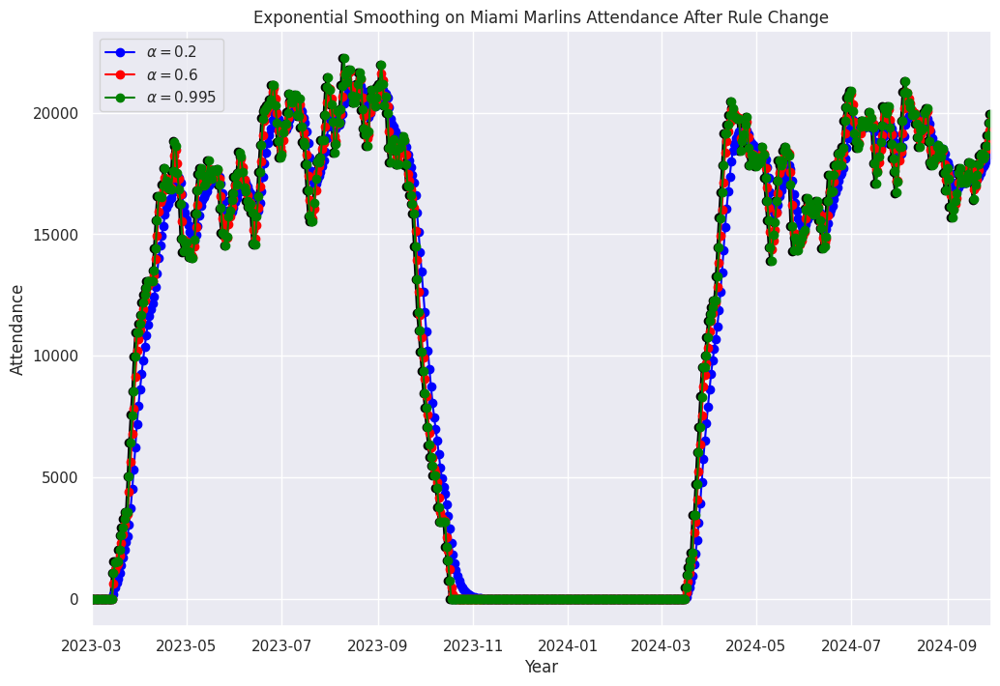

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

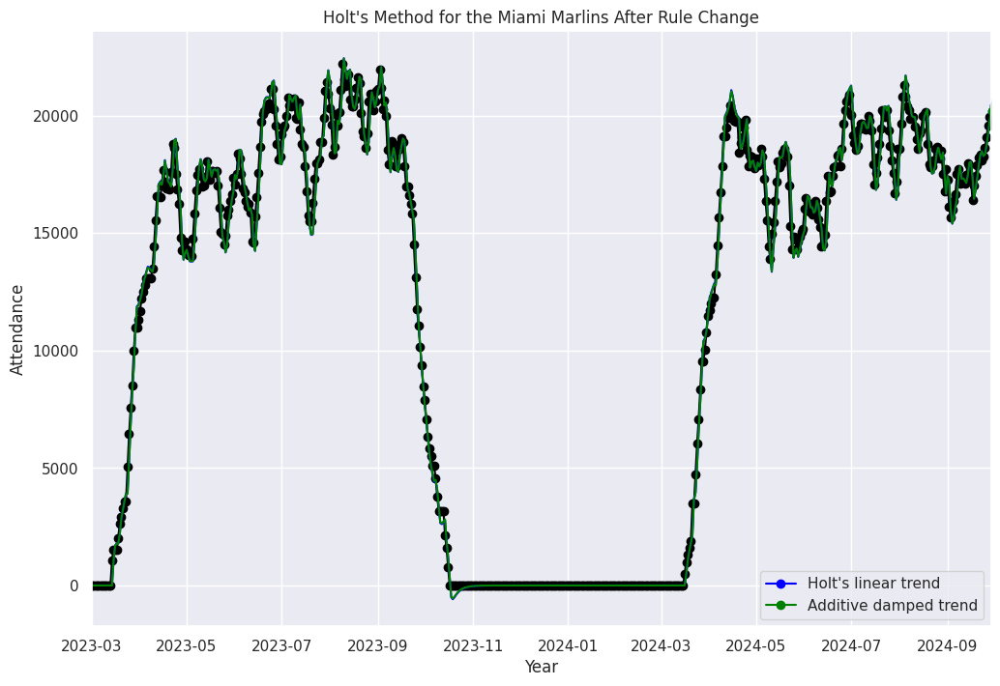

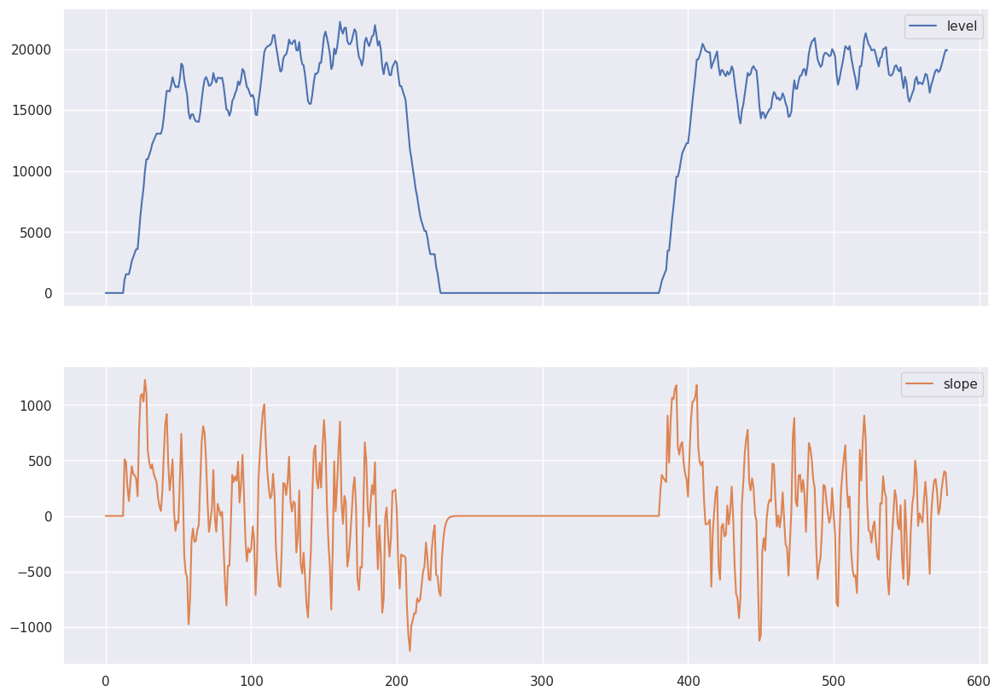

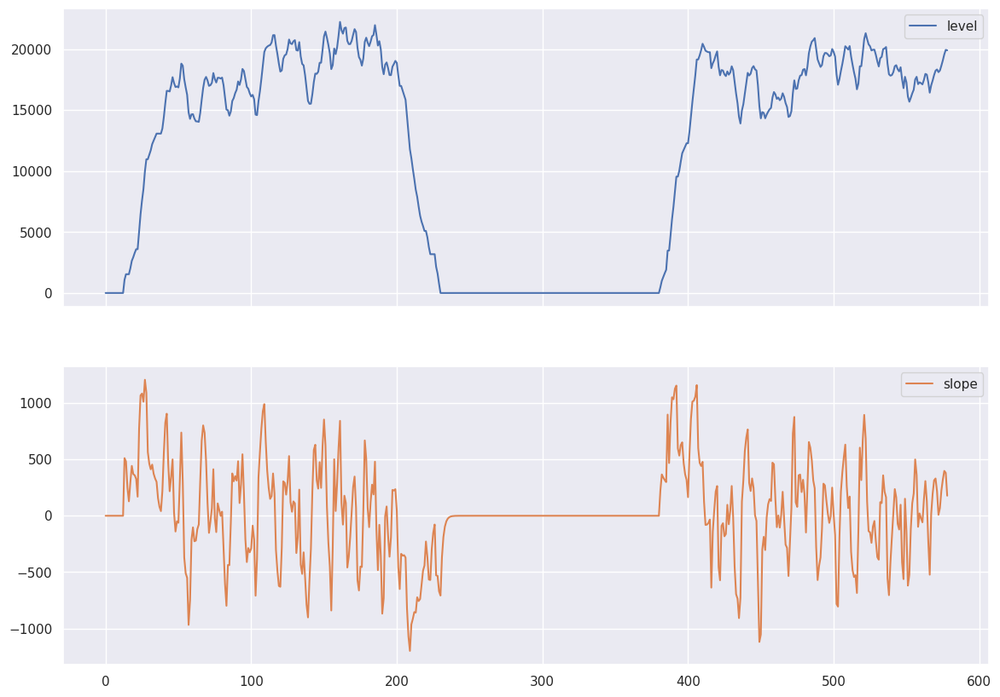

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


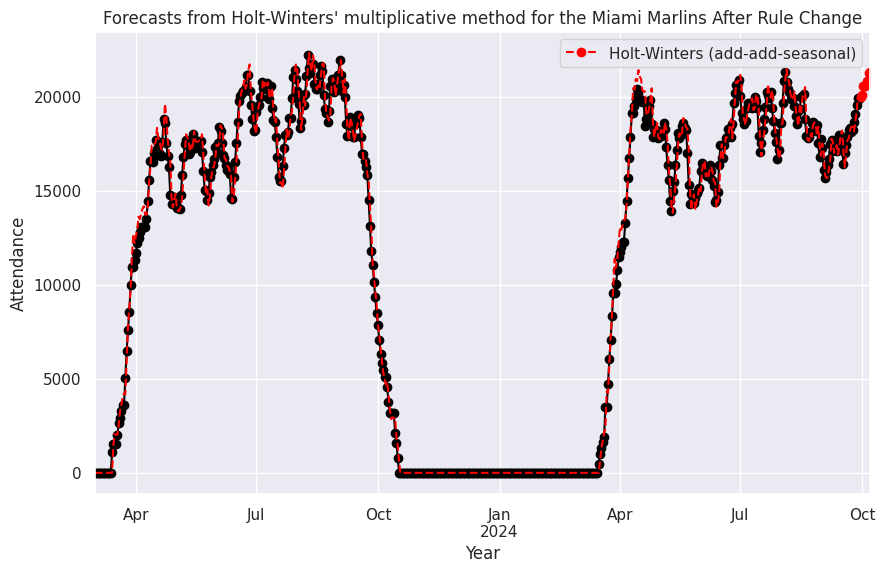

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics              NaN          NaN
Seattle Mariners               NaN          NaN
Cincinnati Reds                NaN          NaN
Colorado Rockies               NaN          NaN
Pittsburgh Pirates             NaN          NaN
San Diego Padres               NaN          NaN
New York Mets                  NaN          NaN
New York Yankees               NaN          NaN
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
14663.05876680992
10615.852625152625
11123.254901960785
12221.806586638922
Average Change in Yearly Attendance before ru

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


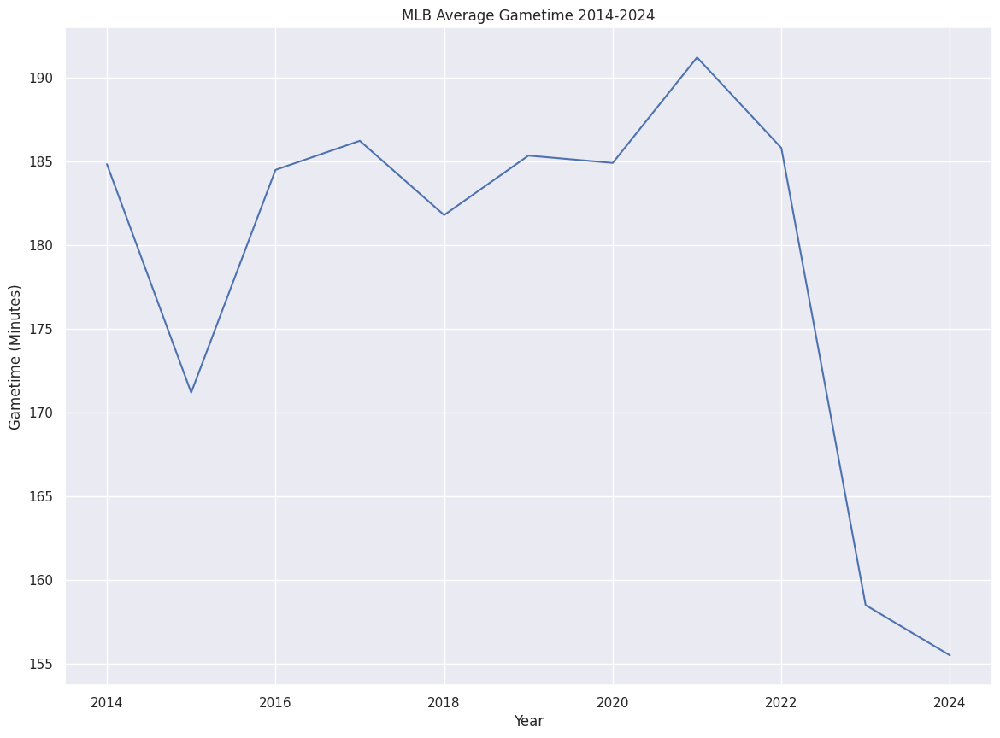

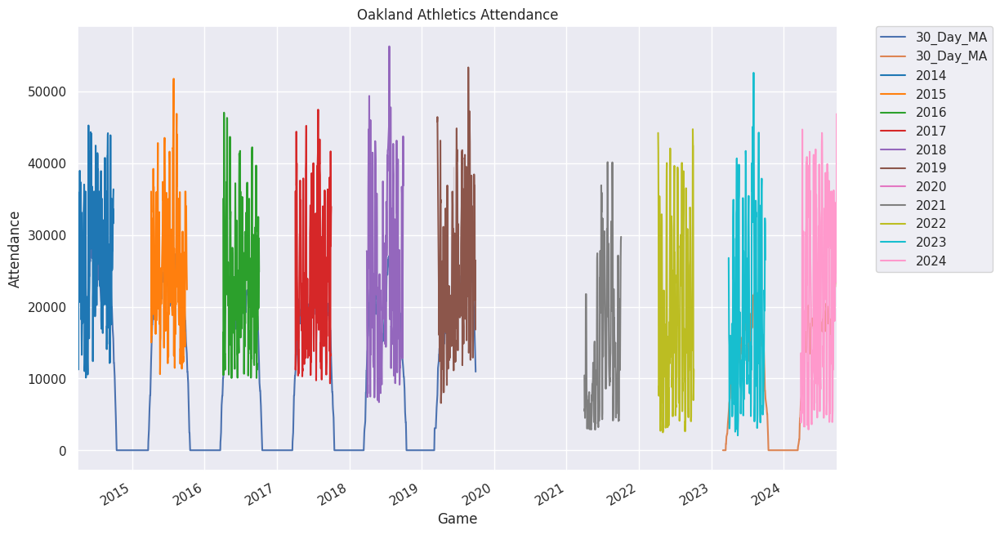

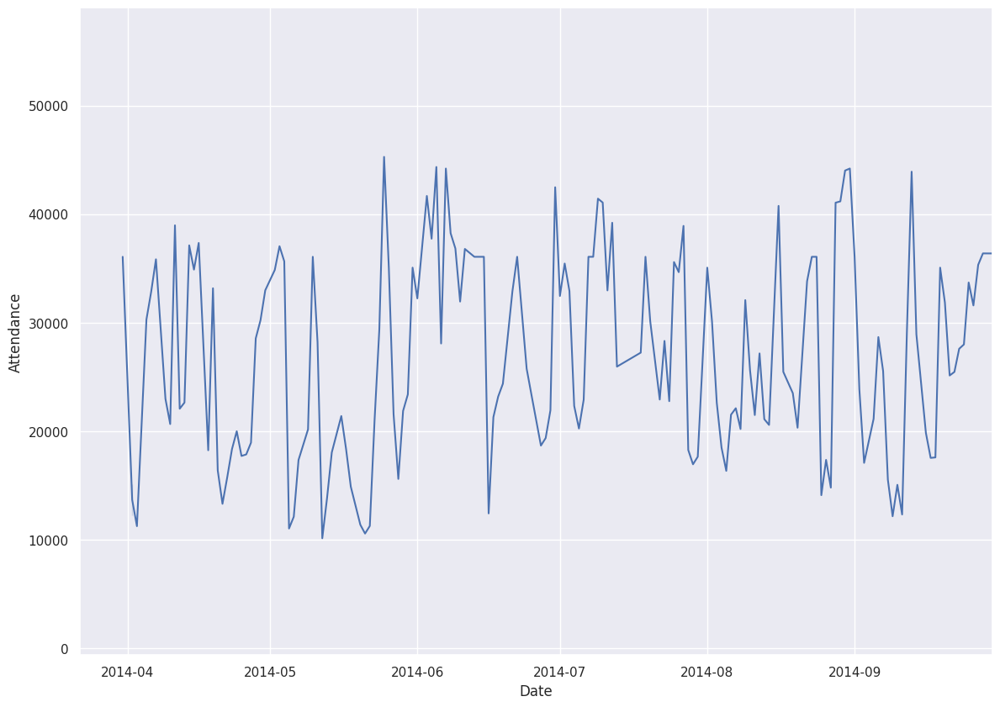

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


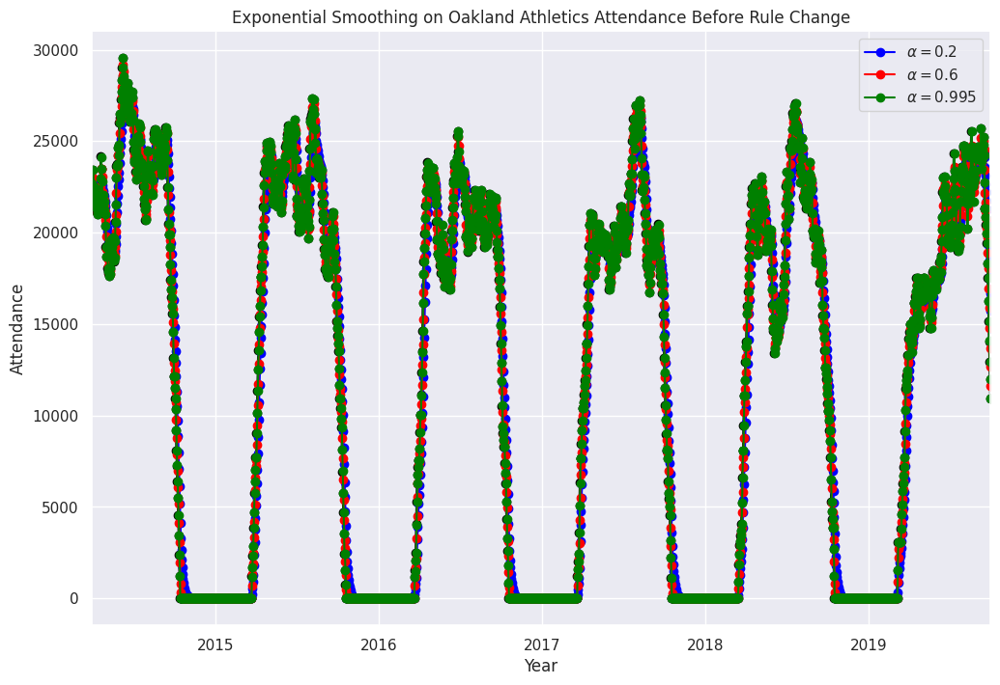

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

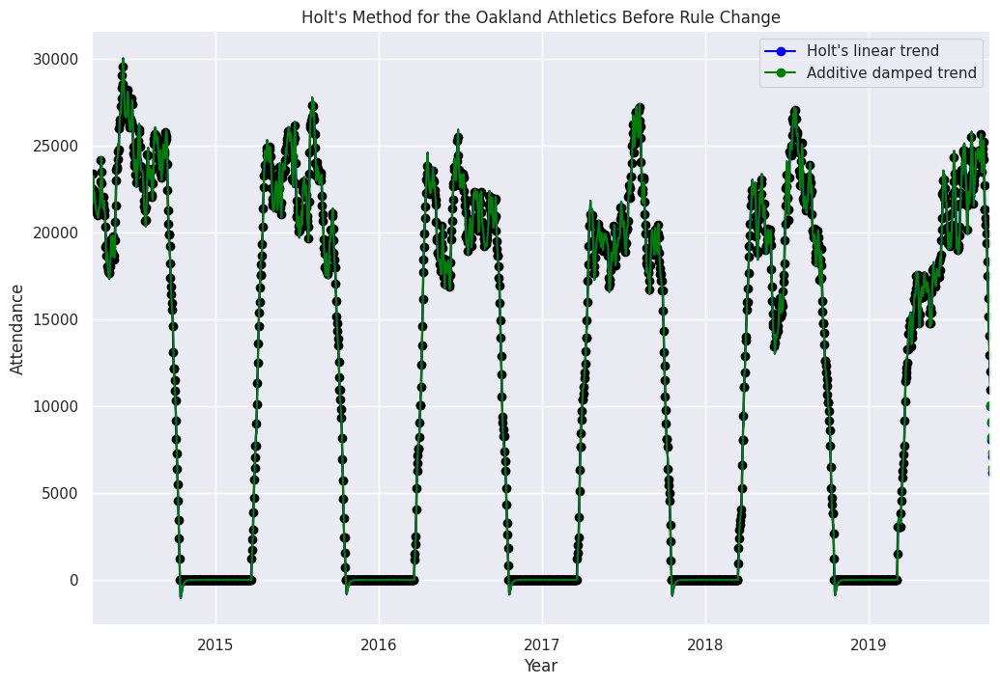

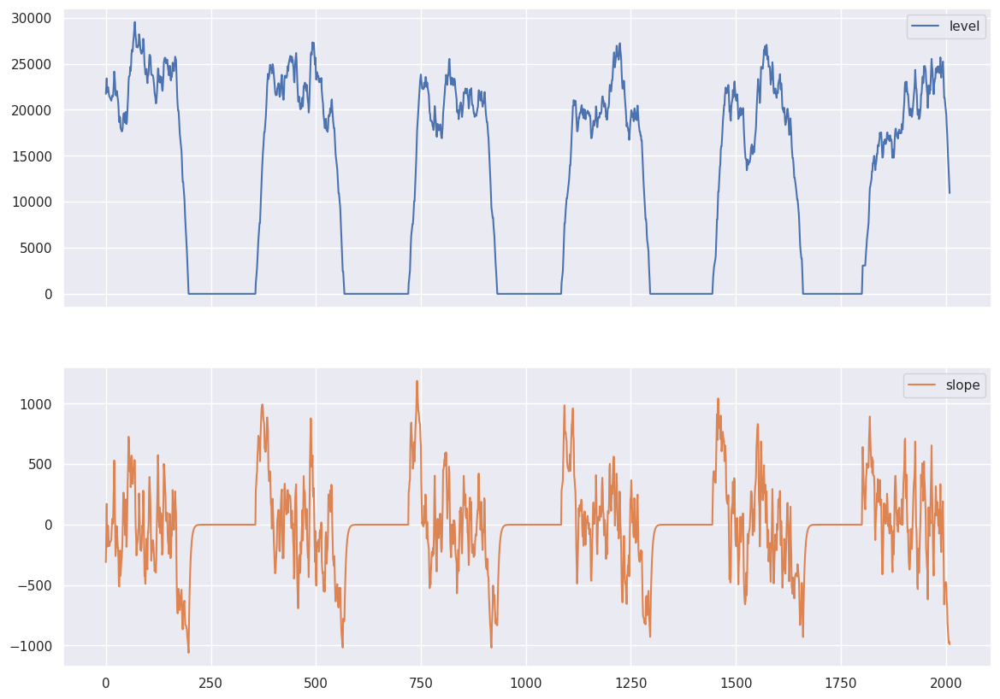

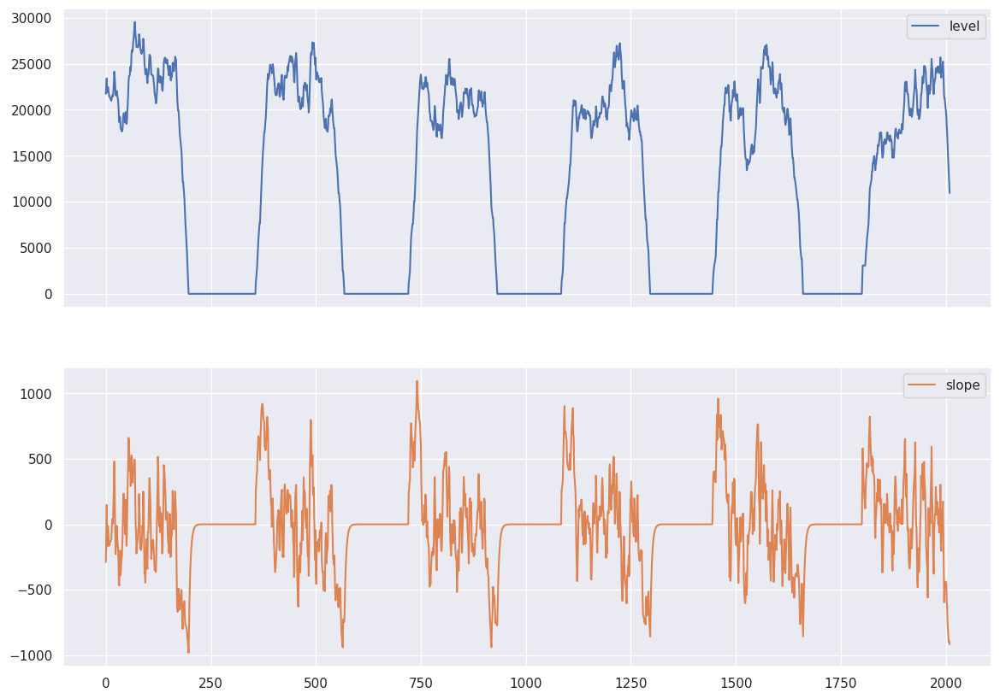

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


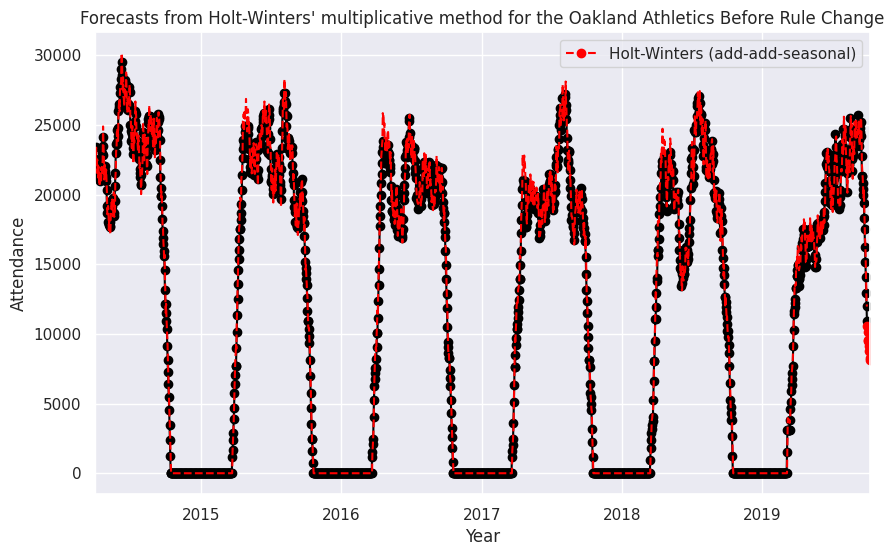

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


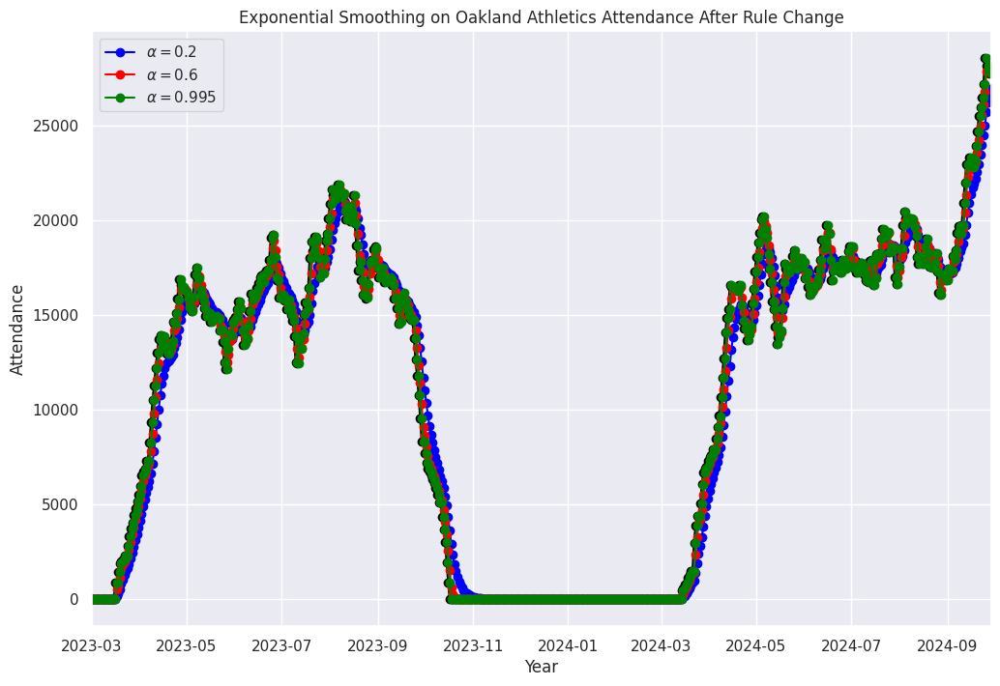

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

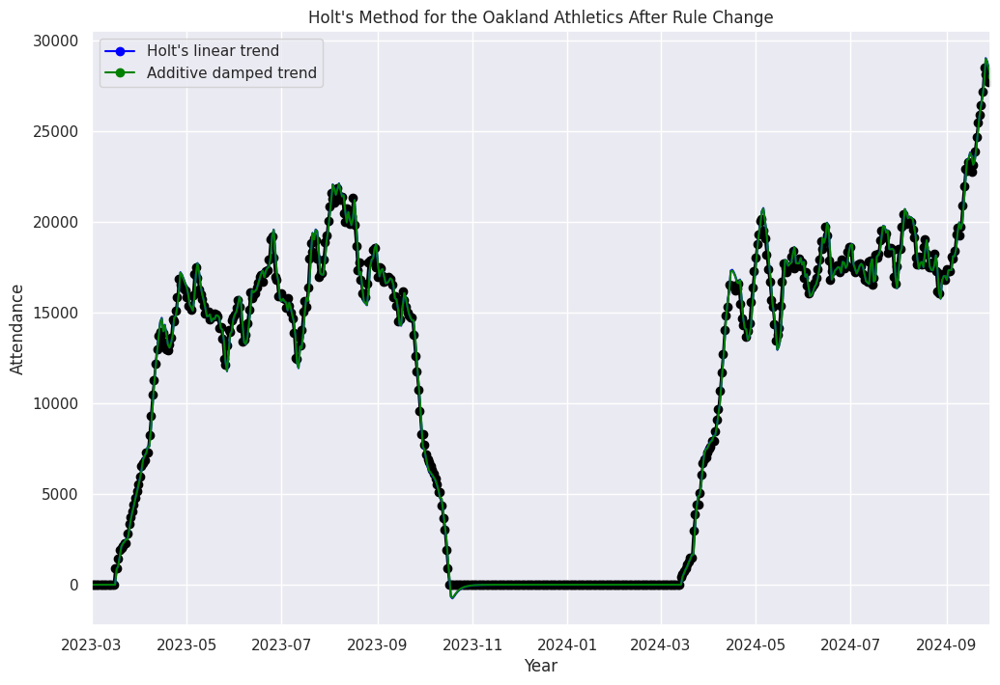

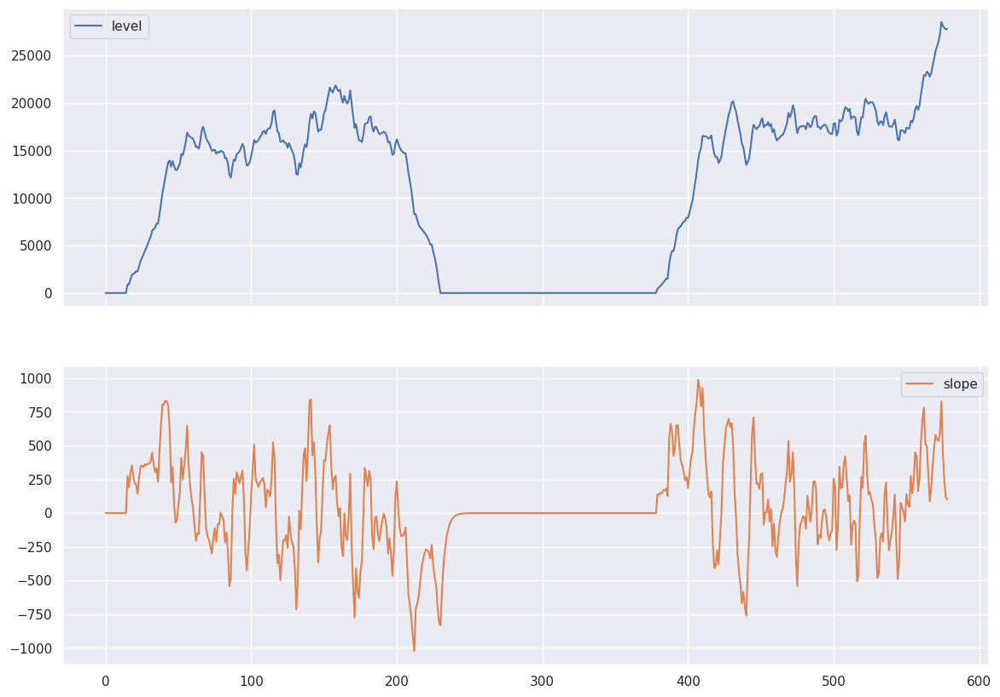

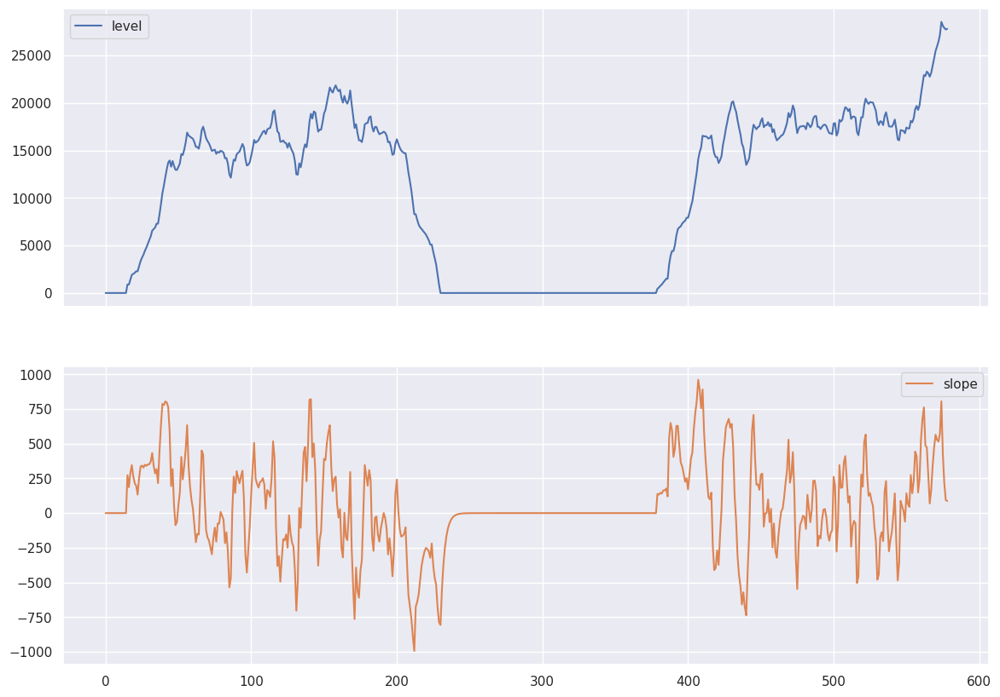

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


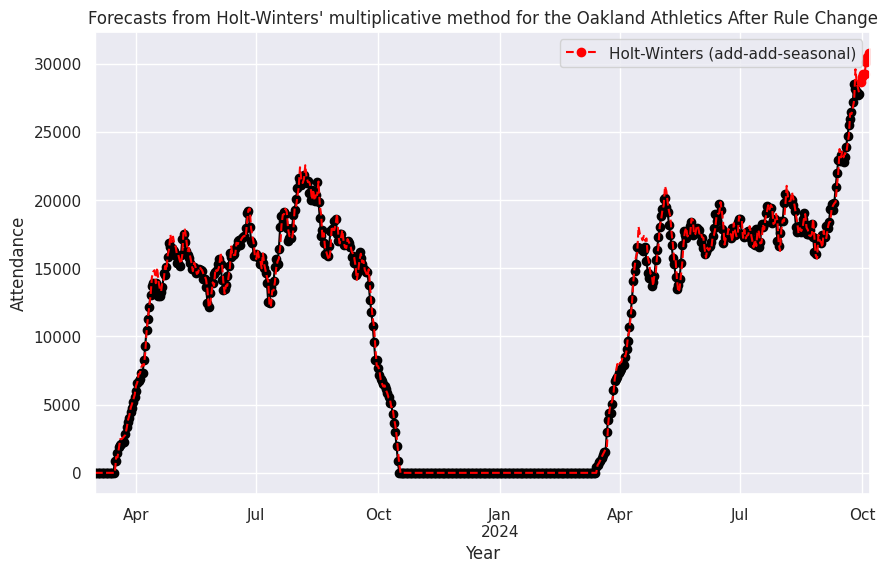

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners               NaN          NaN
Cincinnati Reds                NaN          NaN
Colorado Rockies               NaN          NaN
Pittsburgh Pirates             NaN          NaN
San Diego Padres               NaN          NaN
New York Mets                  NaN          NaN
New York Yankees               NaN          NaN
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
15673.366807643351
13867.986813186815
9791.209150326797
12127.961846254595
Average Change in Yearly Attendance before ru

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


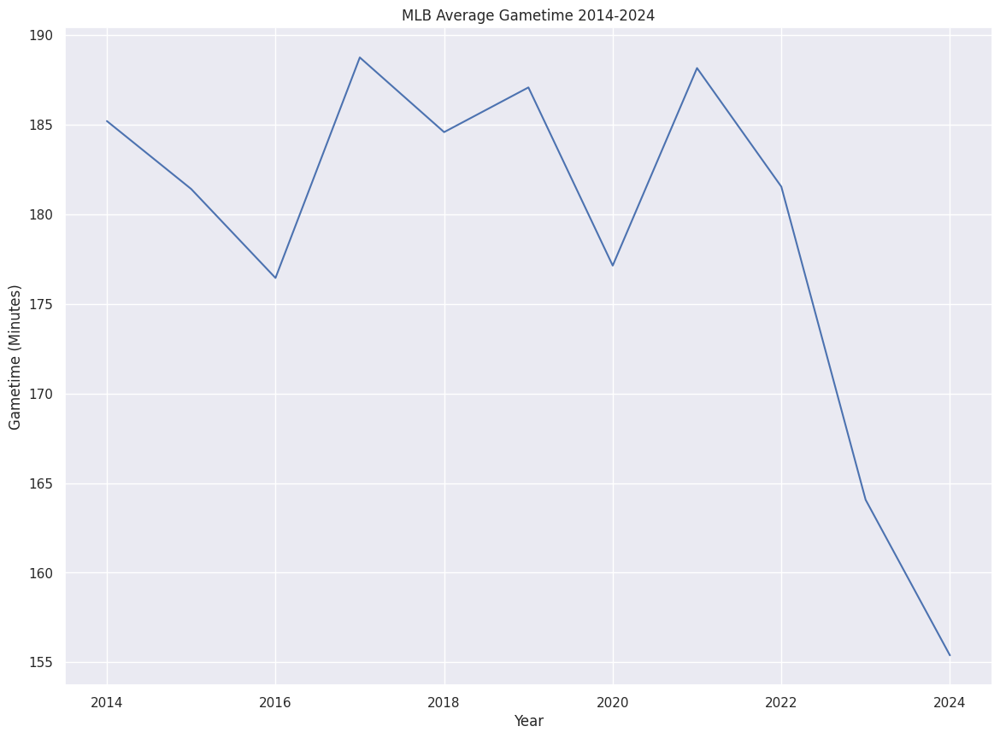

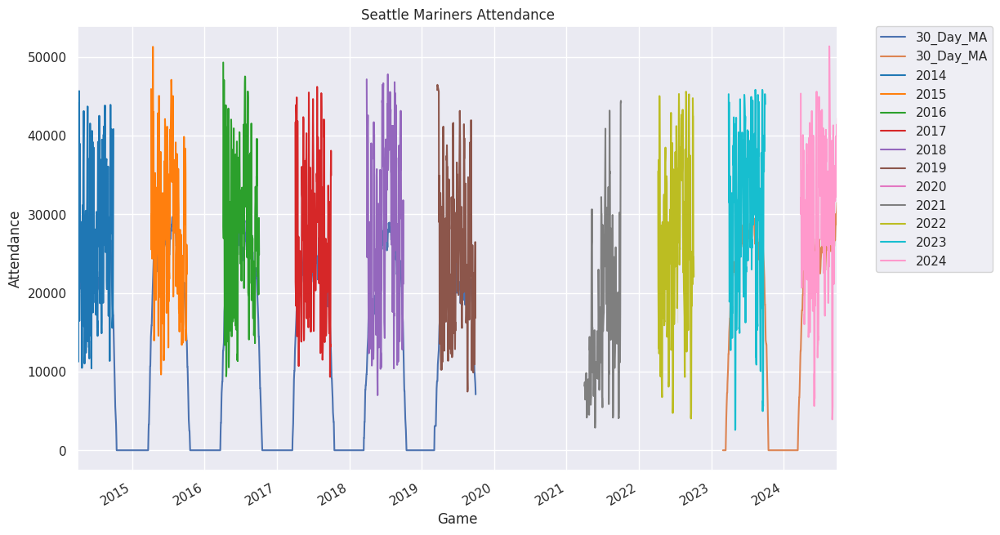

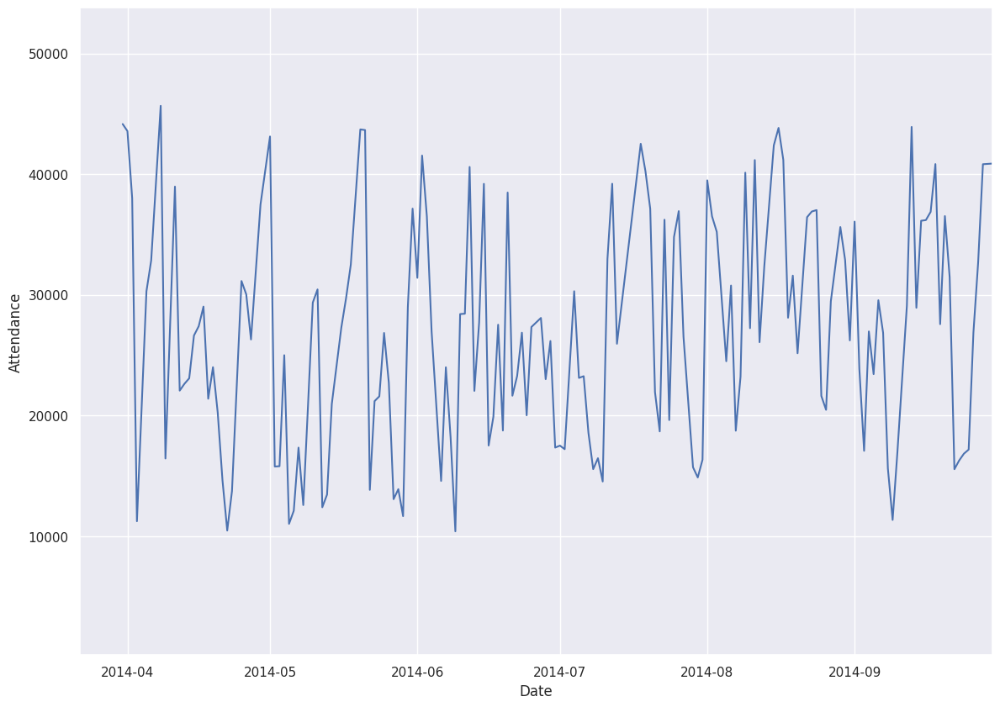

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


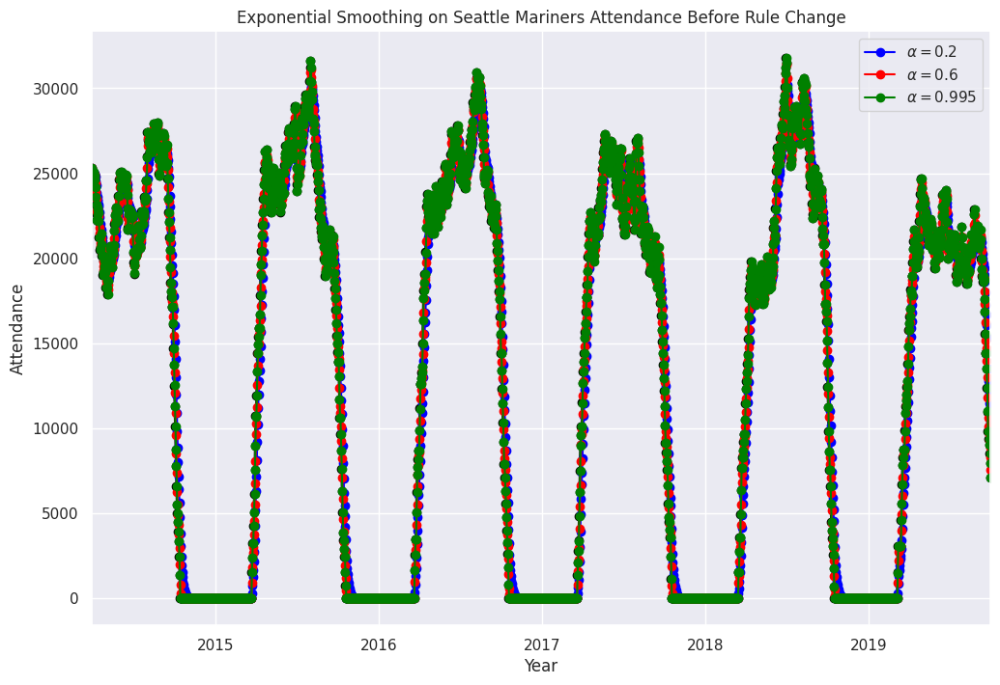

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

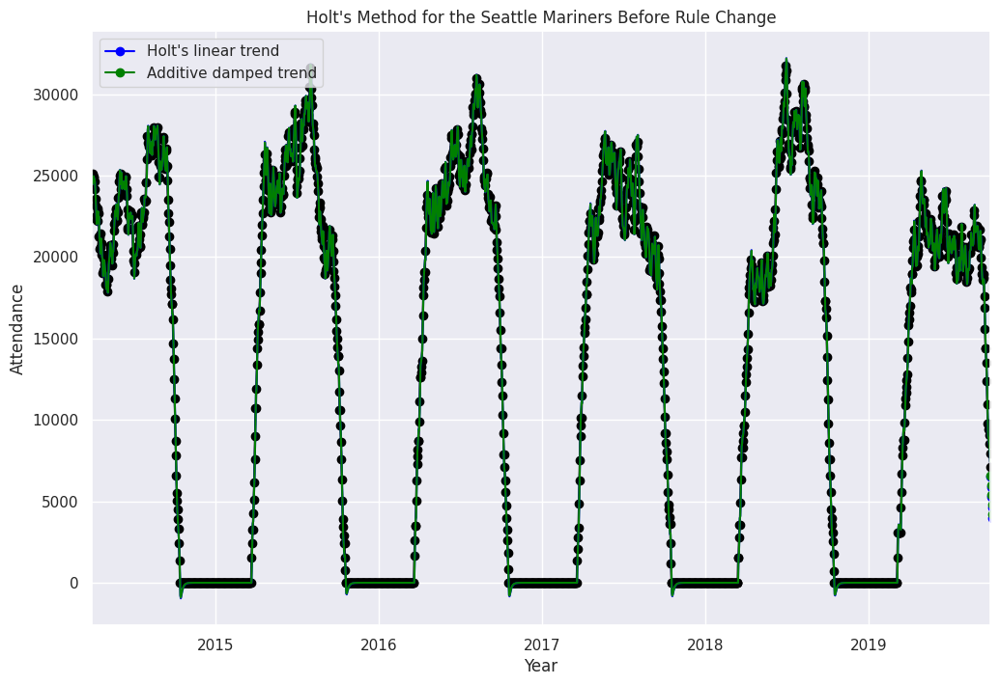

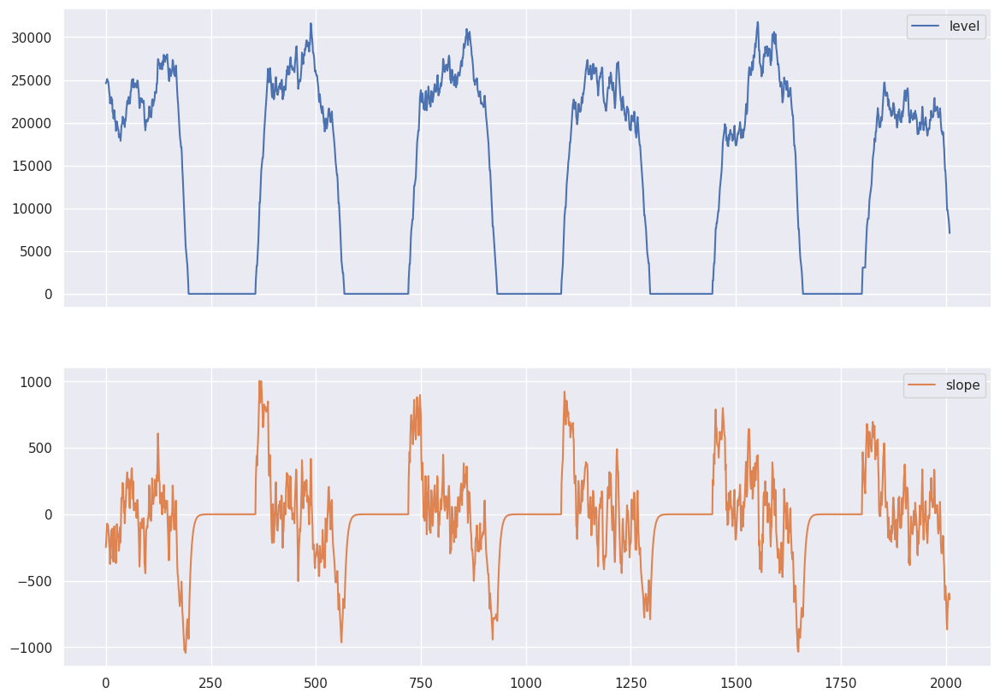

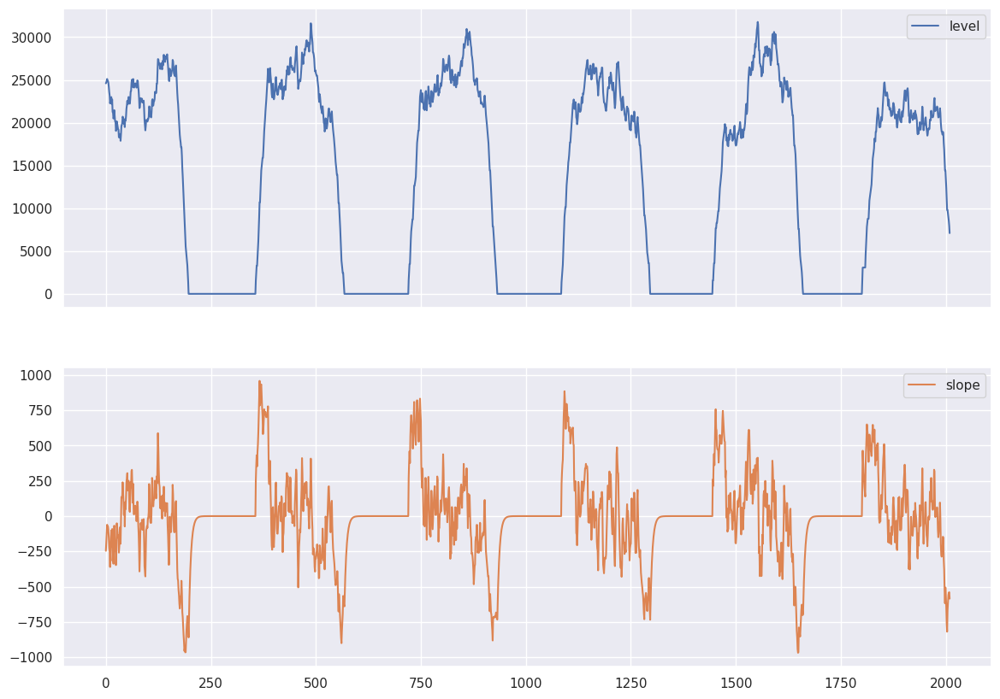

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


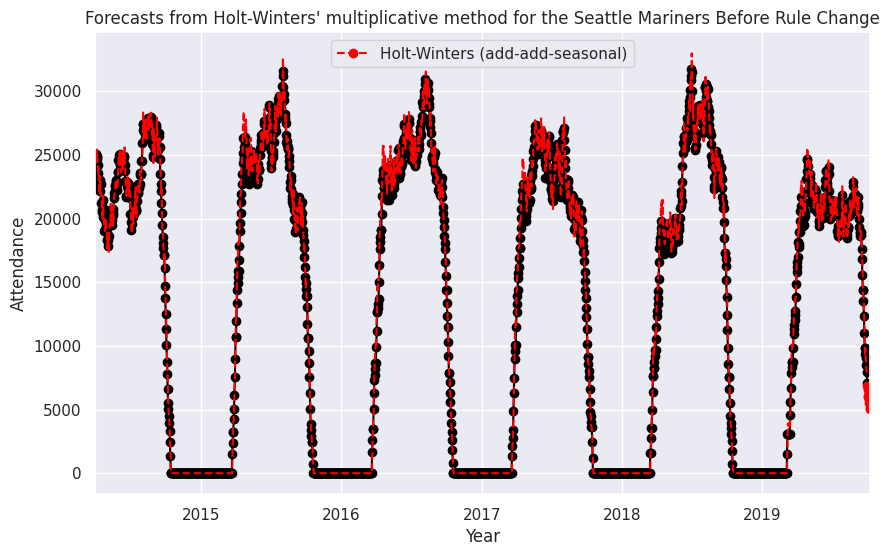

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


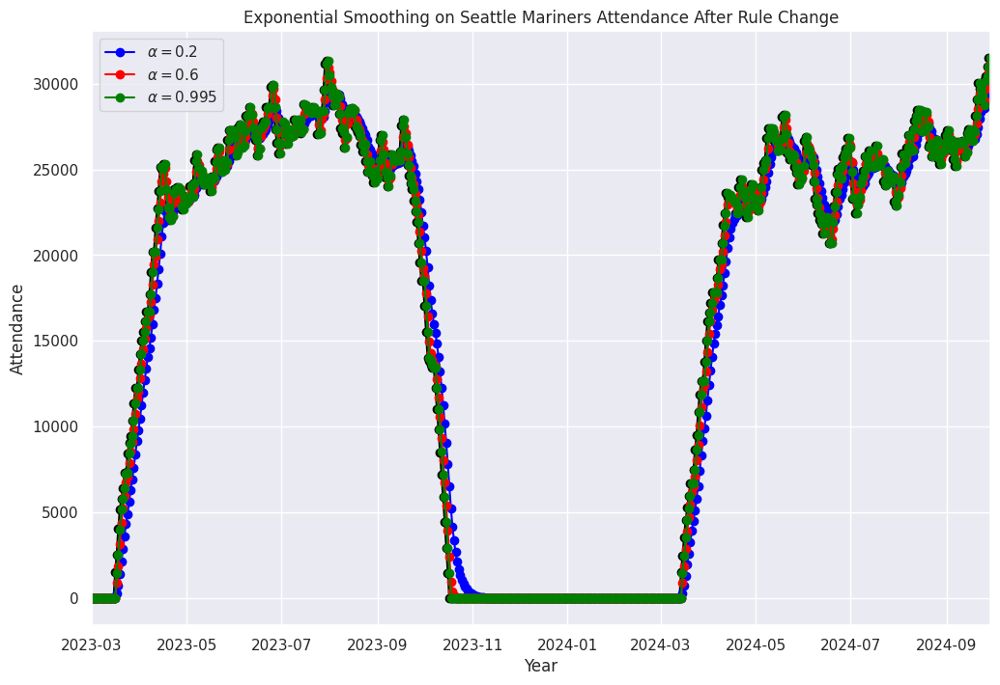

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

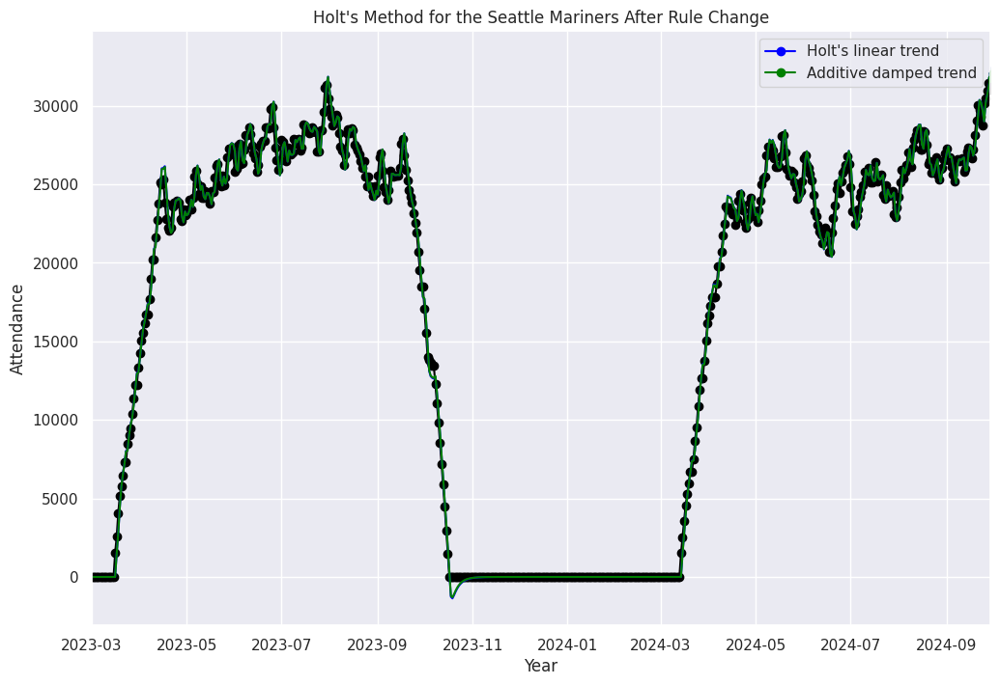

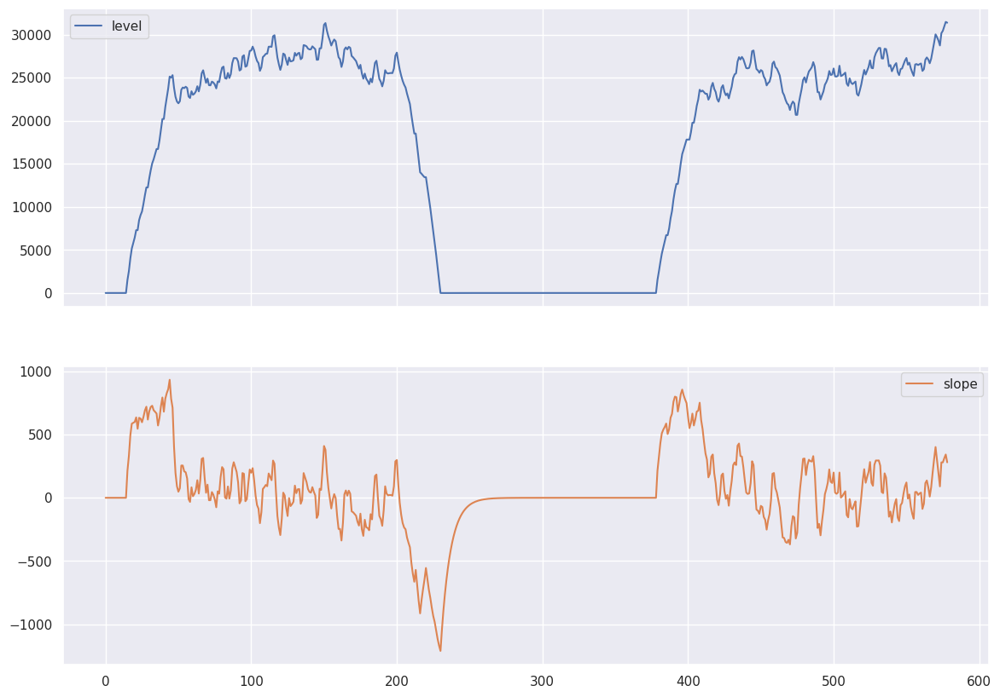

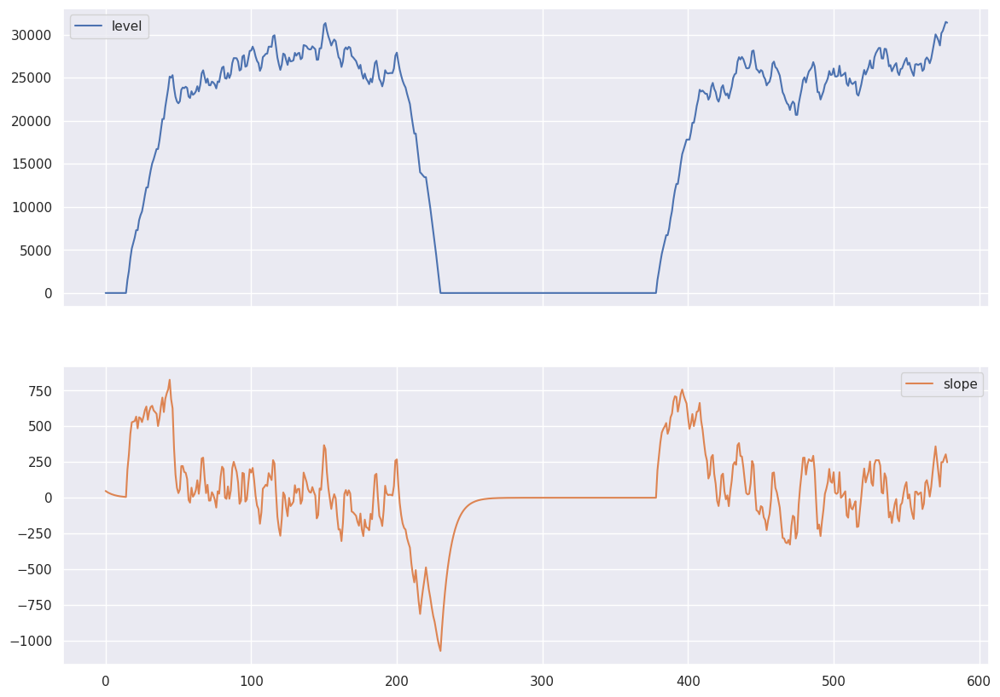

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


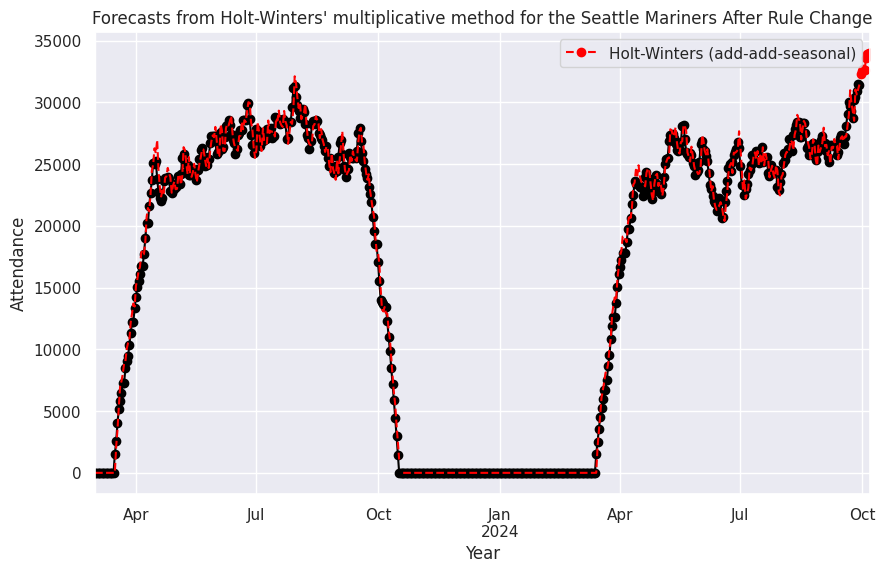

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds                NaN          NaN
Colorado Rockies               NaN          NaN
Pittsburgh Pirates             NaN          NaN
San Diego Padres               NaN          NaN
New York Mets                  NaN          NaN
New York Yankees               NaN          NaN
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
15588.73590722158
14227.12905982906
16270.529411764706
17286.106591975822
Average Change in Yearly Attendance before rul

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


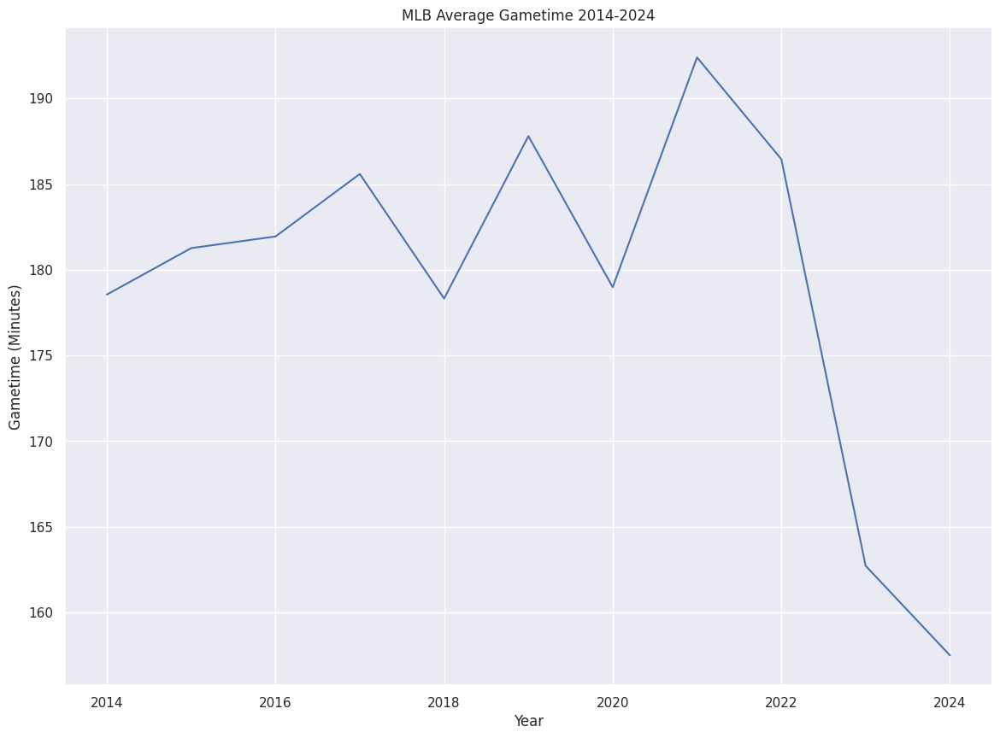

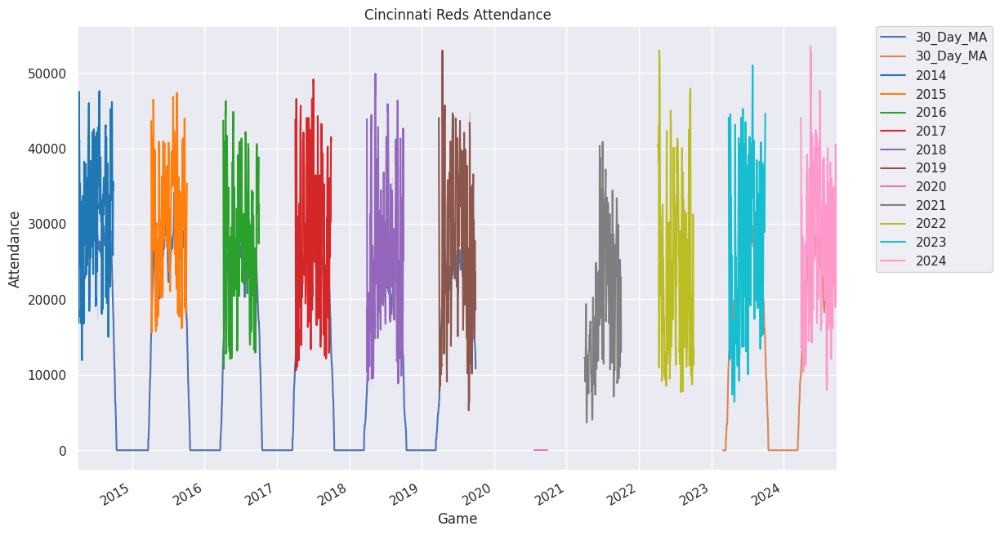

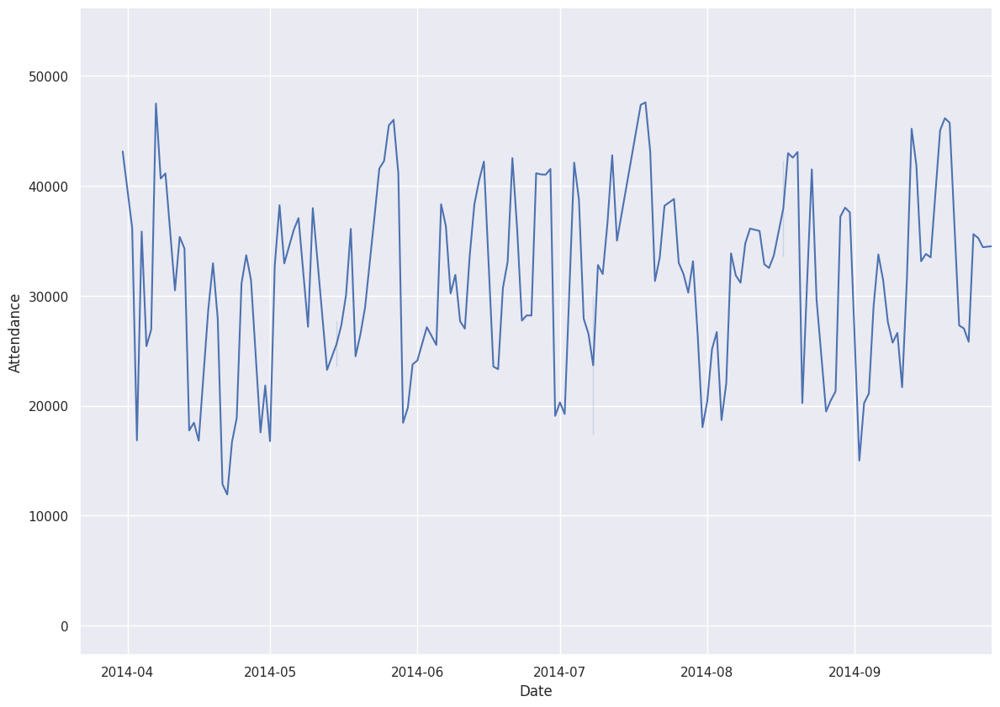

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


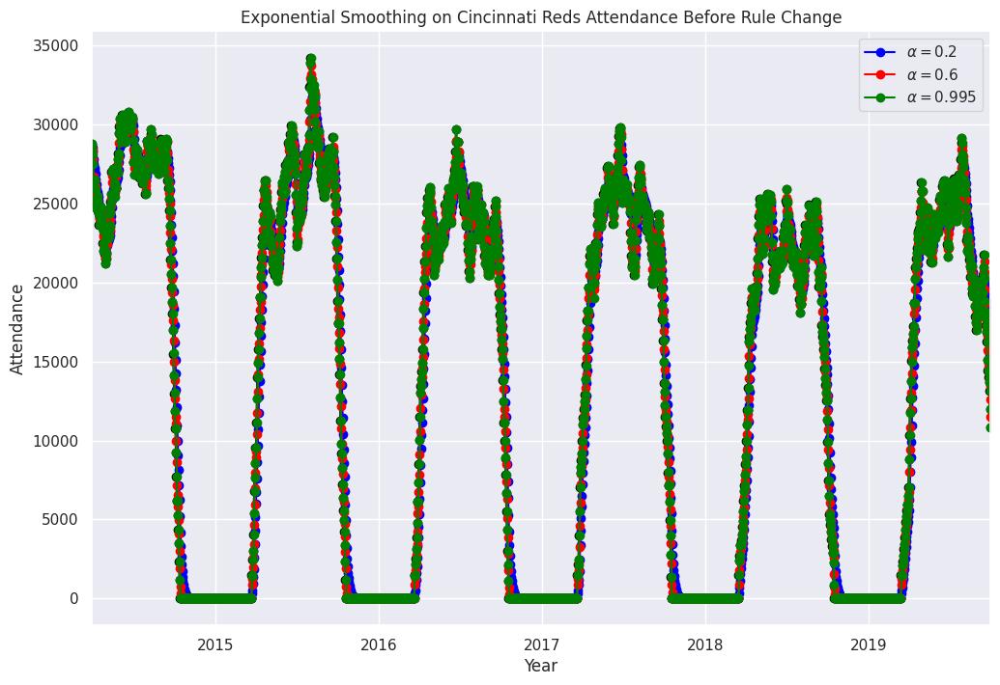

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

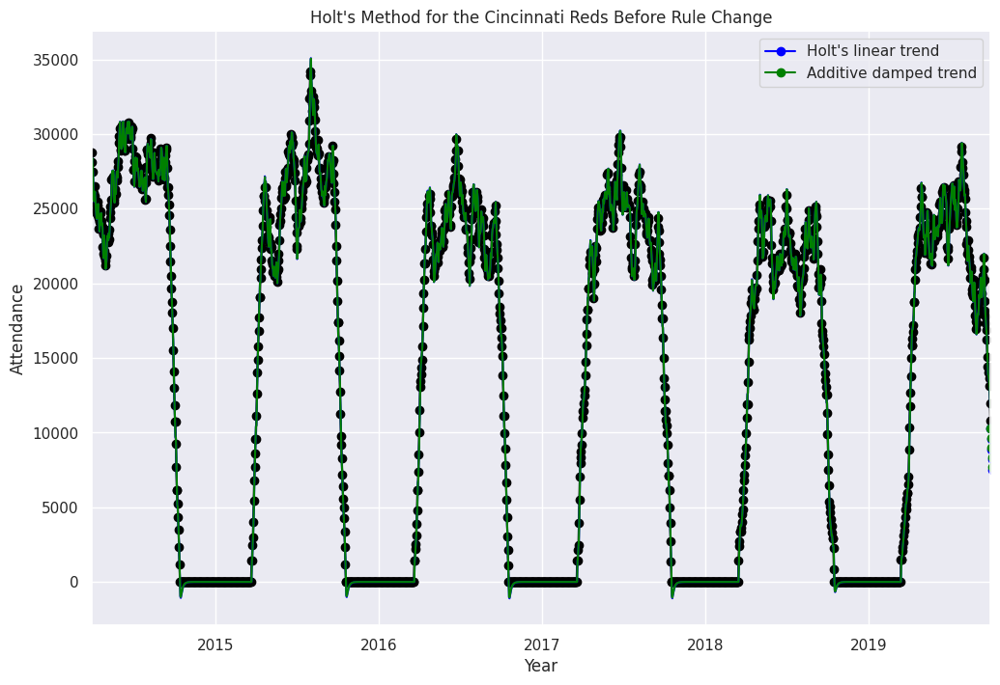

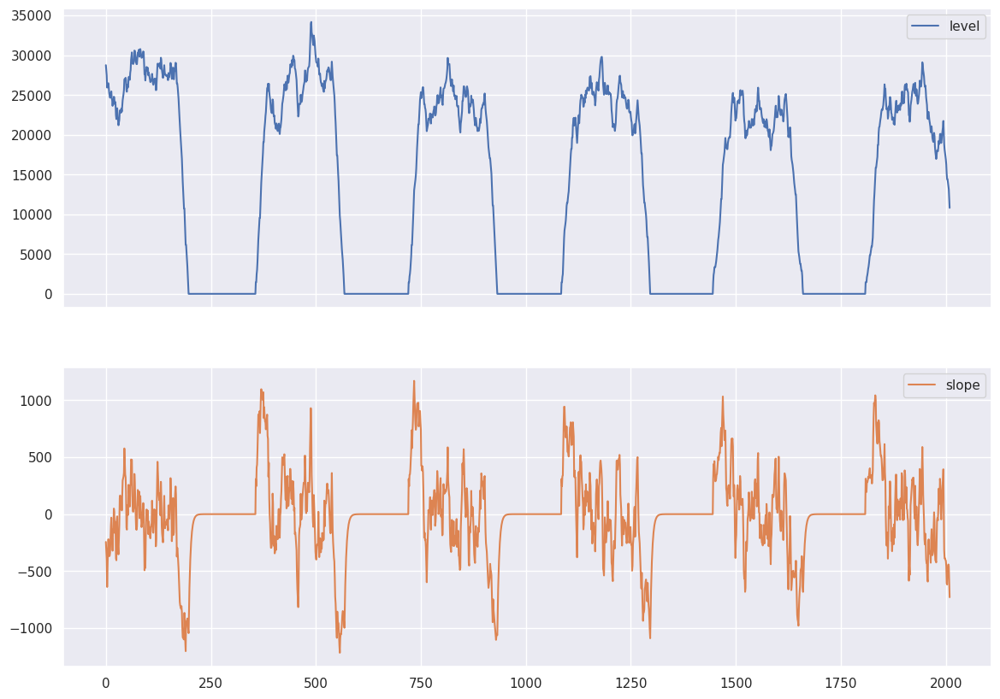

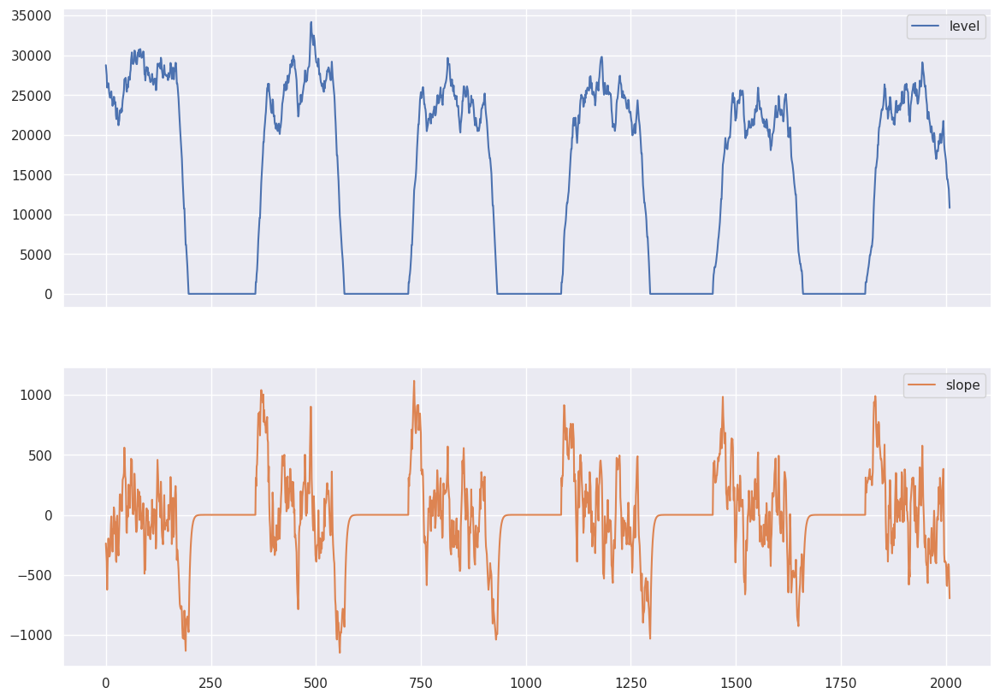

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


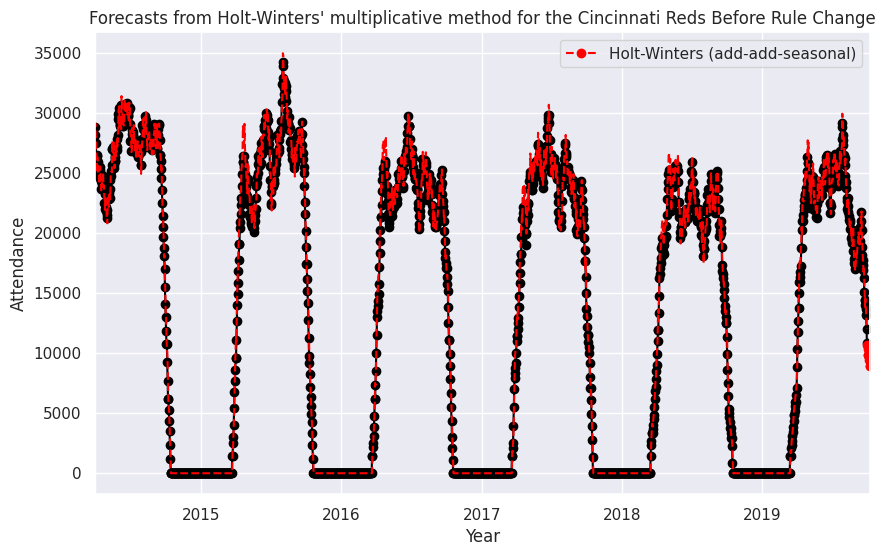

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


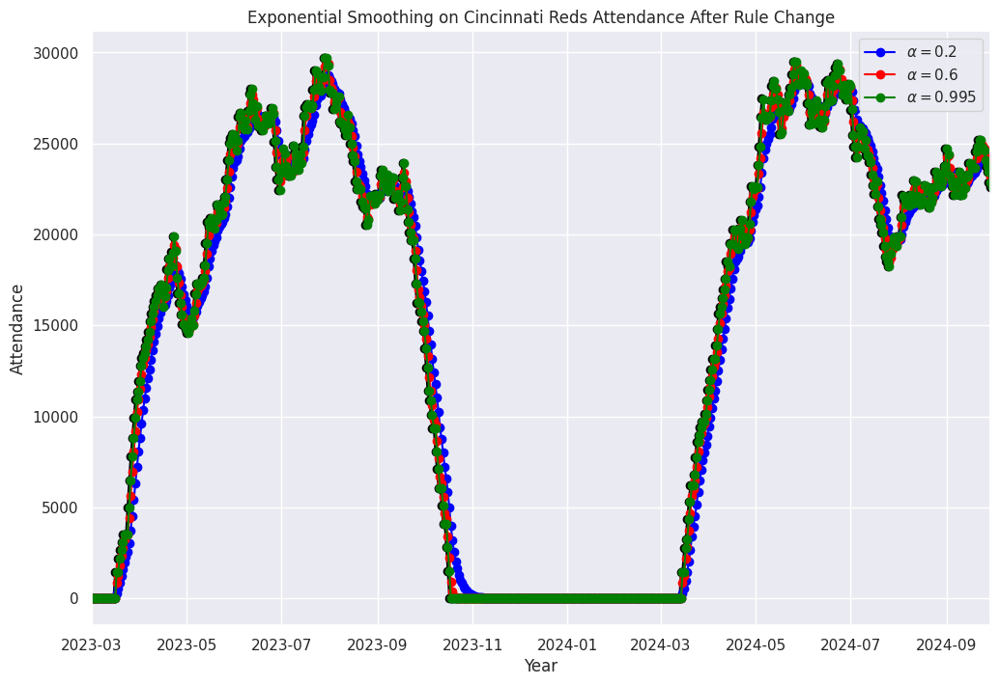

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

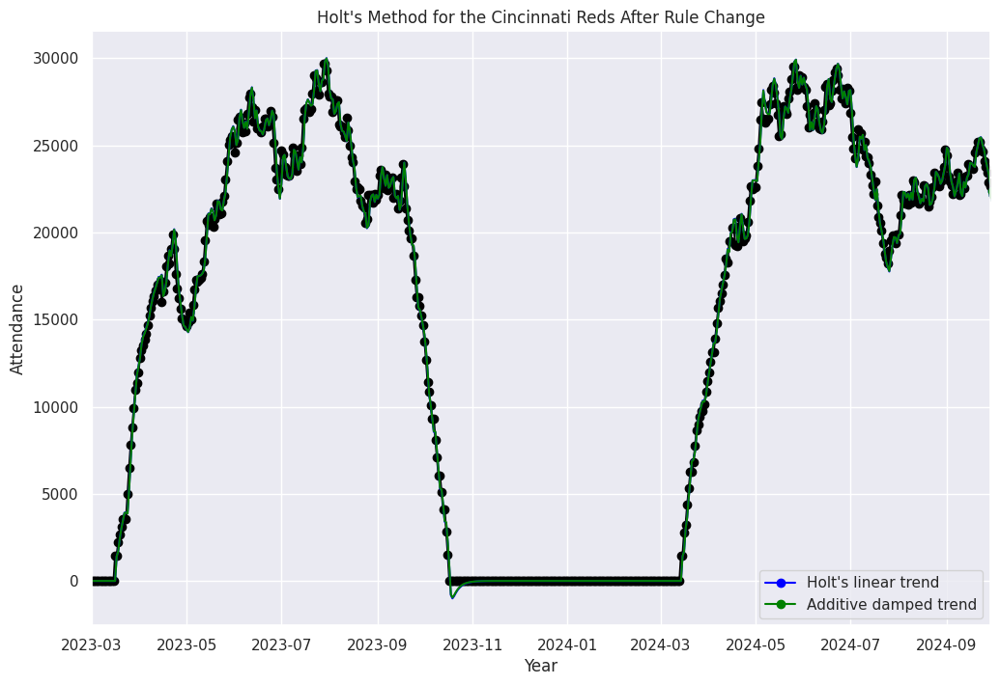

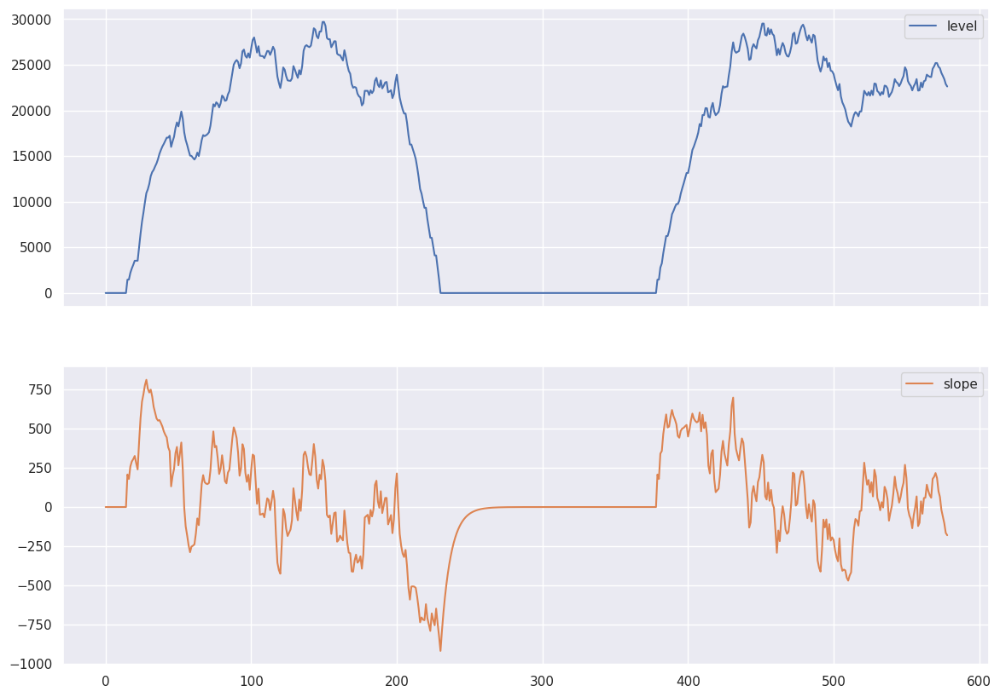

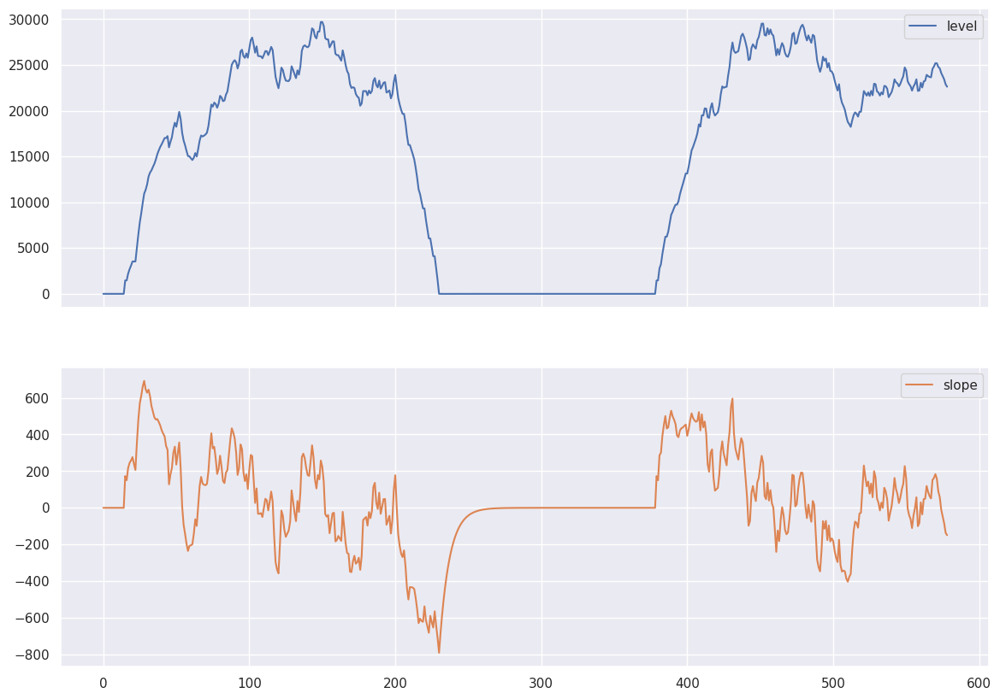

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


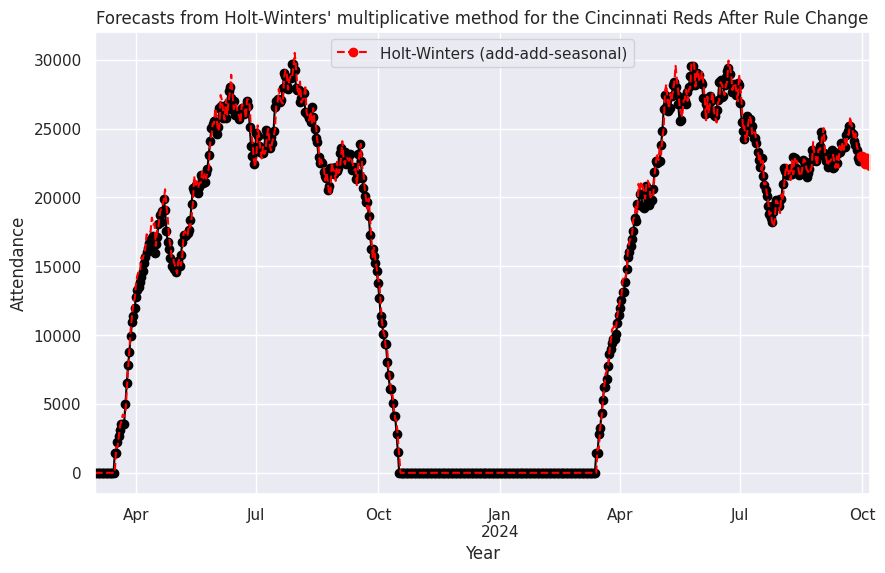

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds         184.116519   161.694444
Colorado Rockies               NaN          NaN
Pittsburgh Pirates             NaN          NaN
San Diego Padres               NaN          NaN
New York Mets                  NaN          NaN
New York Yankees               NaN          NaN
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
18113.103266767812
15003.964346764347
14002.32679738562
16144.8472765974
Average Change in Yearly Attendance before rule

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


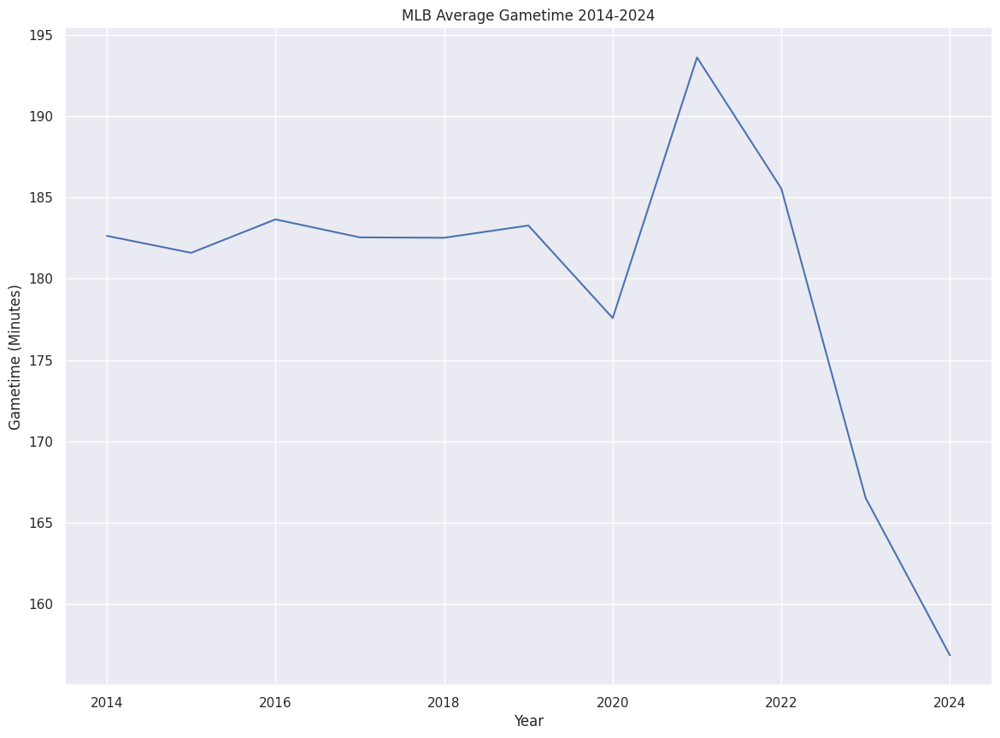

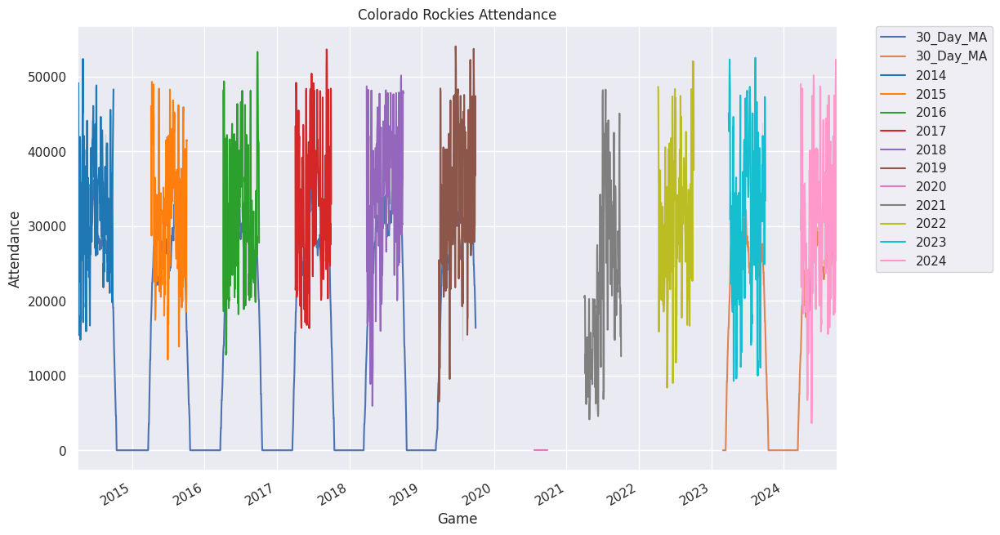

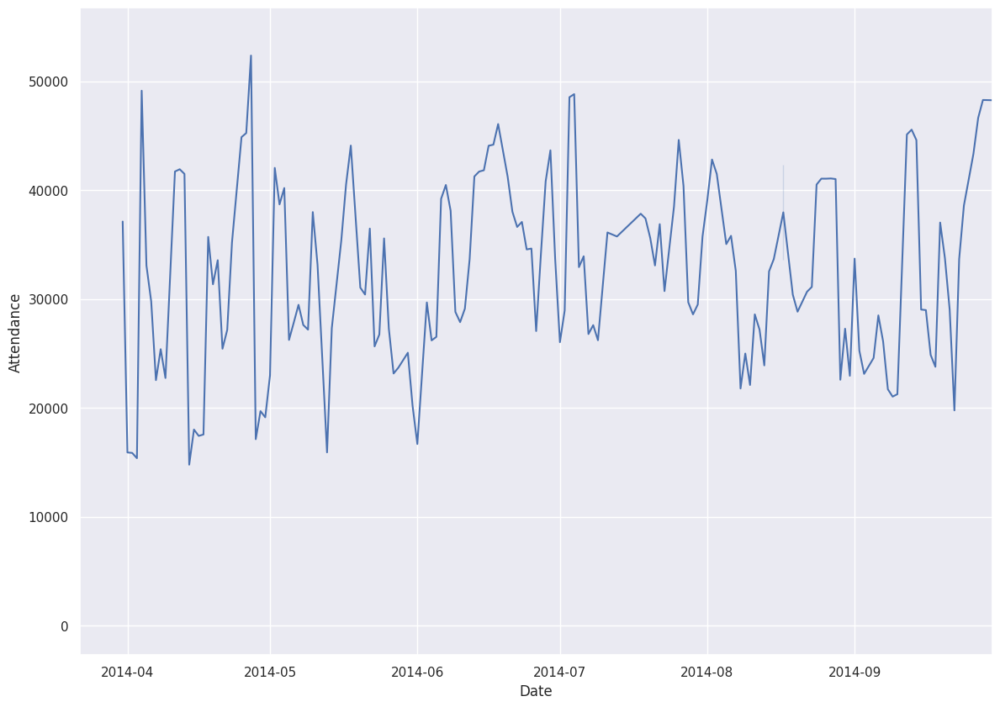

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


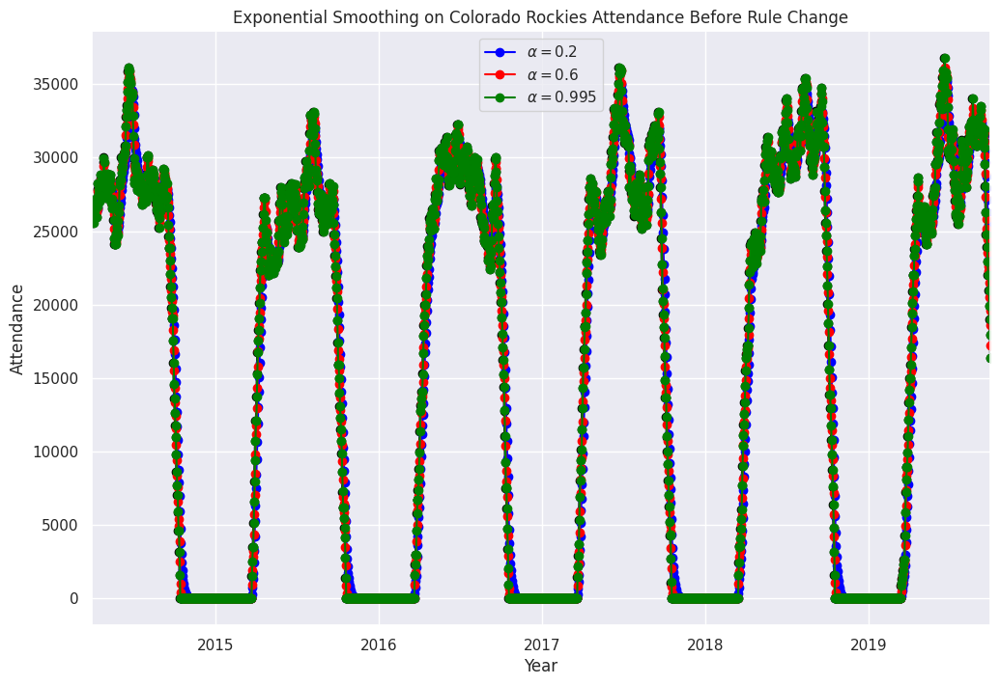

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

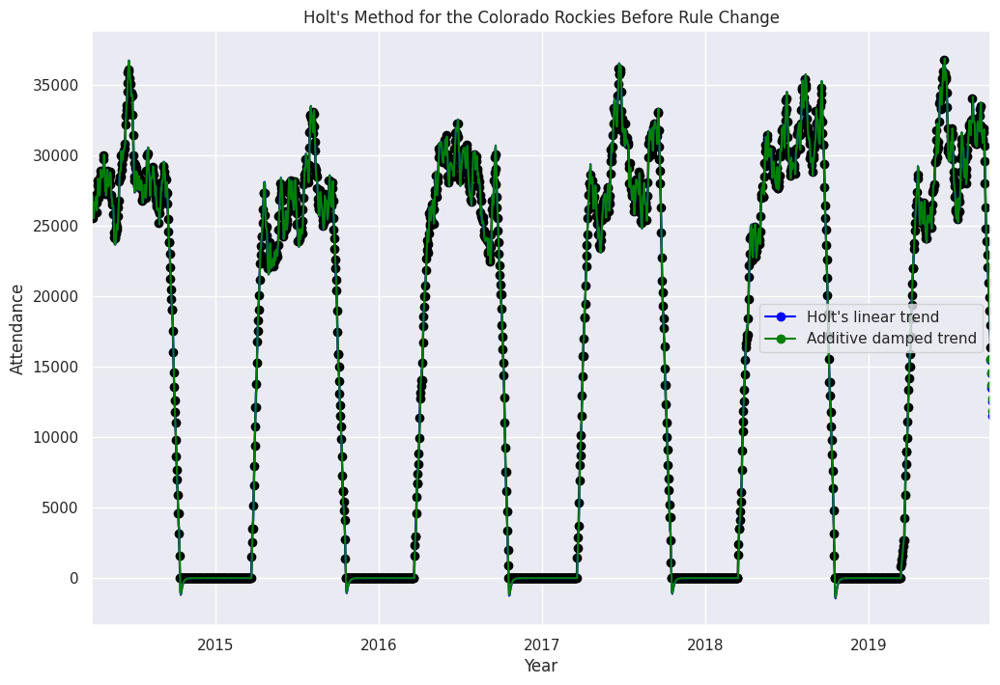

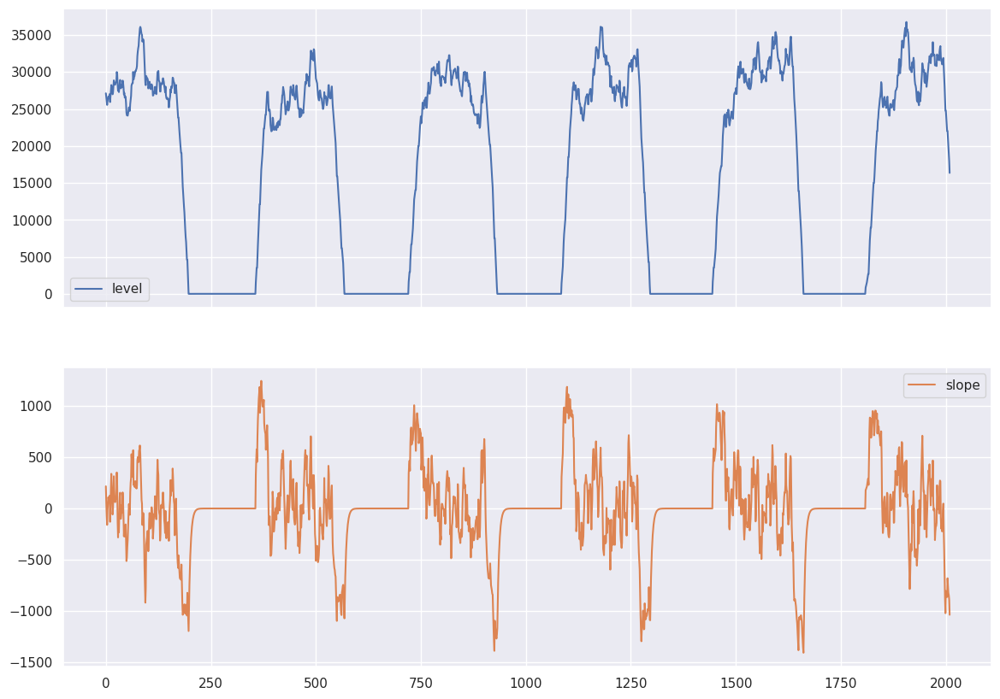

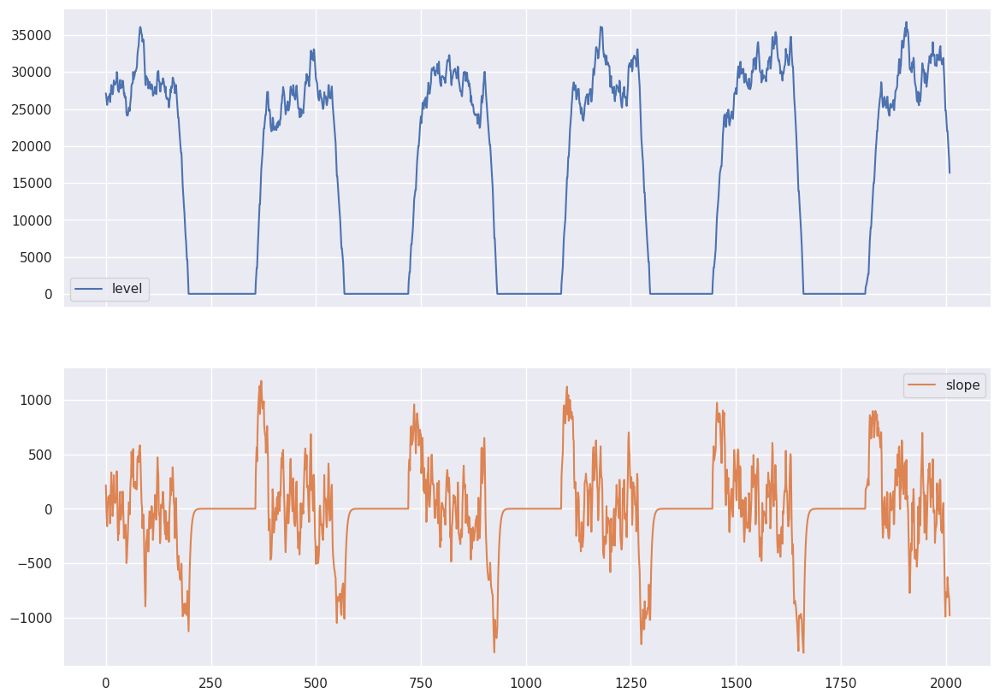

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


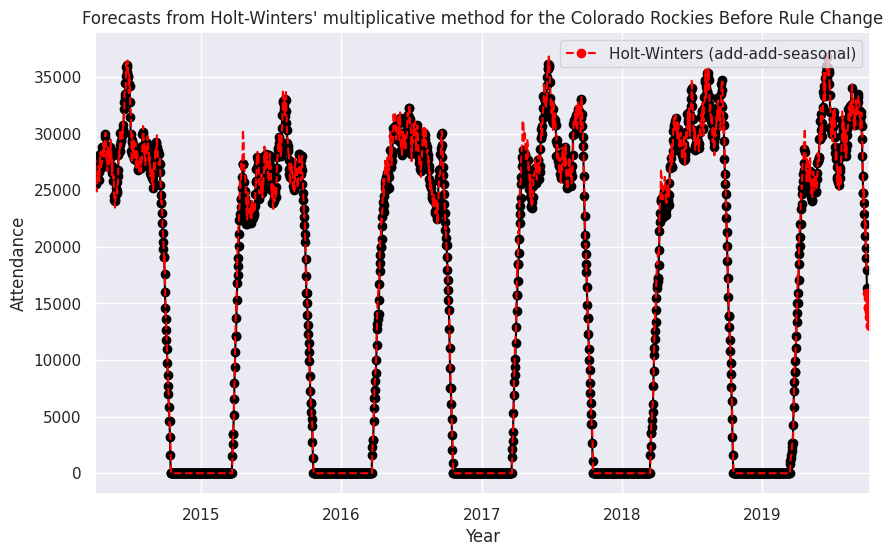

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


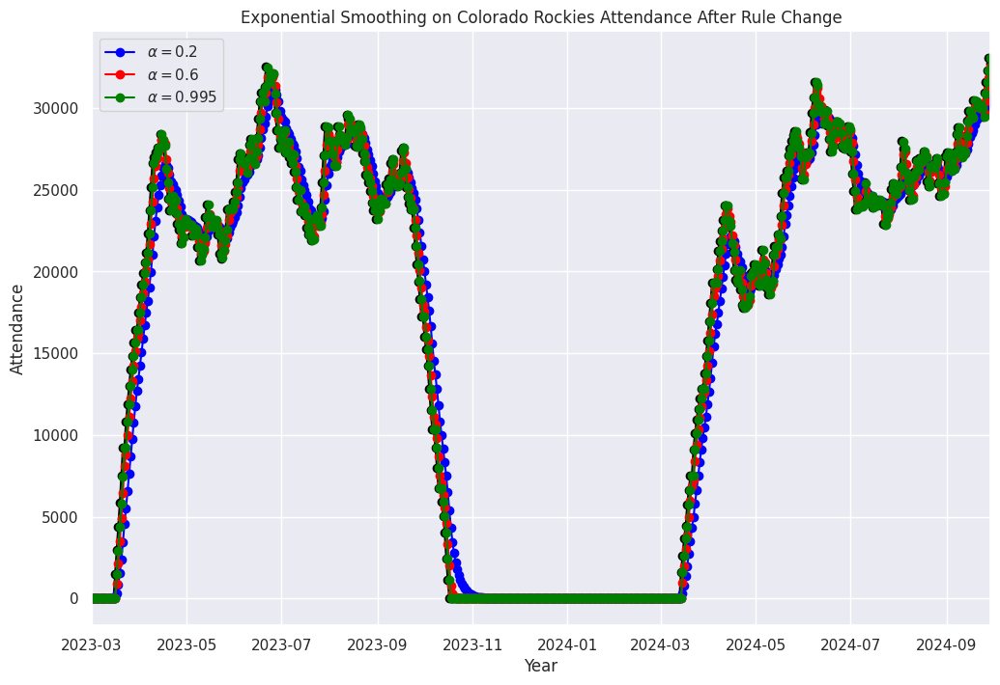

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

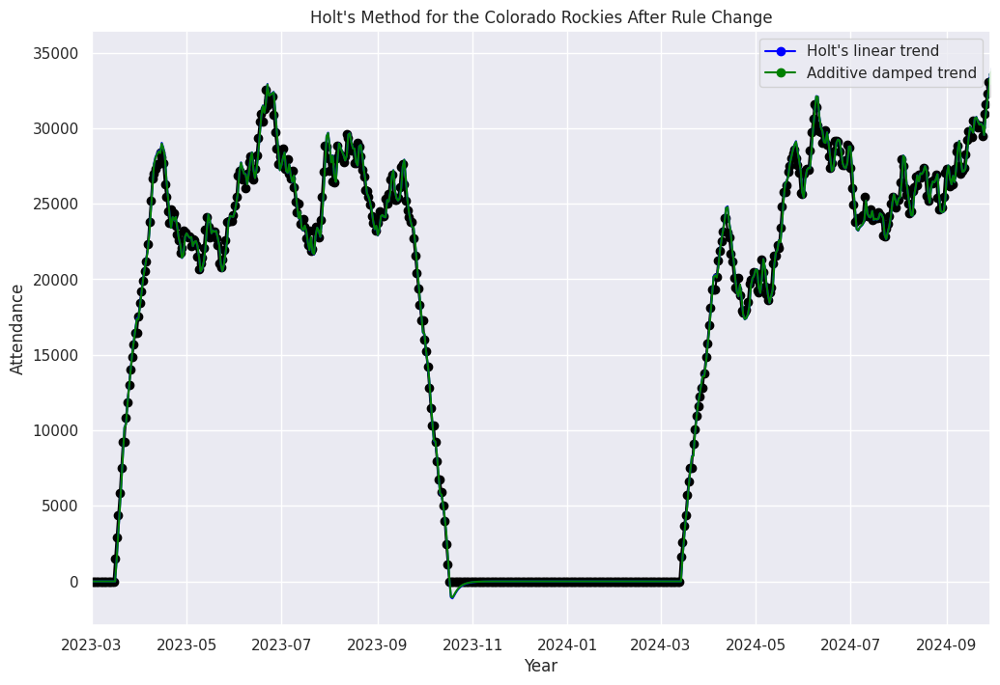

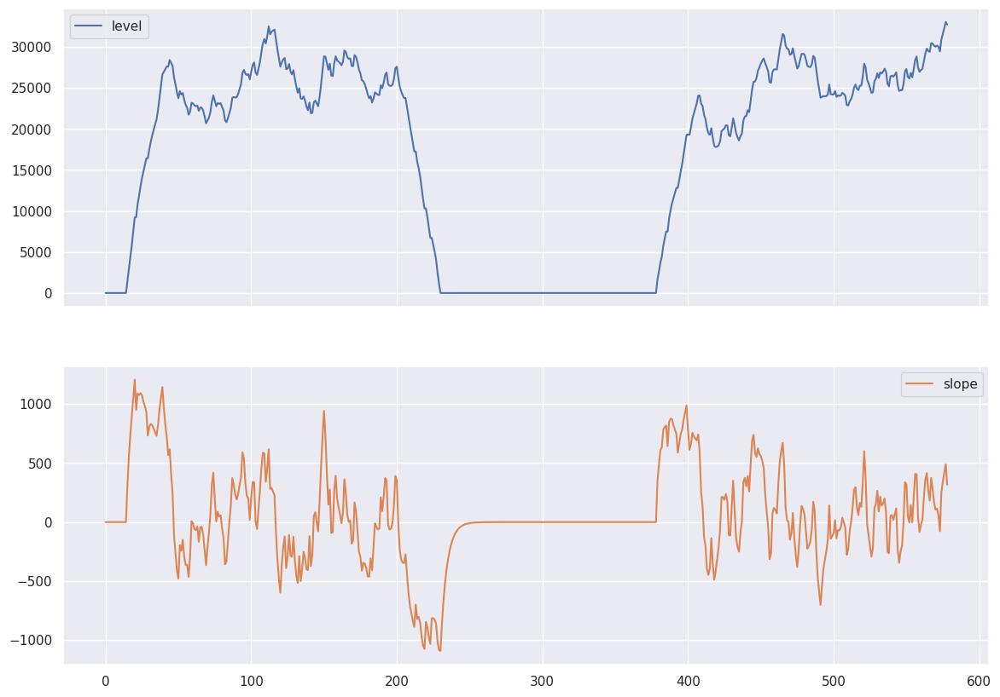

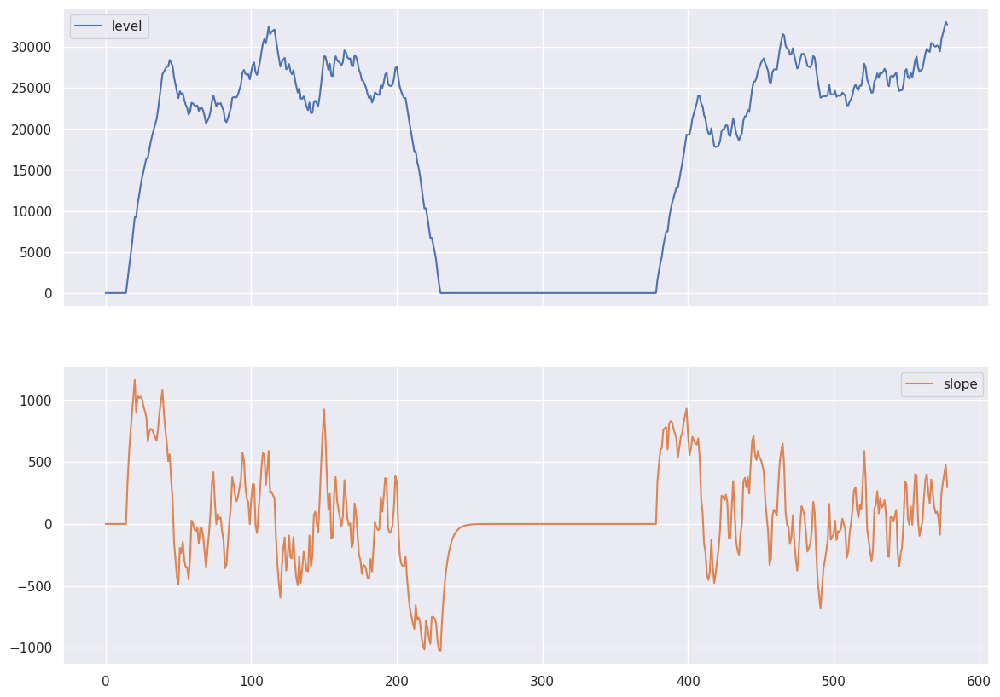

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


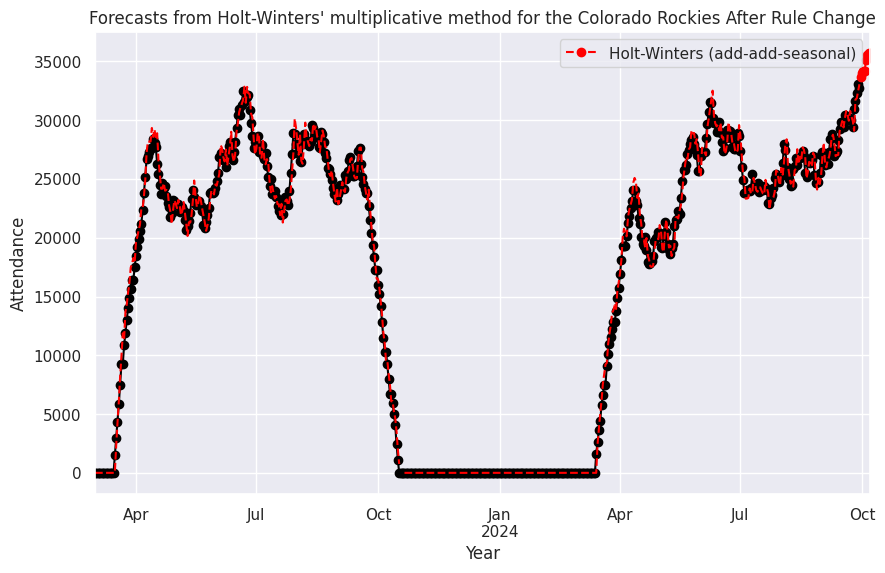

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds         184.116519   161.694444
Colorado Rockies        189.514749   159.975309
Pittsburgh Pirates             NaN          NaN
San Diego Padres               NaN          NaN
New York Mets                  NaN          NaN
New York Yankees               NaN          NaN
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
18928.44755395809
19365.905982905984
16134.87908496732
17458.362129389432
Average Change in Yearly Attendance before rul

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


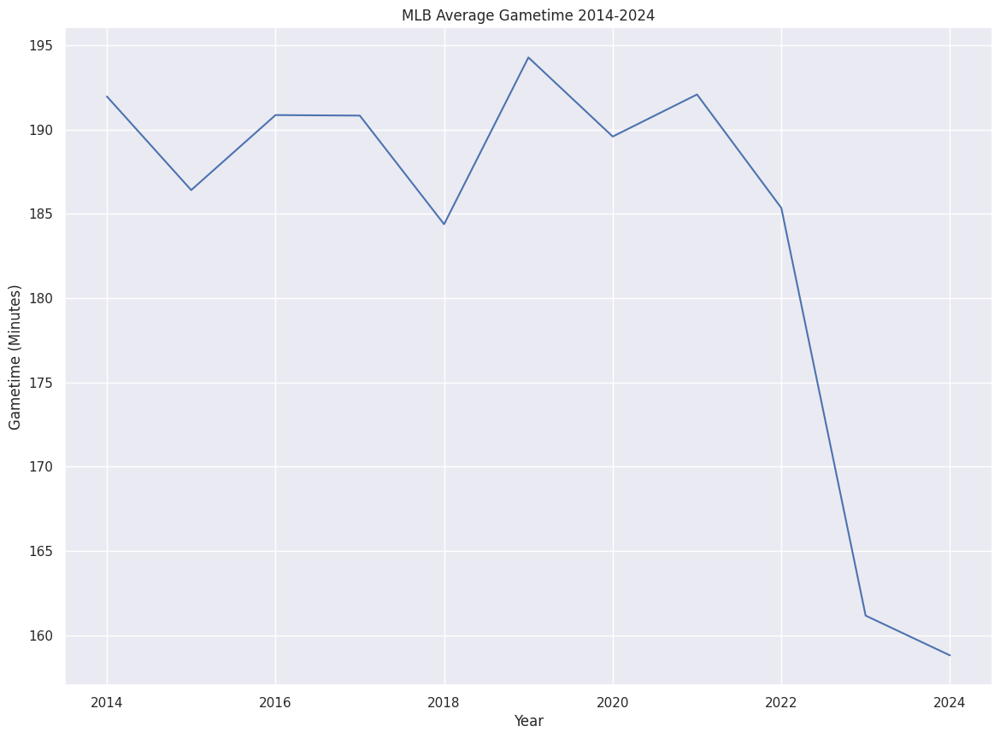

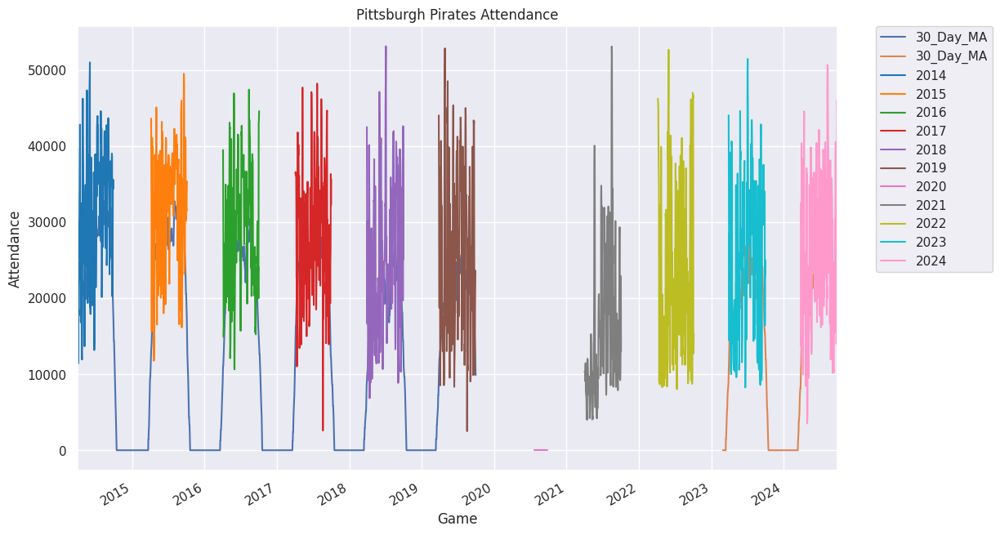

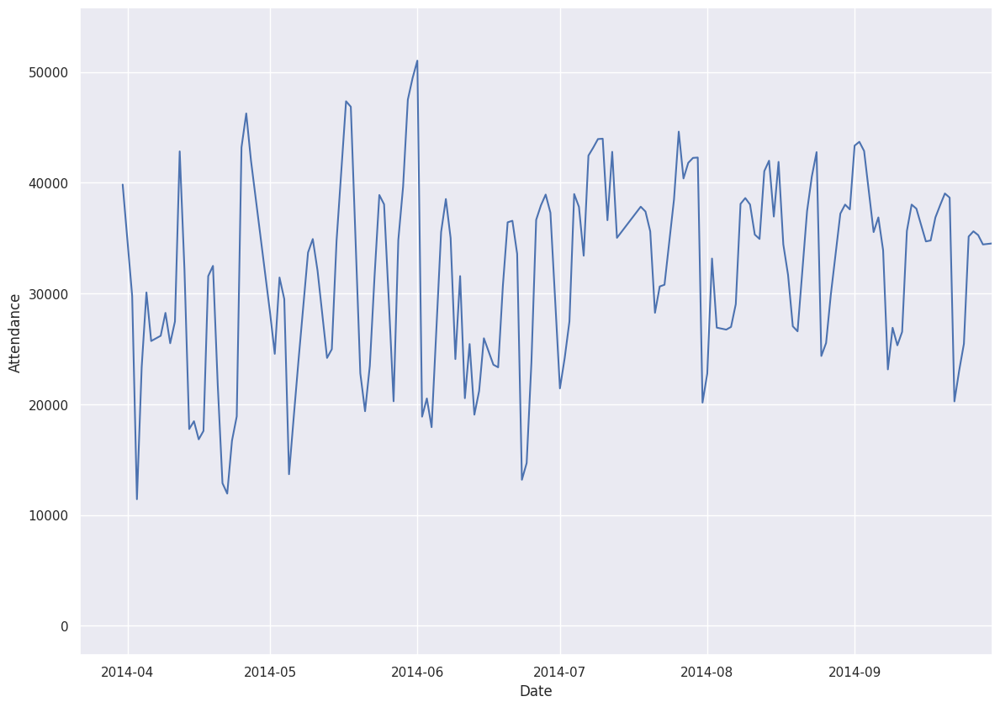

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


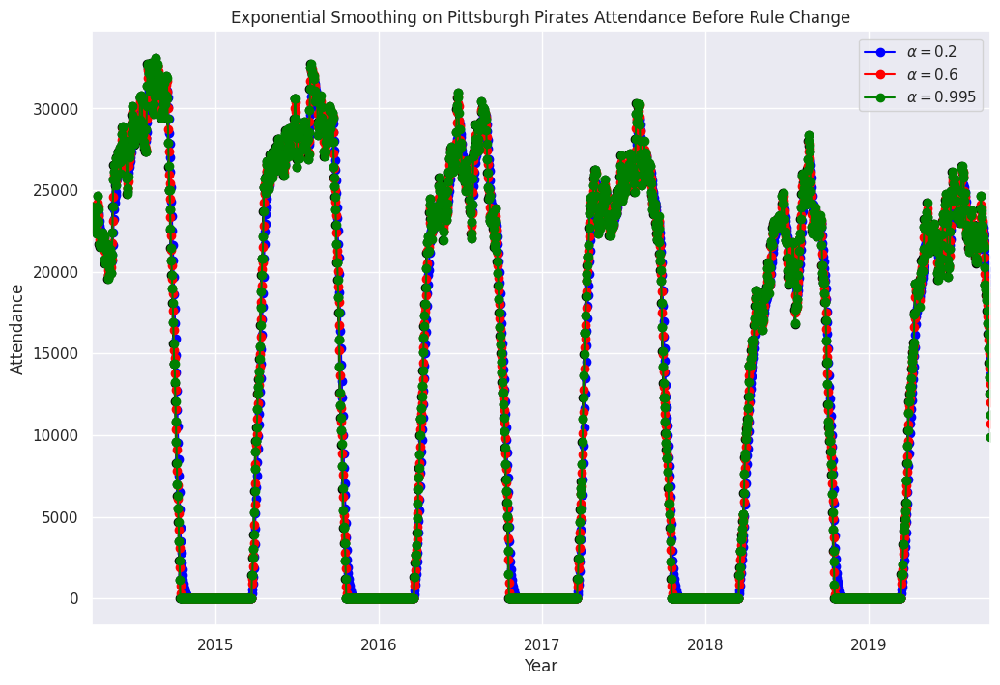

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

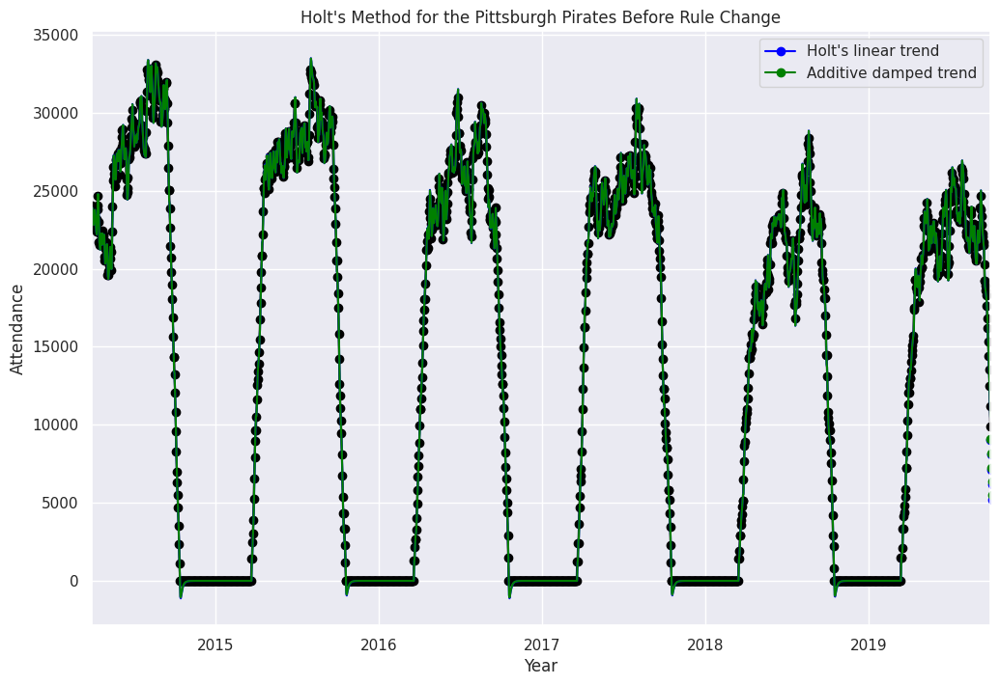

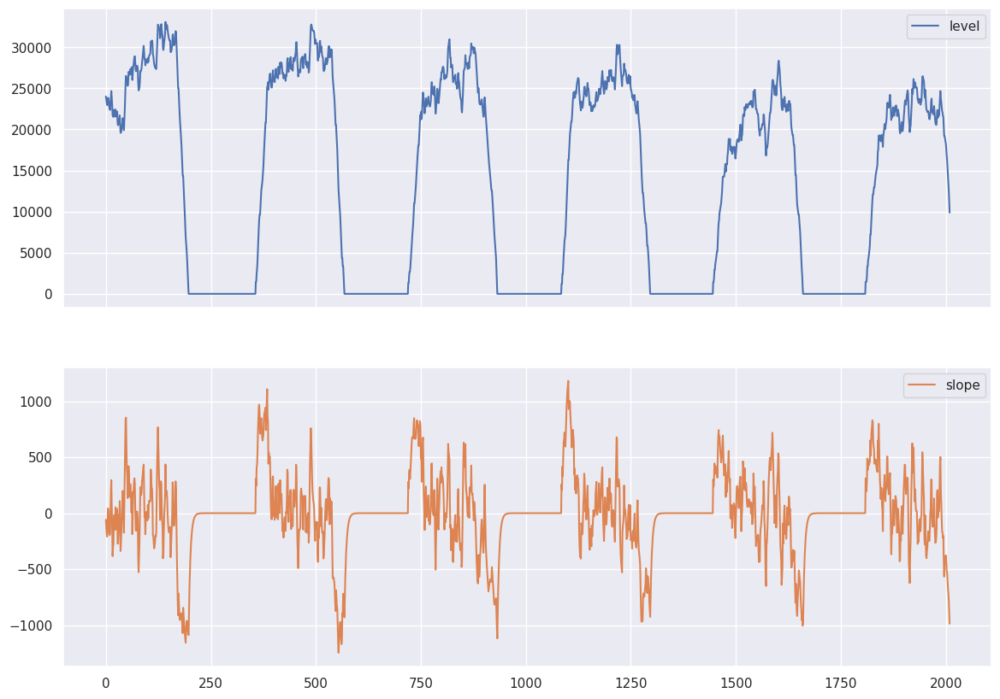

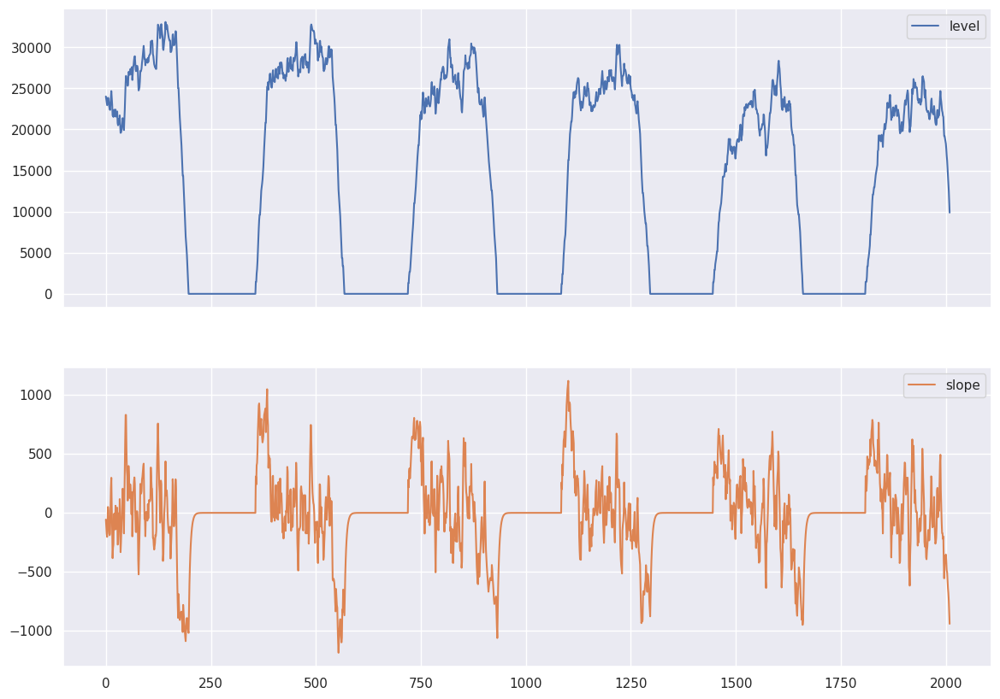

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


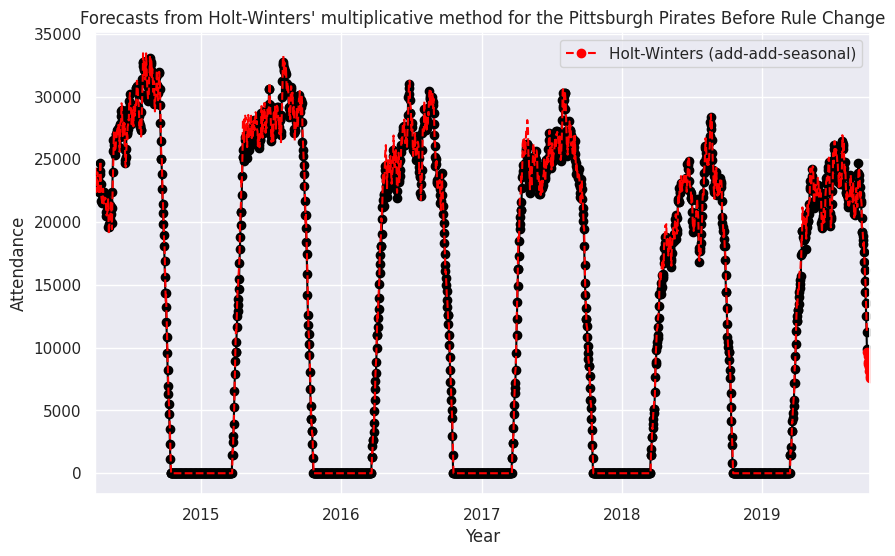

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


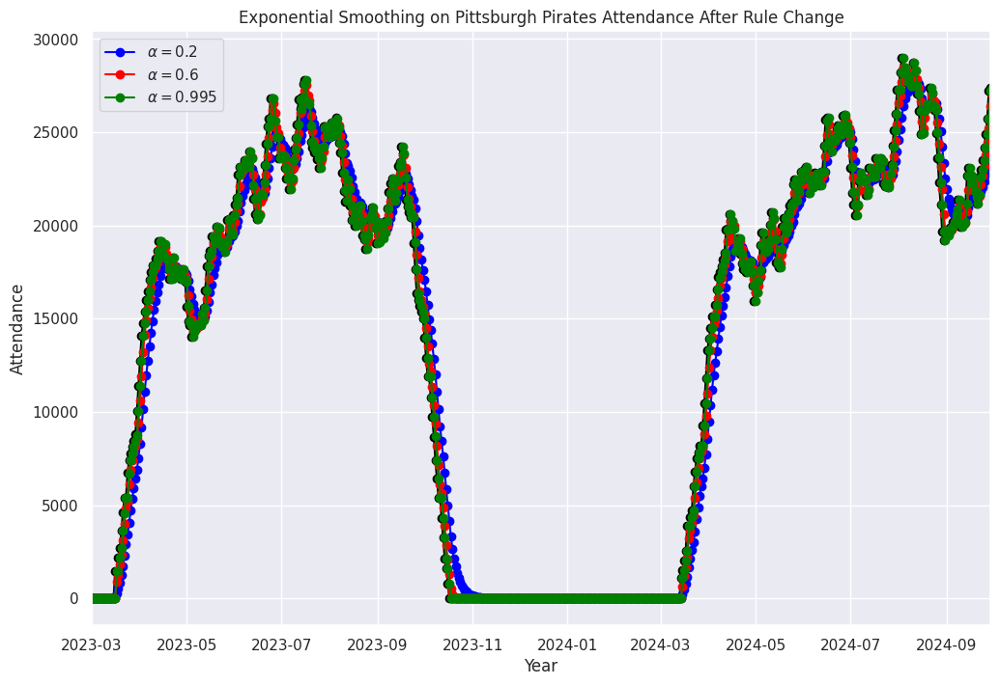

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

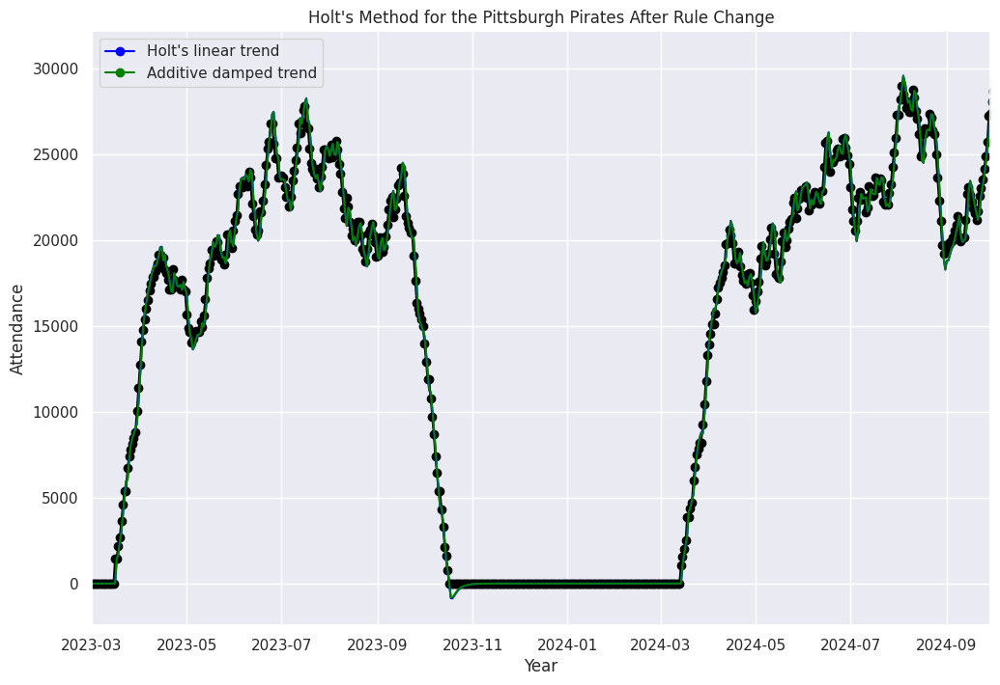

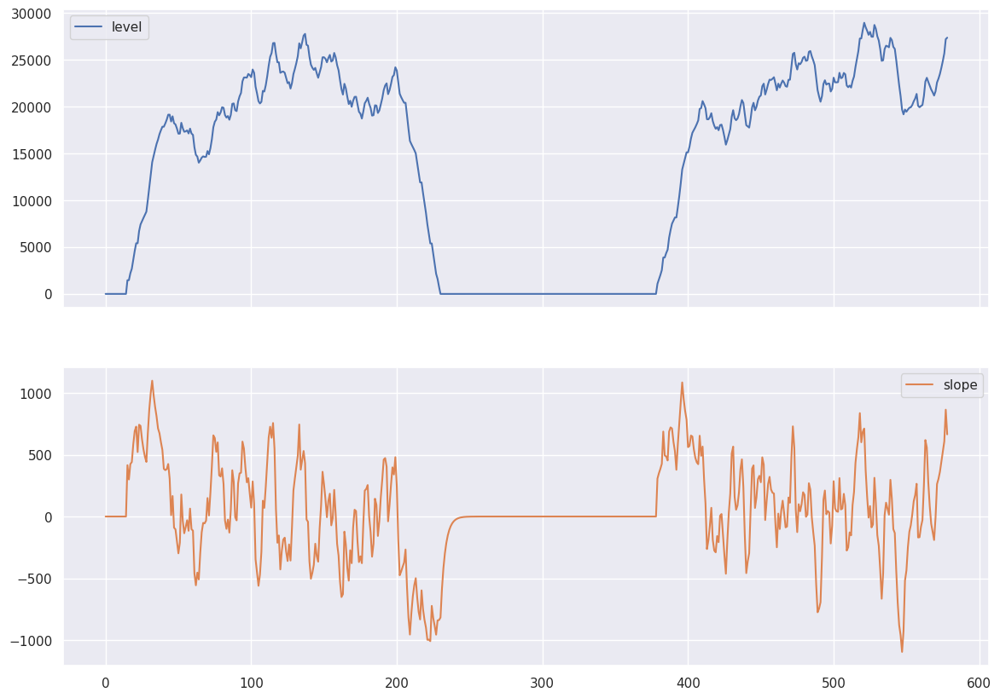

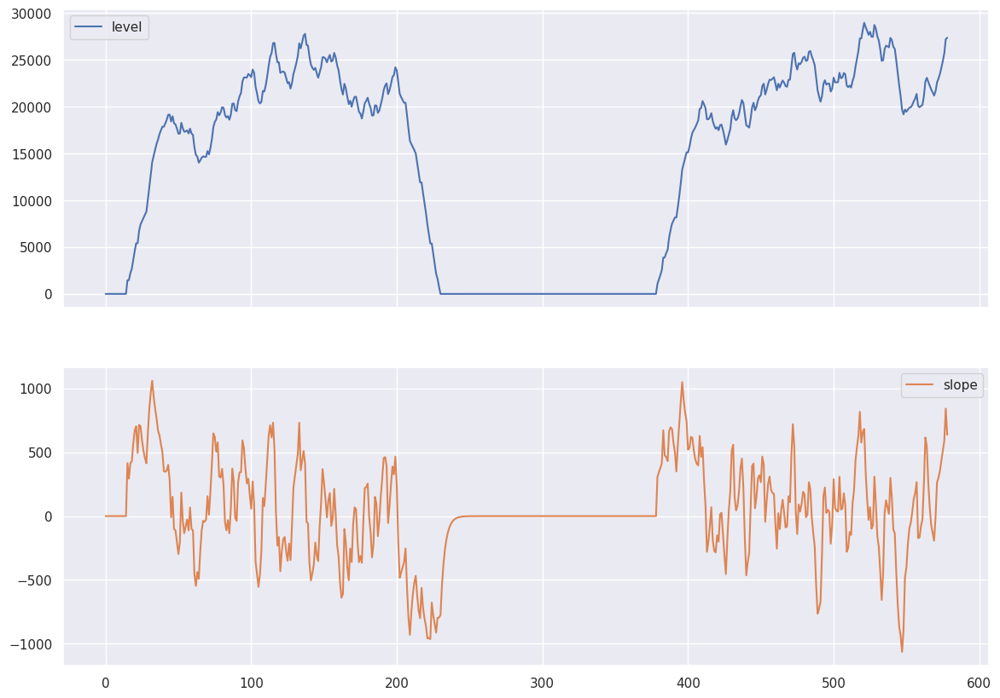

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


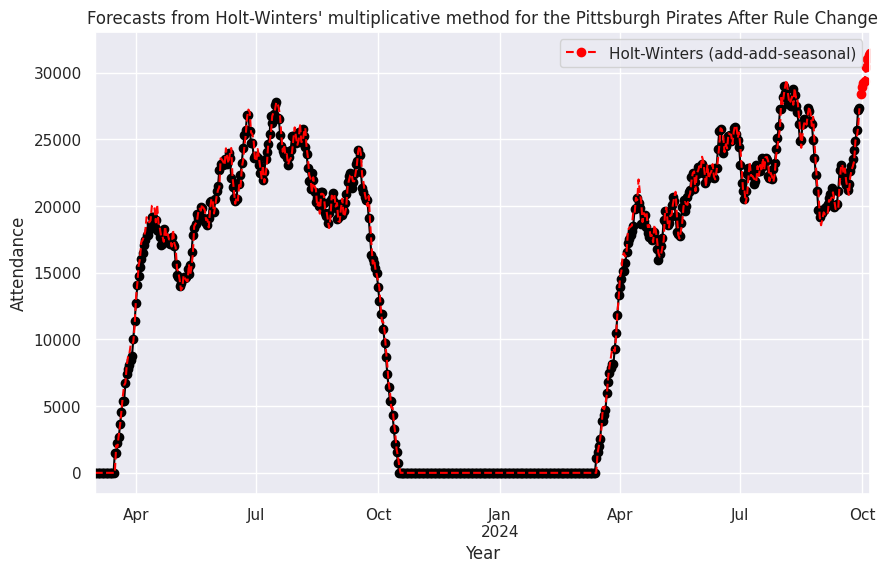

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds         184.116519   161.694444
Colorado Rockies        189.514749   159.975309
Pittsburgh Pirates      187.714391   159.348765
San Diego Padres               NaN          NaN
New York Mets                  NaN          NaN
New York Yankees               NaN          NaN
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
18169.544491382483
14631.811233211234
13121.444444444445
15131.905057629348
Average Change in Yearly Attendance before r

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


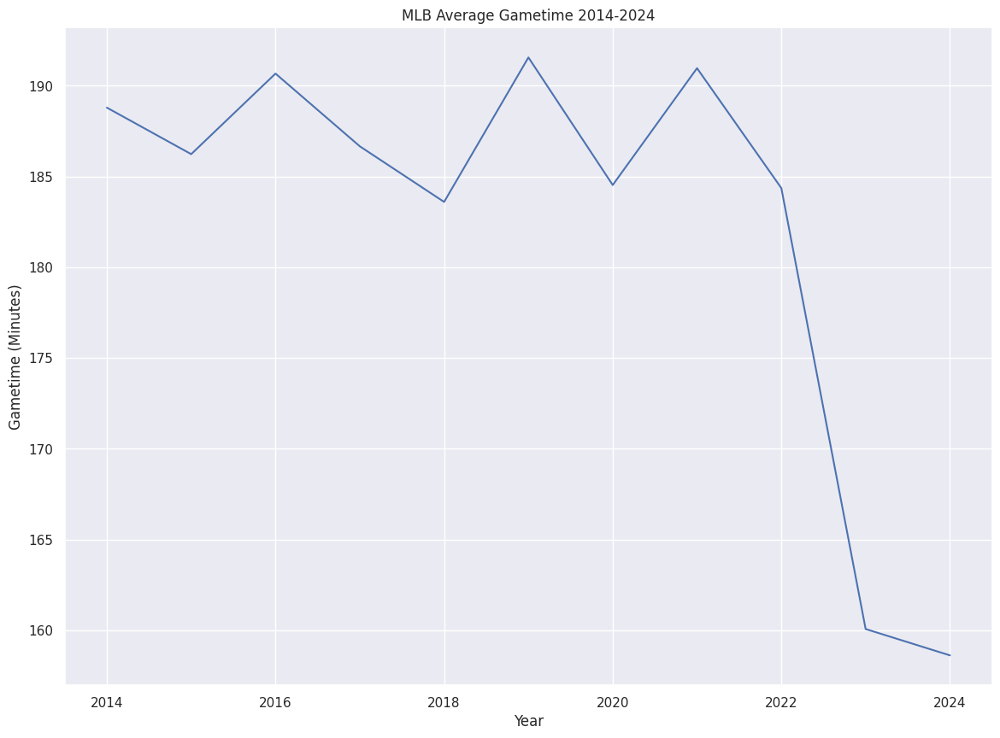

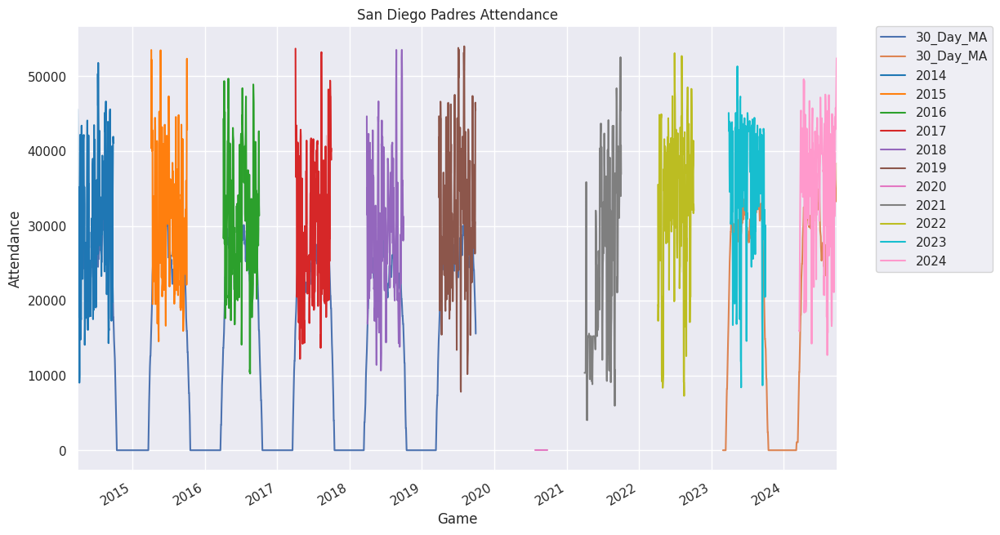

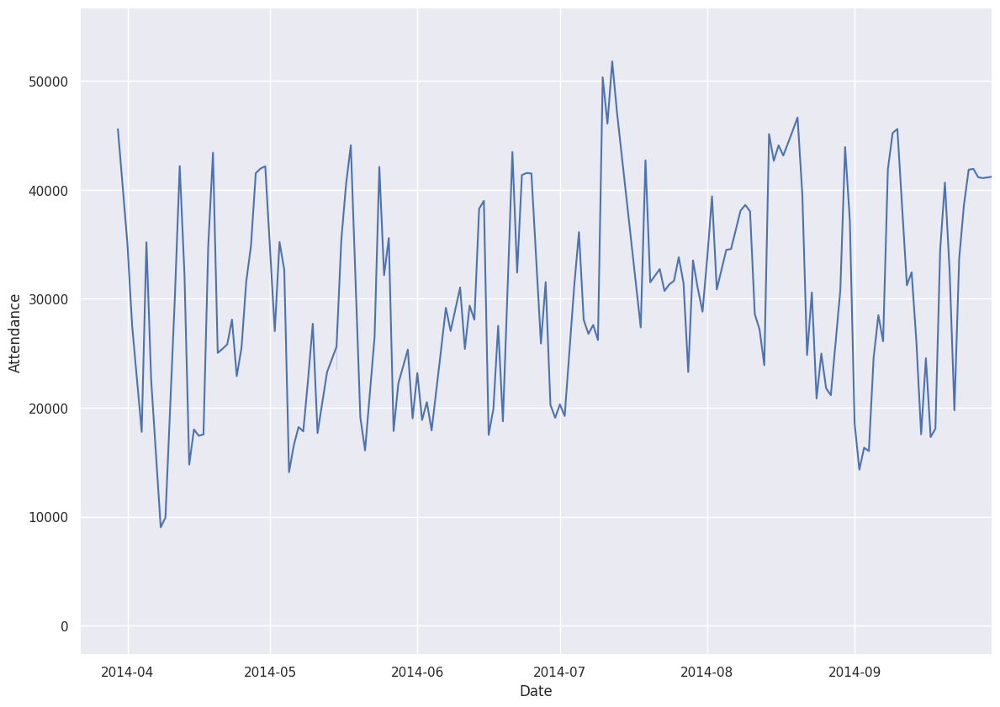

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


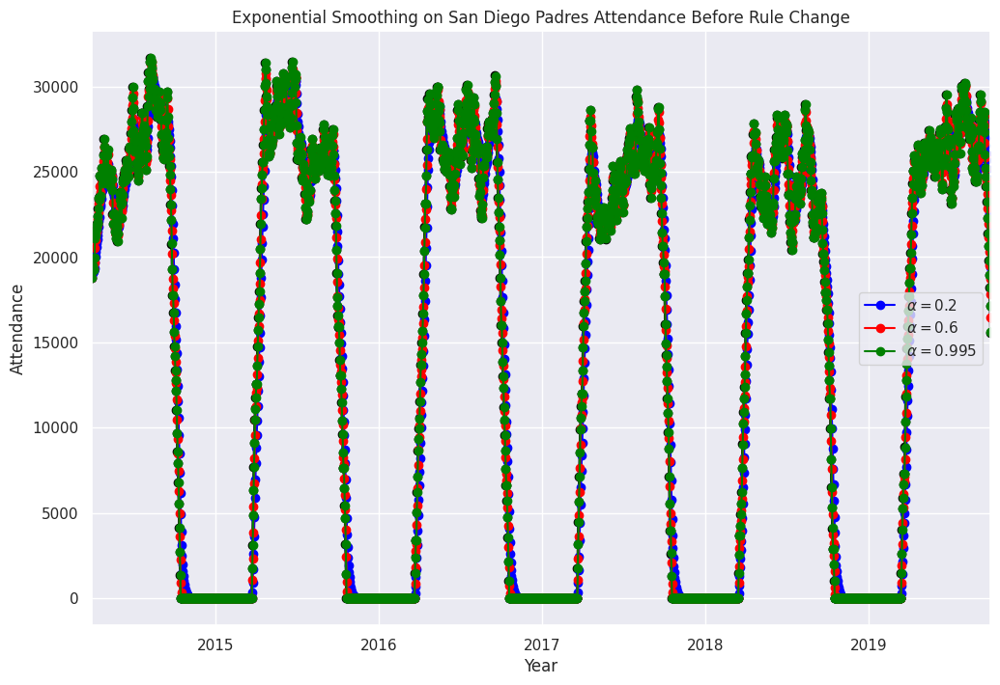

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

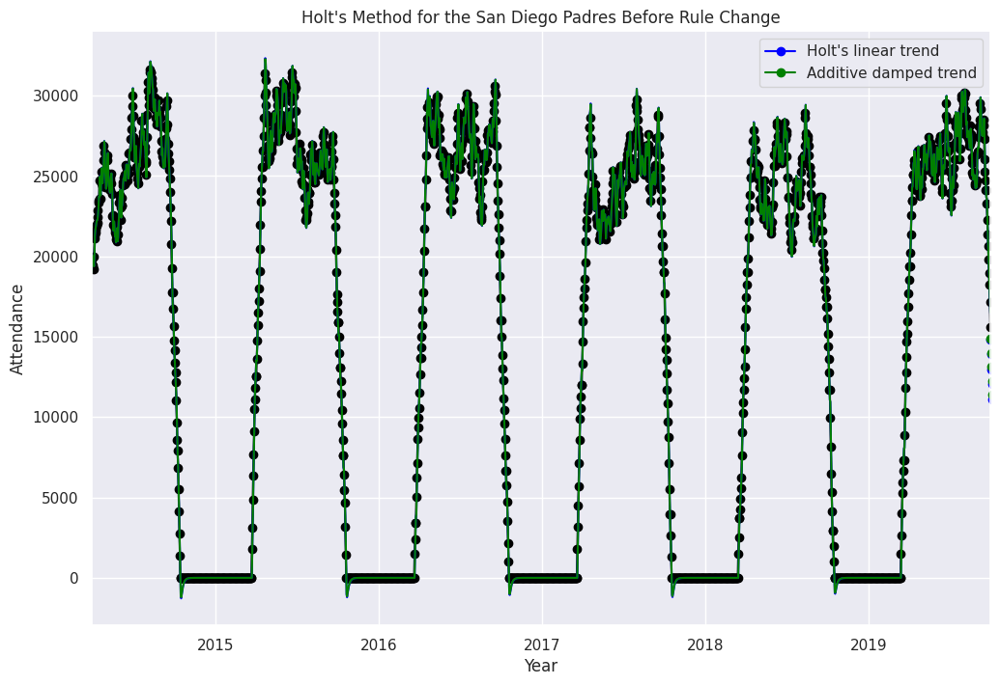

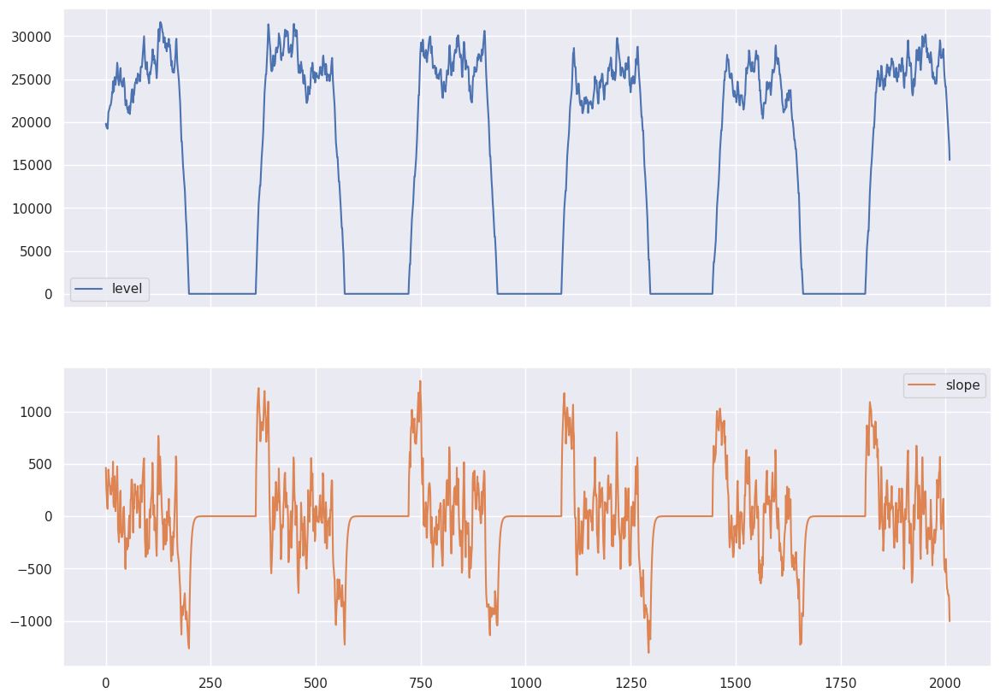

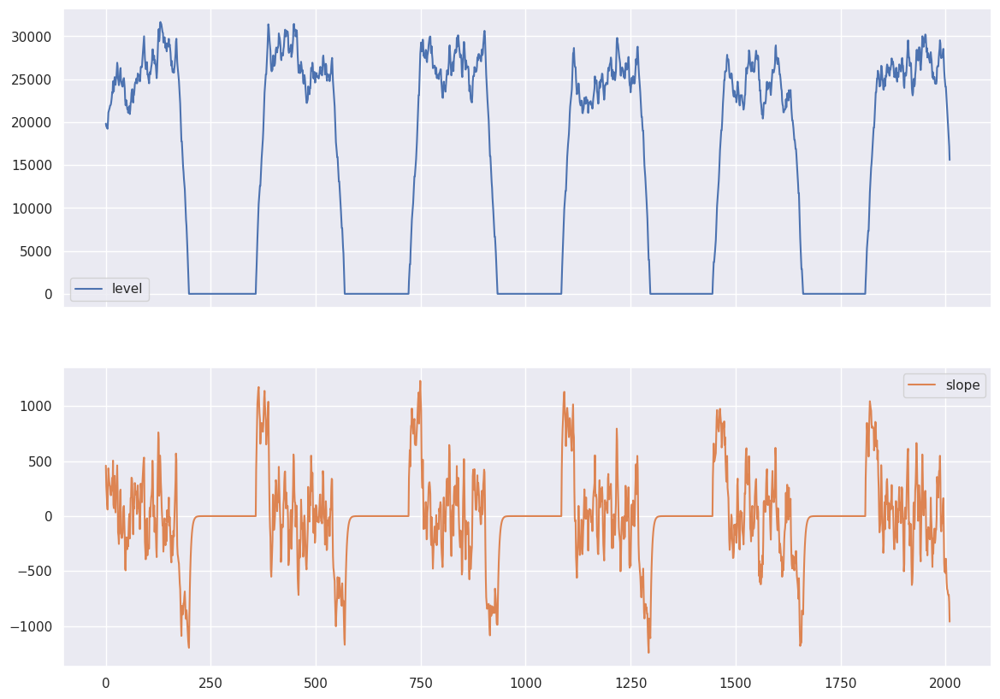

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


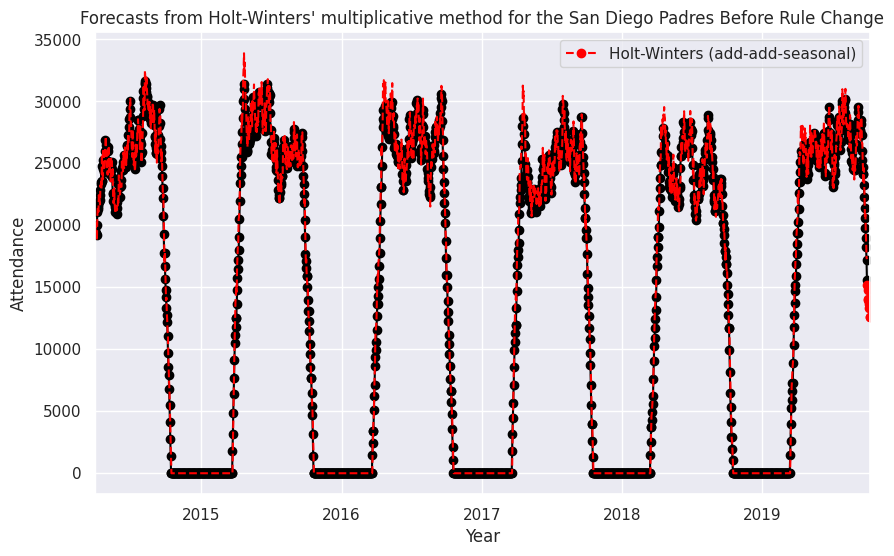

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


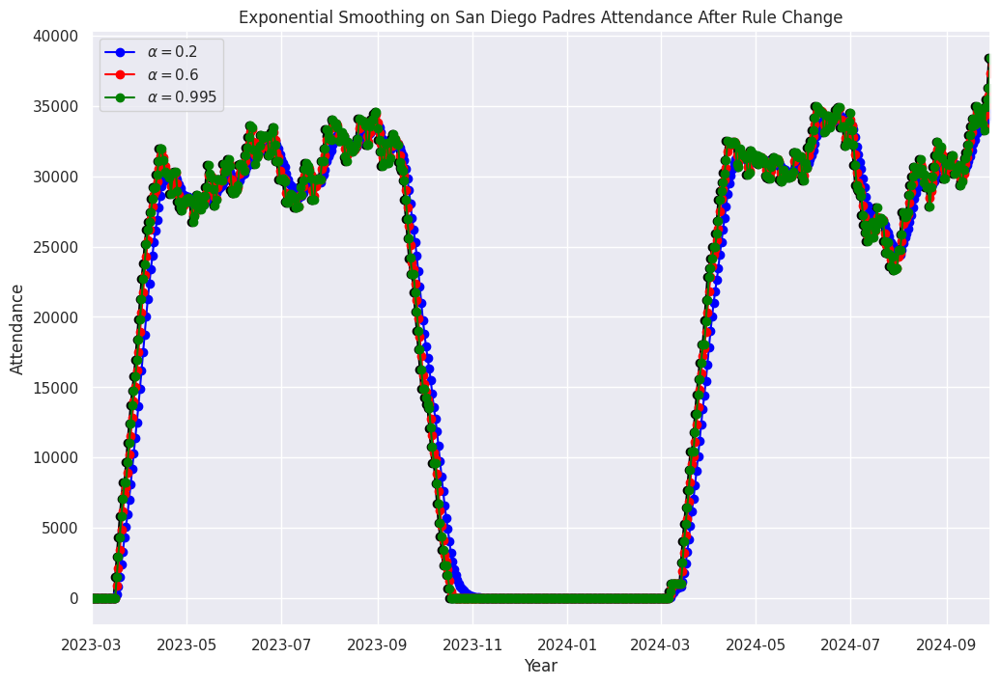

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

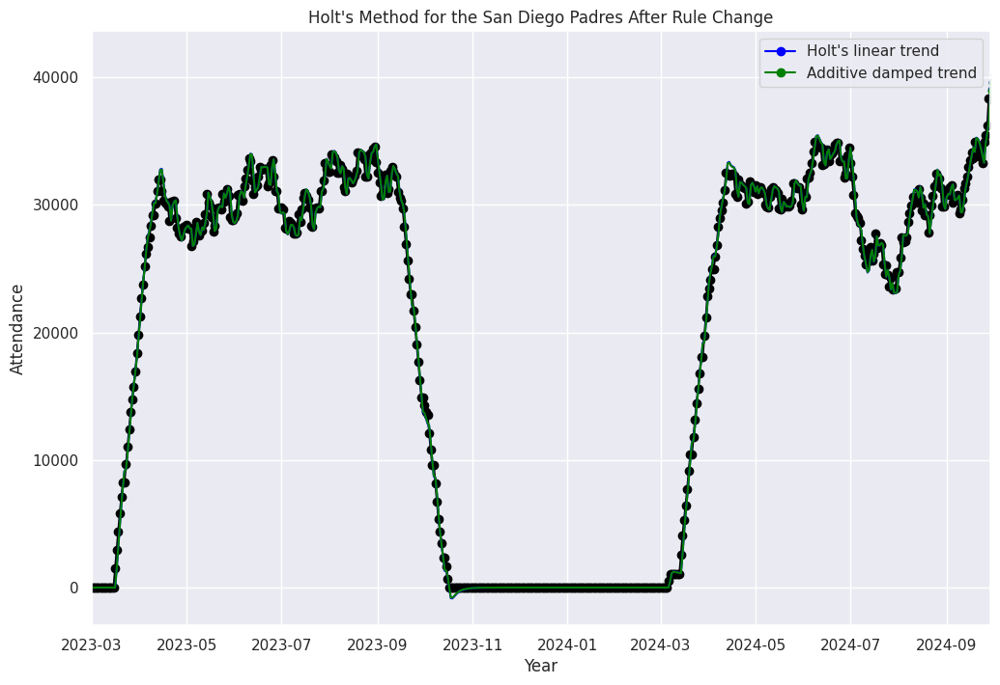

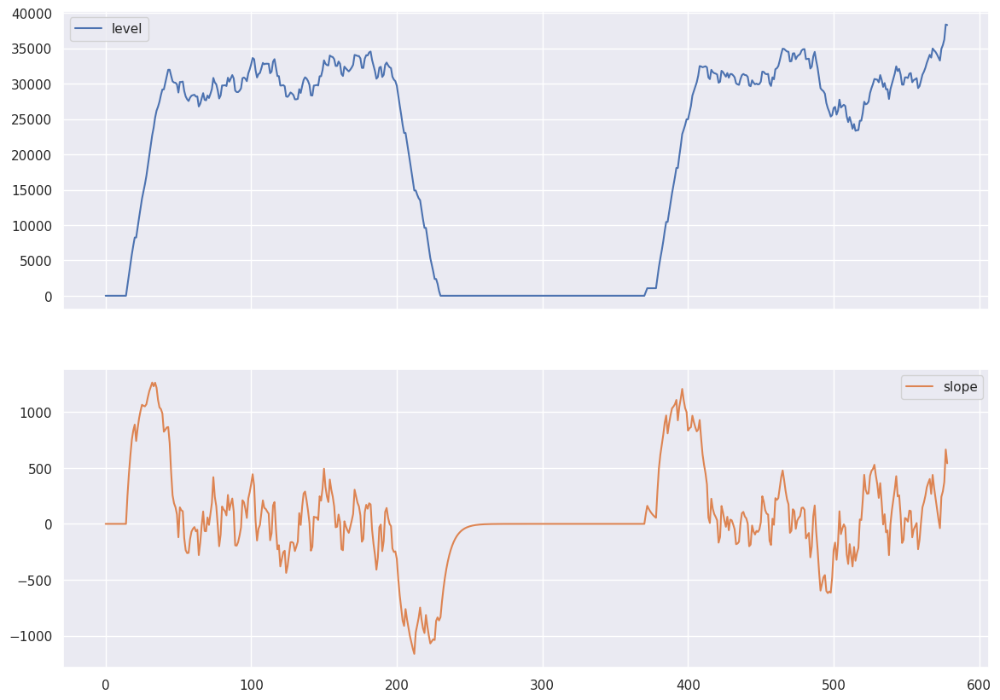

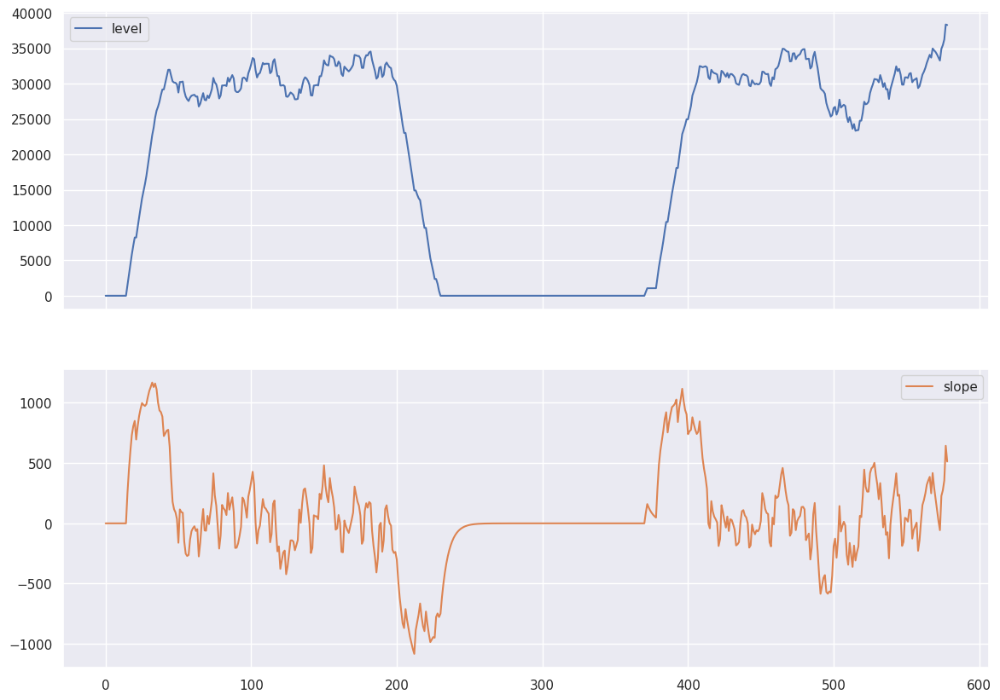

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


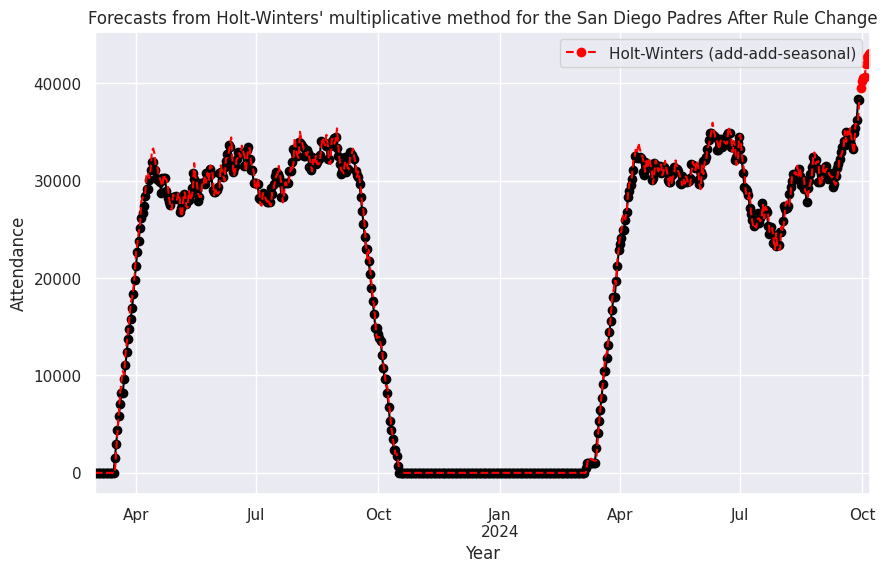

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds         184.116519   161.694444
Colorado Rockies        189.514749   159.975309
Pittsburgh Pirates      187.714391   159.348765
San Diego Padres        185.579646   163.802469
New York Mets                  NaN          NaN
New York Yankees               NaN          NaN
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
17340.109820999554
17994.01221001221
18801.25163398693
21208.949708822758
Average Change in Yearly Attendance before rul

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


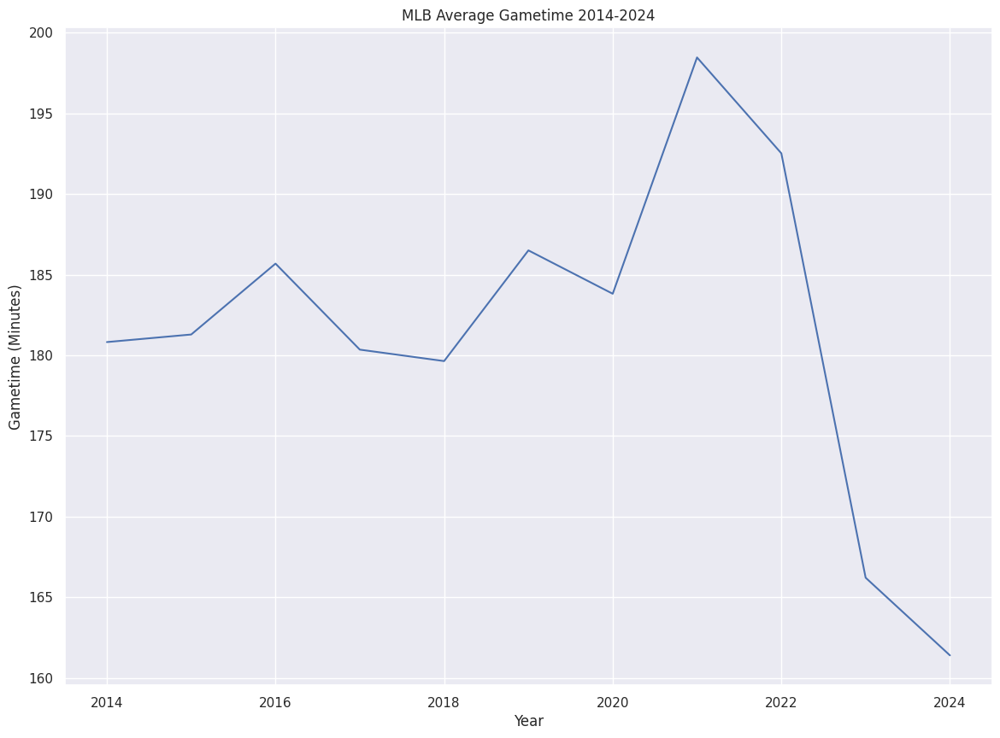

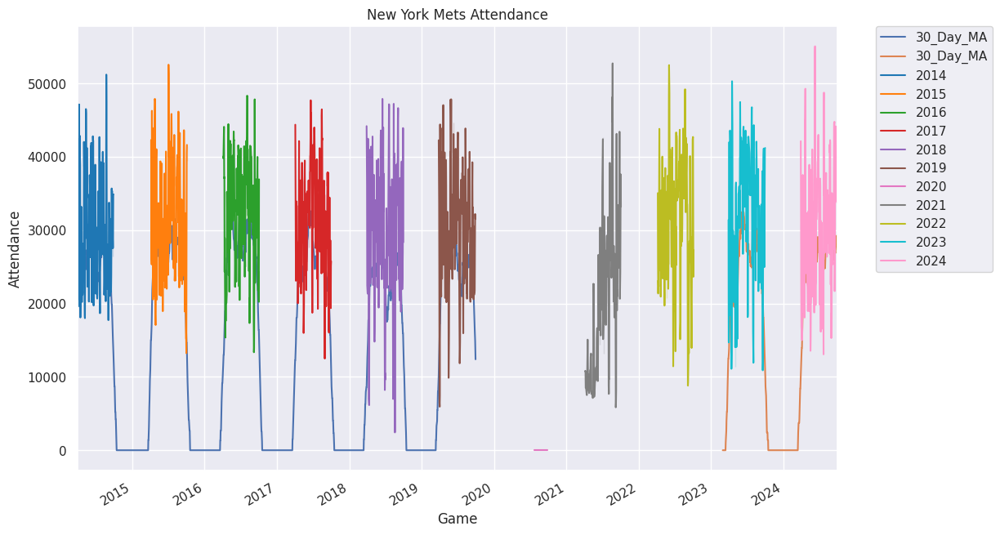

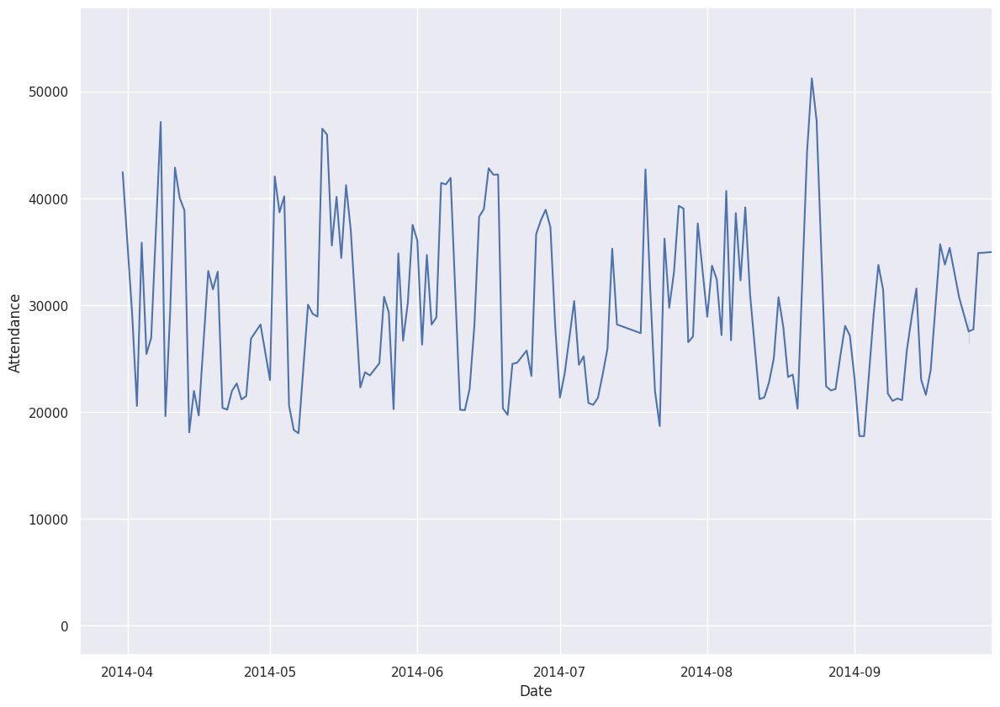

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


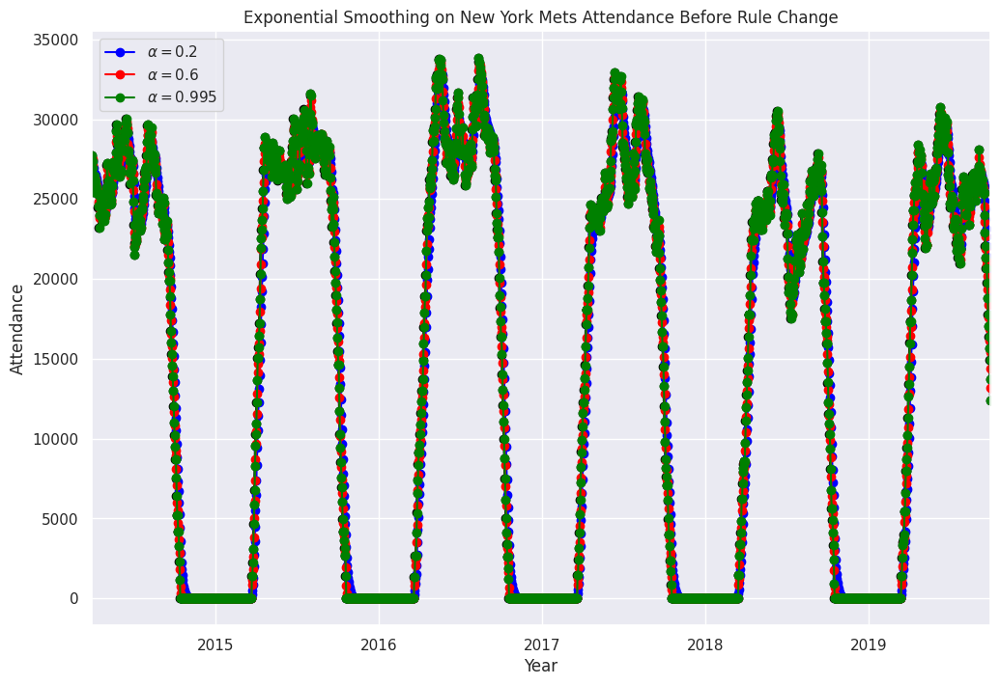

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

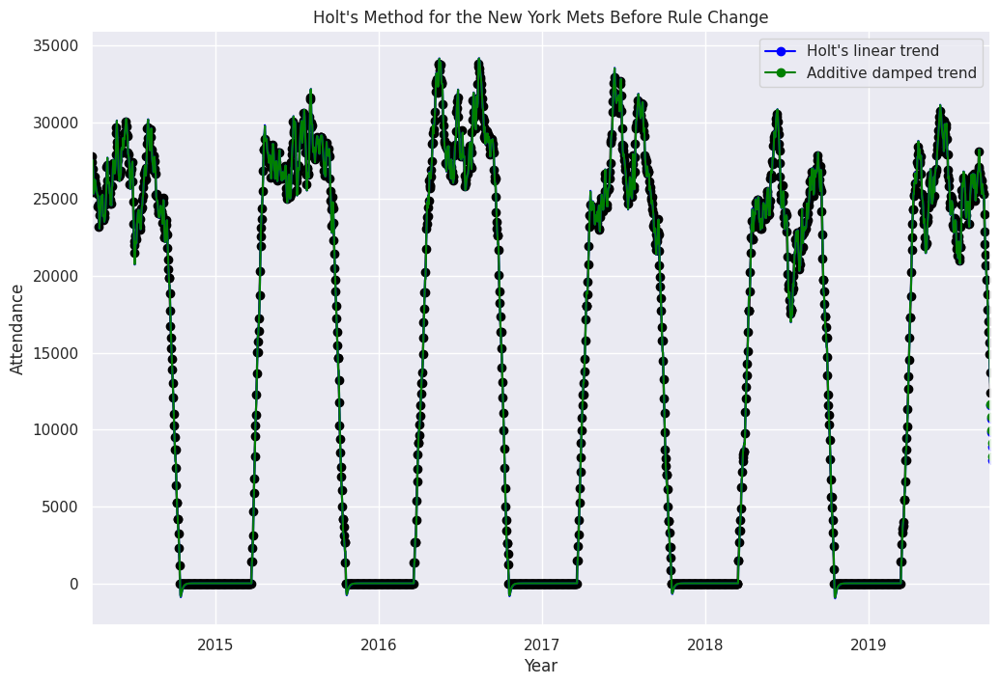

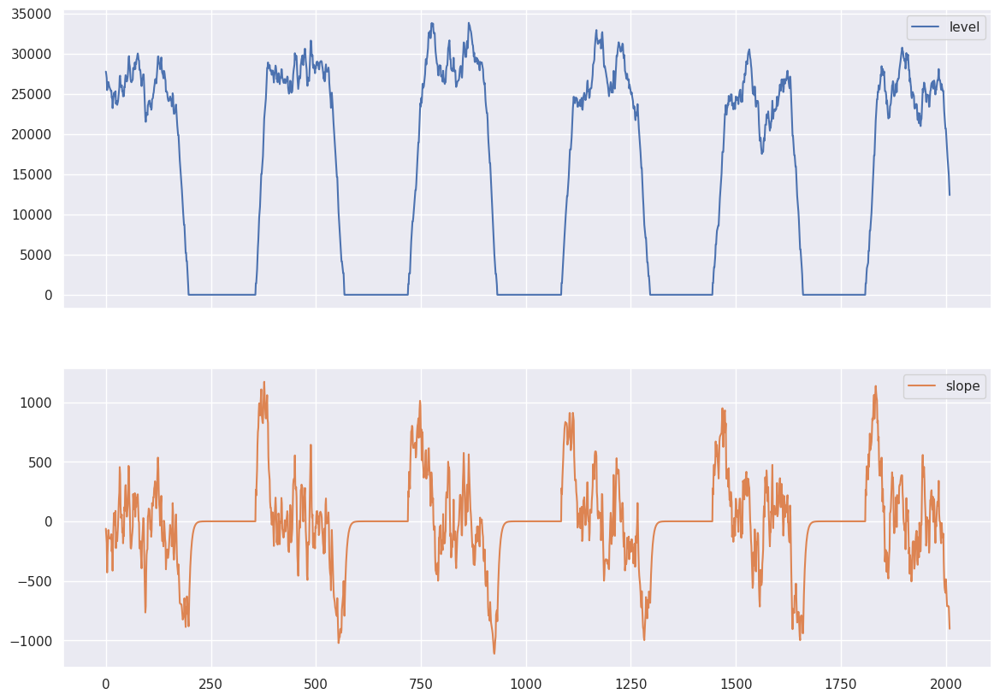

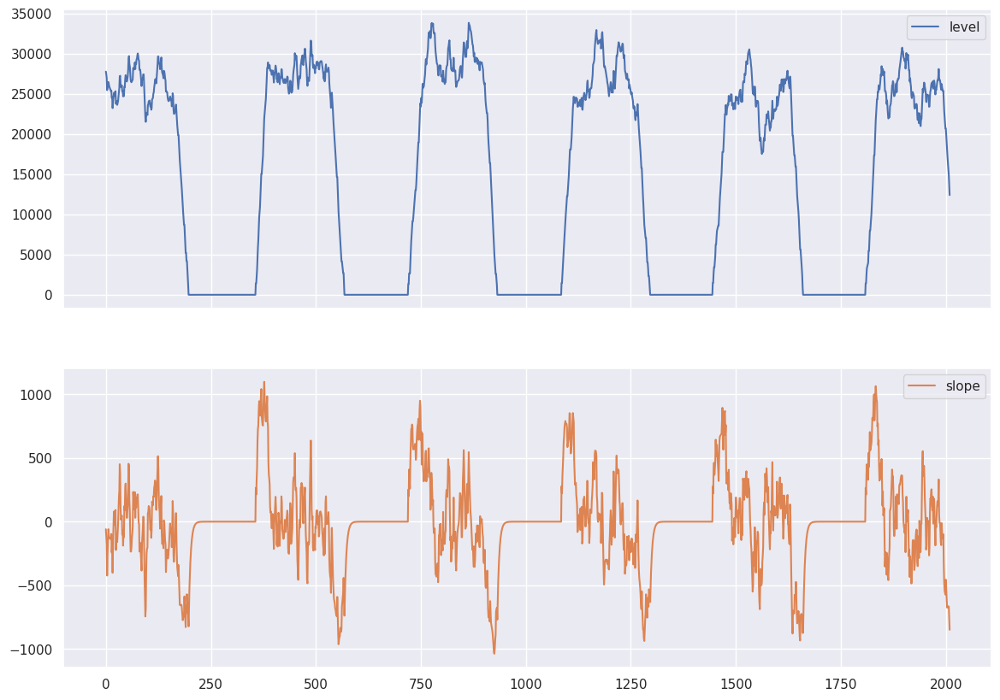

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


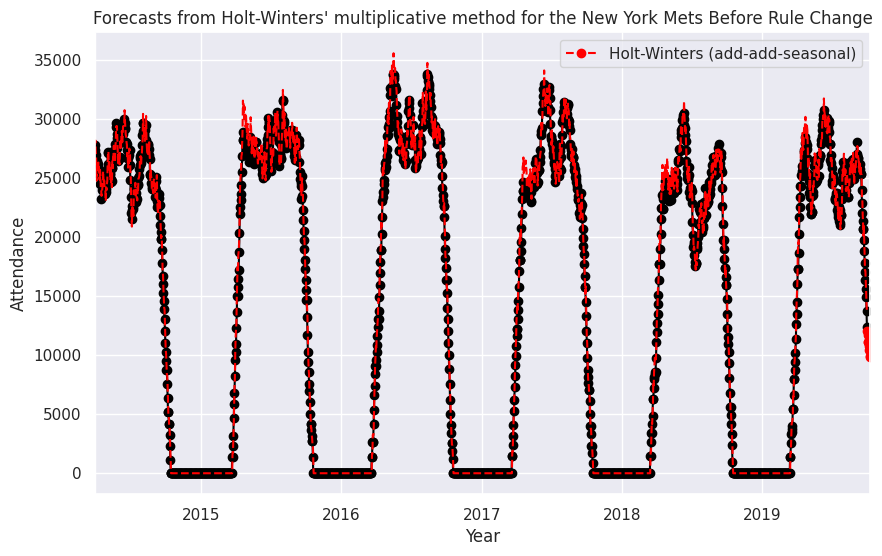

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


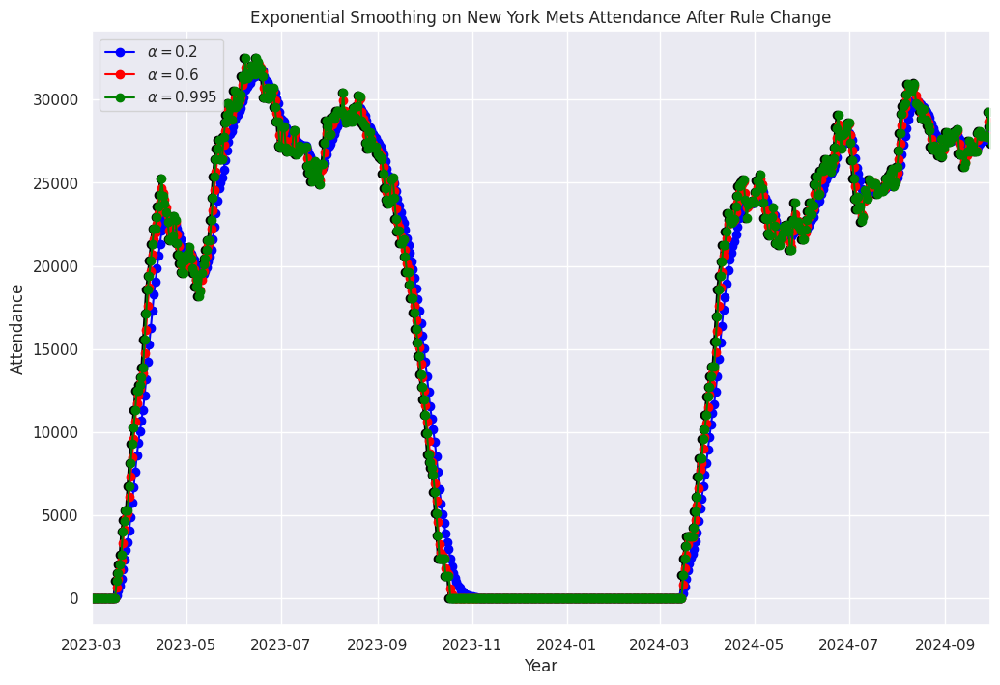

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

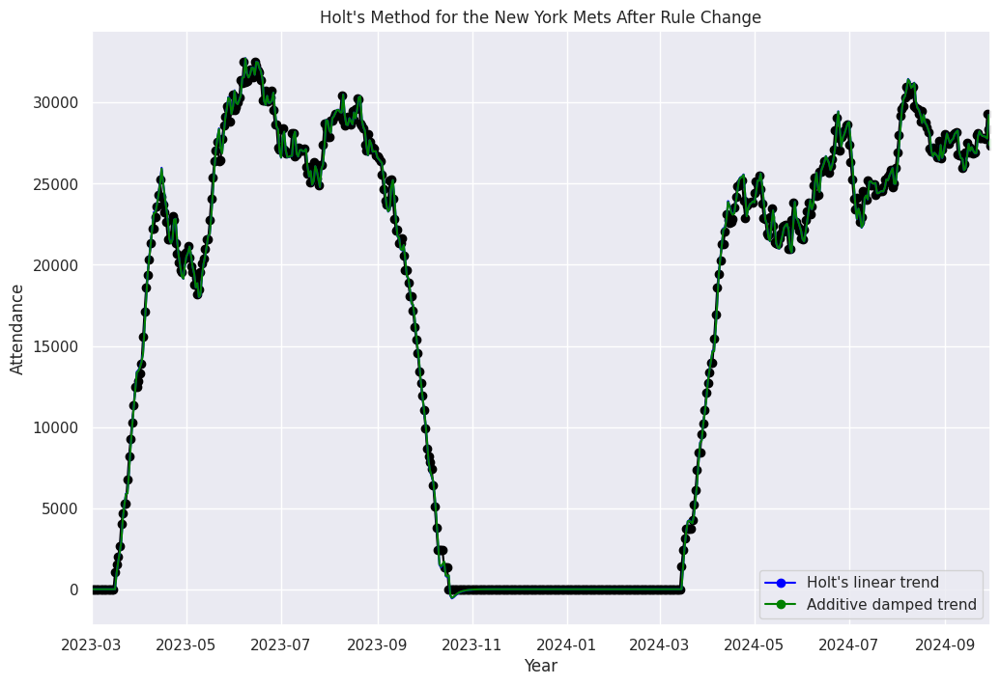

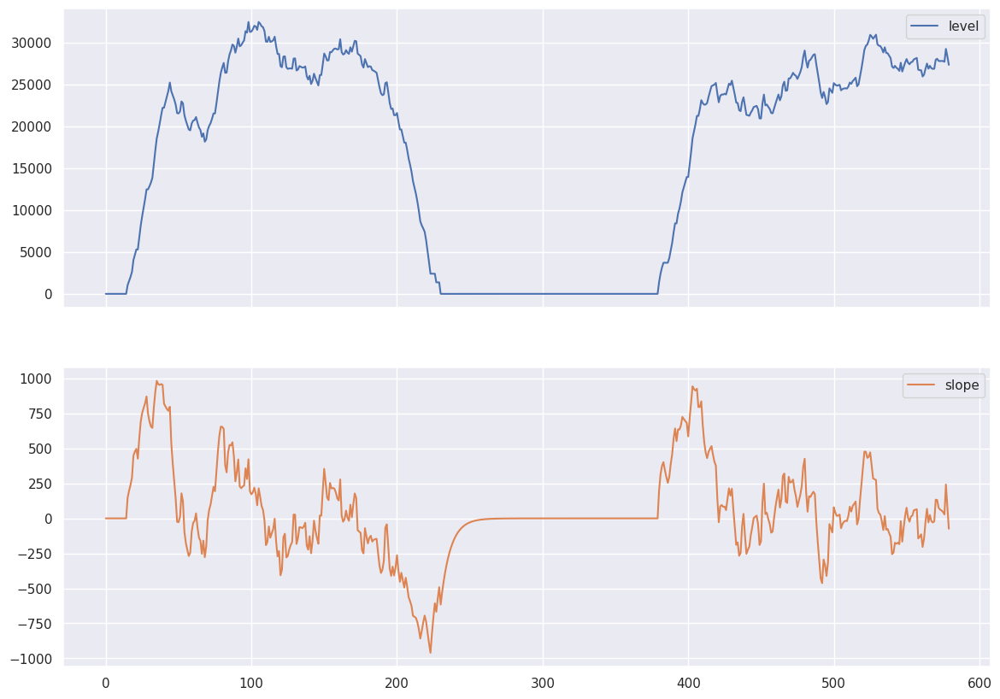

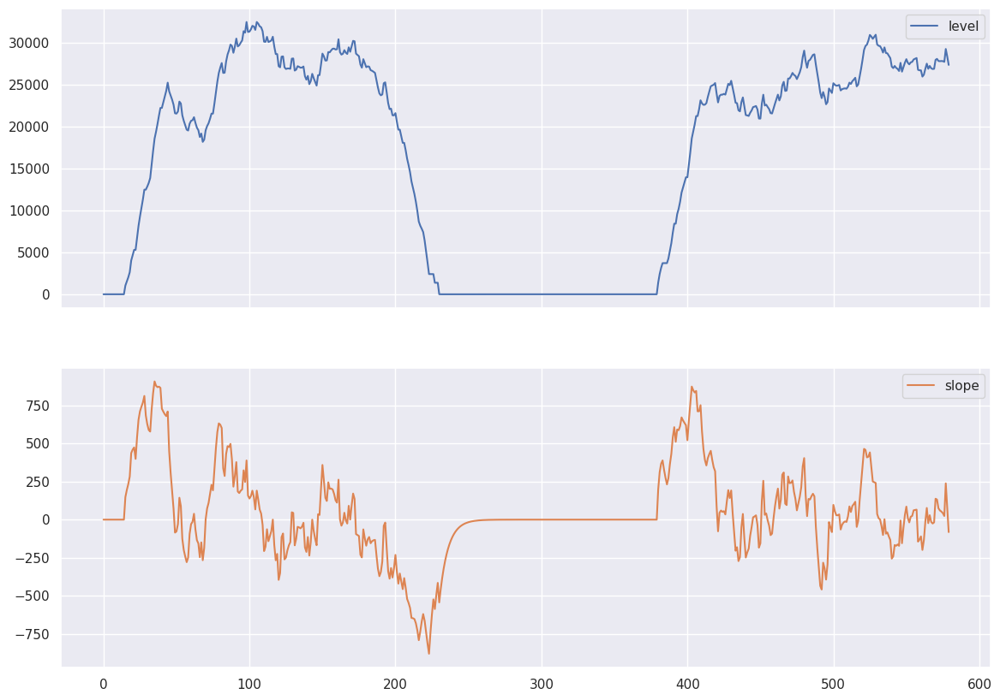

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


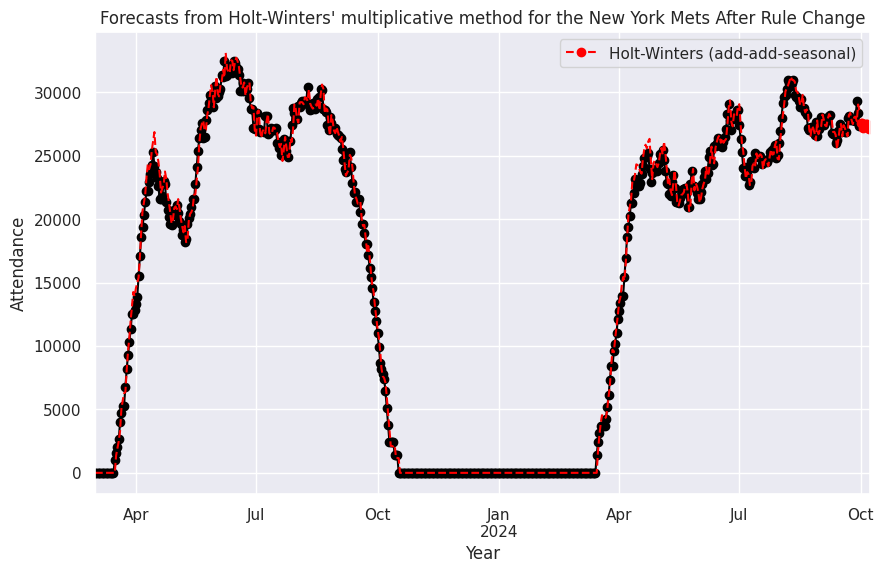

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds         184.116519   161.694444
Colorado Rockies        189.514749   159.975309
Pittsburgh Pirates      187.714391   159.348765
San Diego Padres        185.579646   163.802469
New York Mets           186.075221   164.271605
New York Yankees               NaN          NaN
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
17087.585902069197
17086.473137973135
15756.320261437908
17157.89939620494
Average Change in Yearly Attendance before ru

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
<ipython-input-4-1eb531660723>:8: UserWarning: The palette list has more values (11) than needed (10), which may not be intended.
  sns.lineplot(data = df, x = "Date", y = "Attendance", hue = "Year", palette = custom_palette).set(xlabel = "Game", ylabel = "Attendance", title = f"{team_name} Attendance");
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


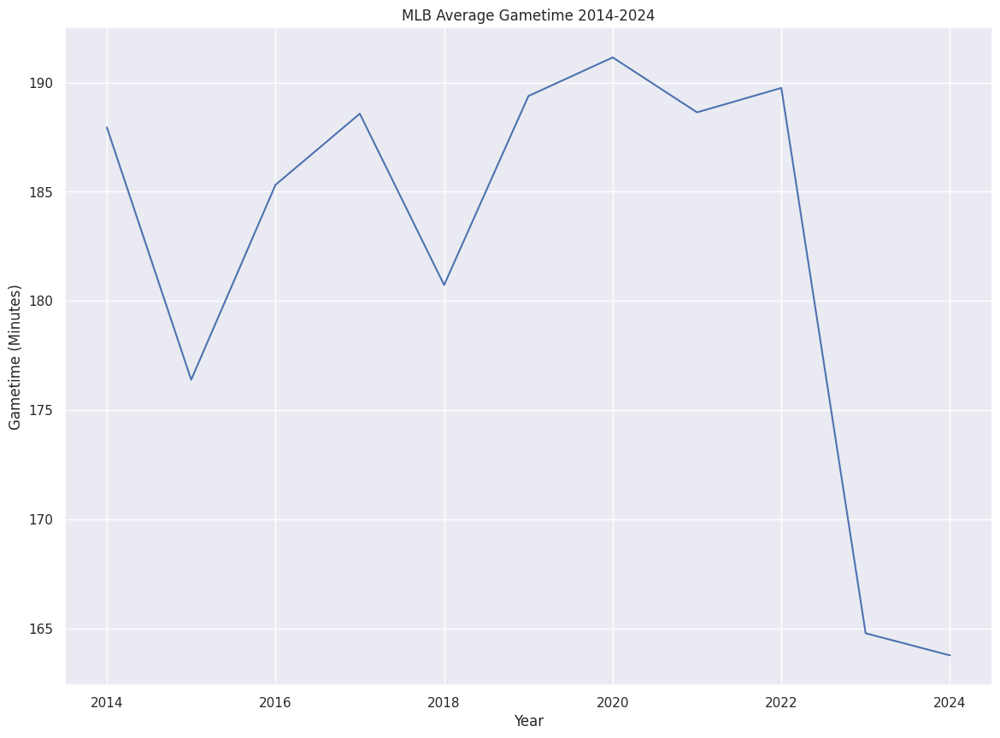

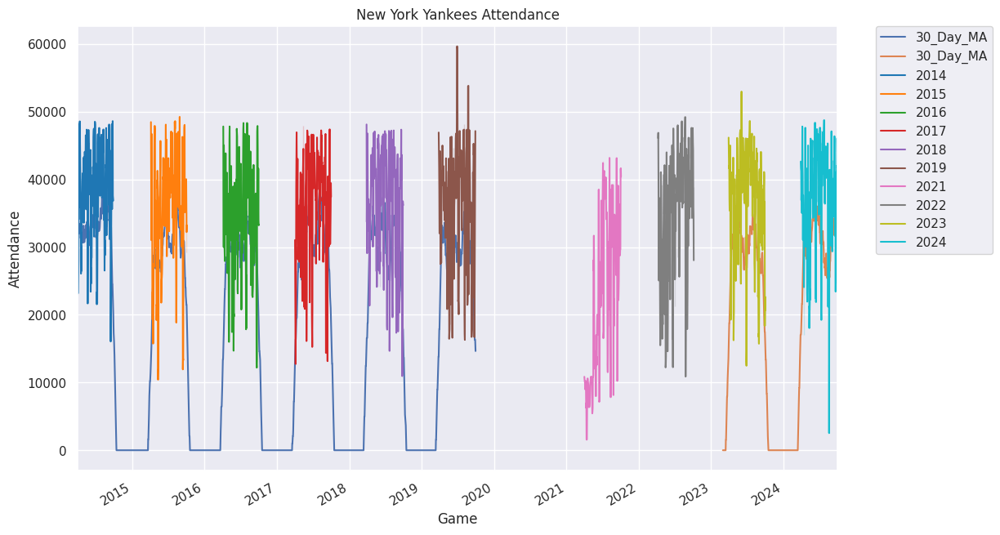

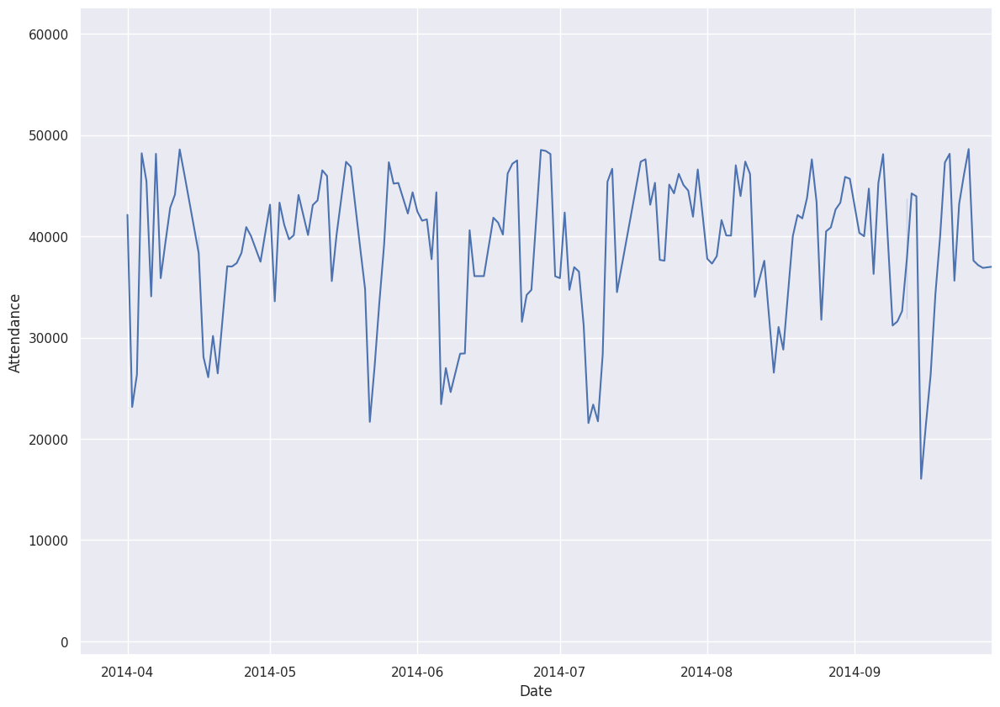

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


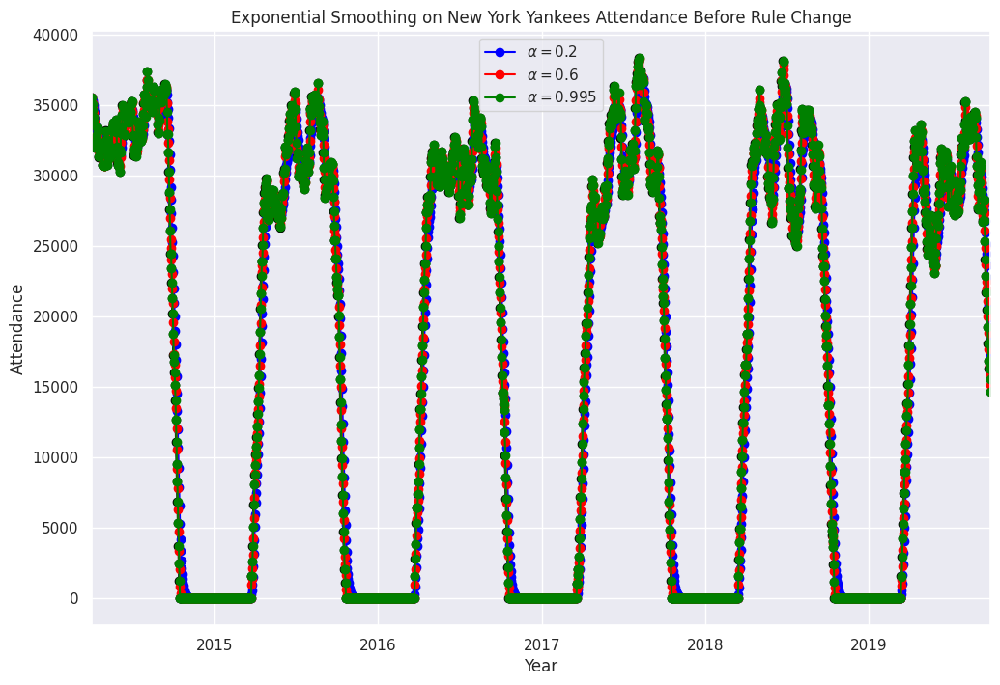

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

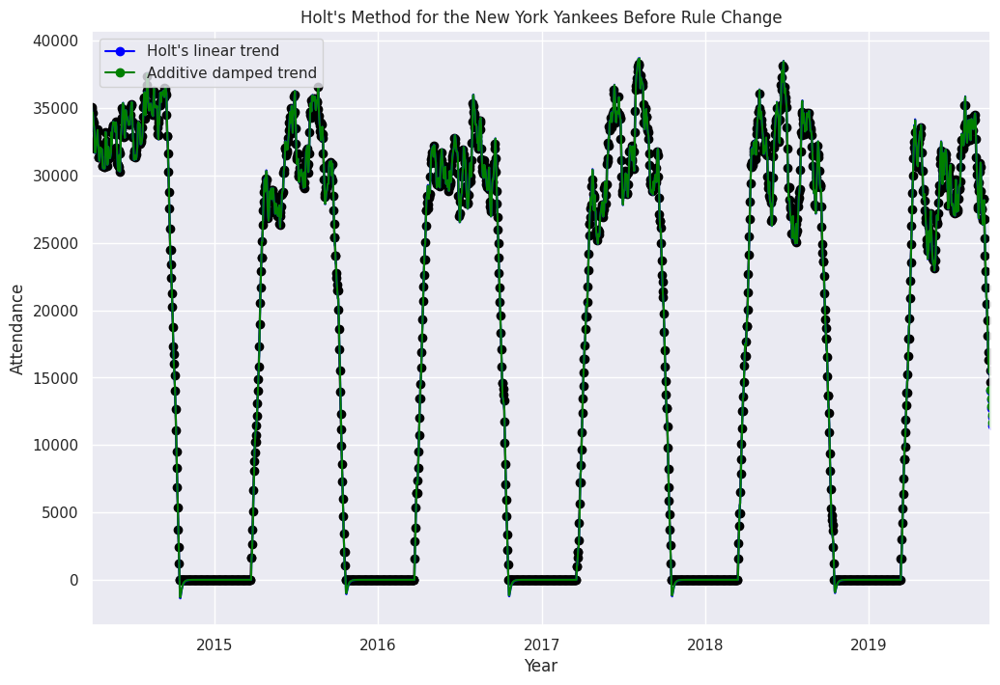

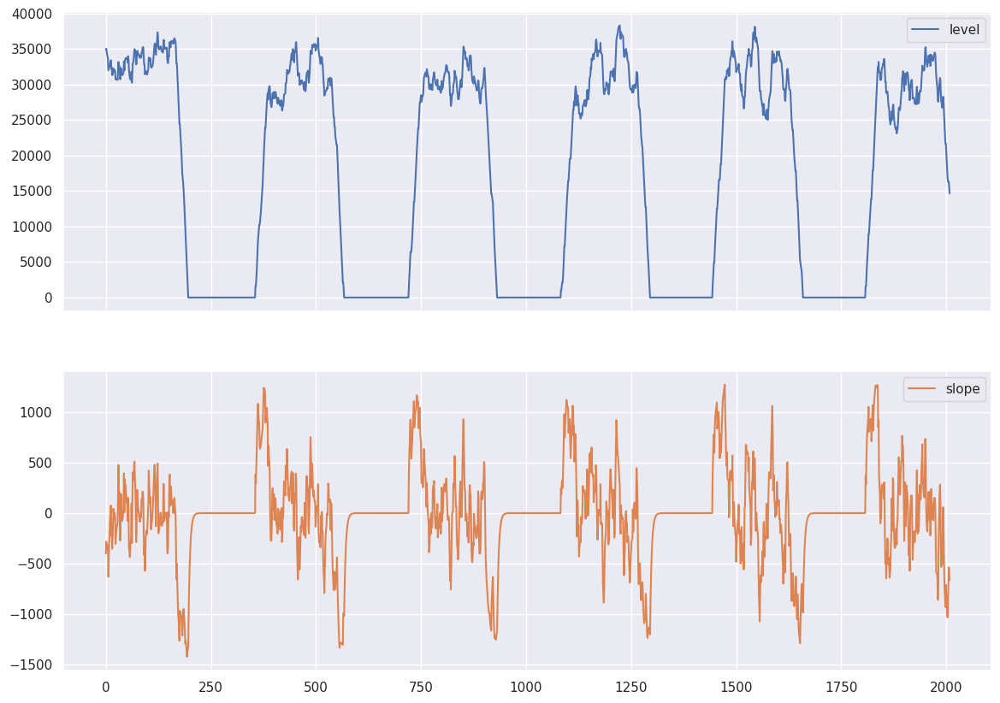

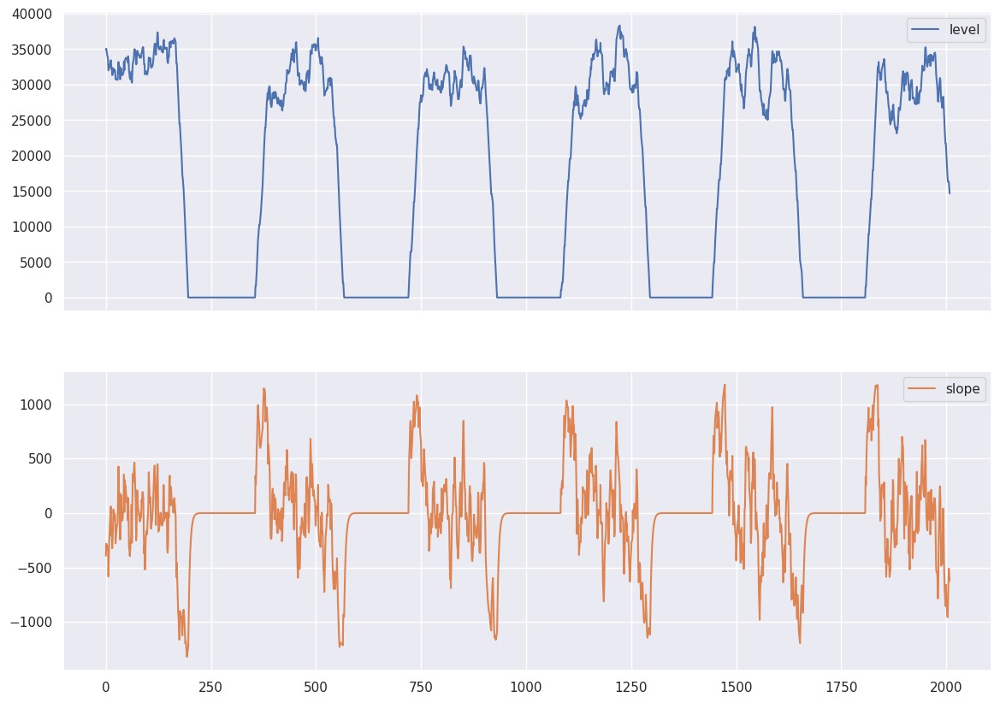

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


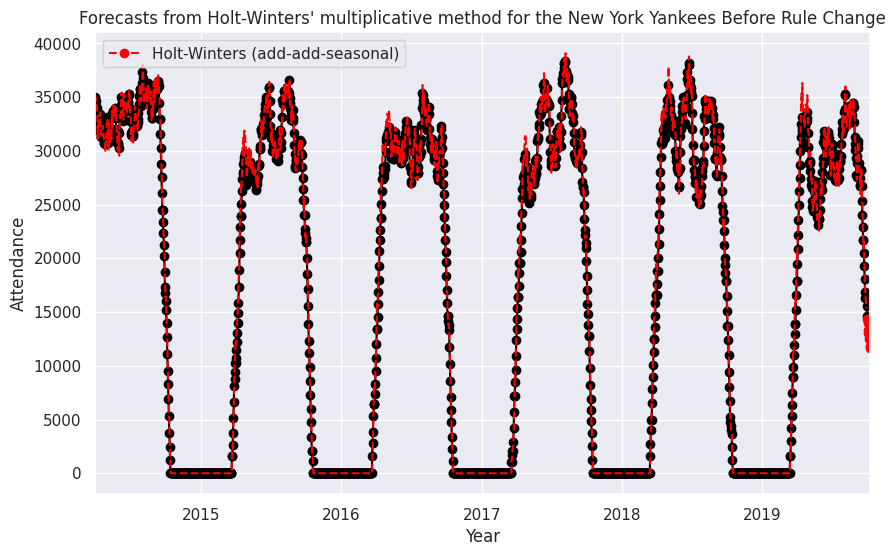

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


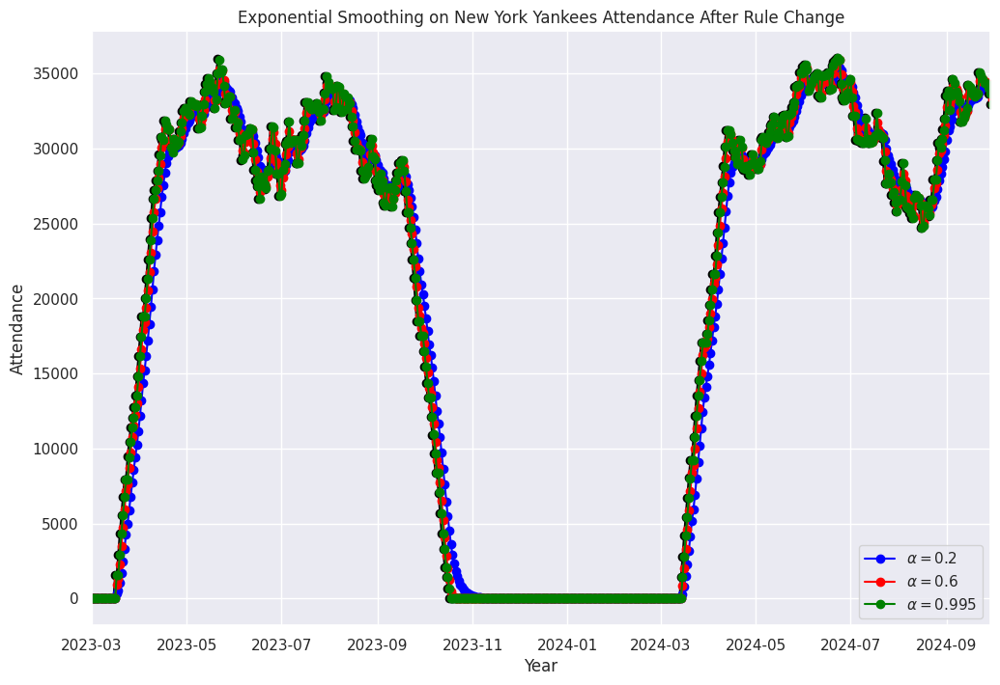

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

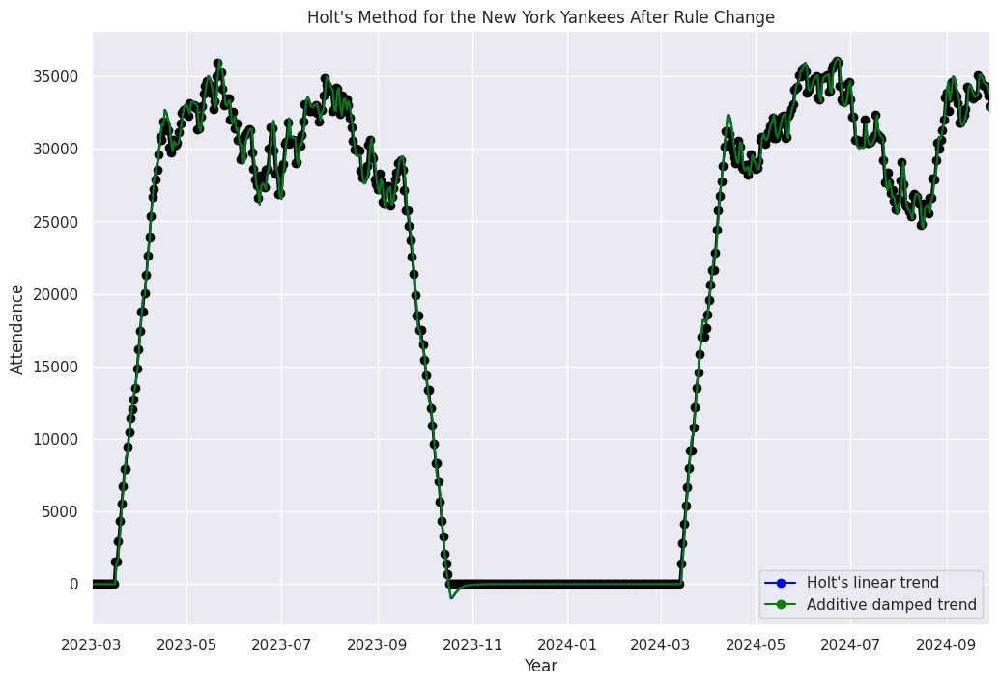

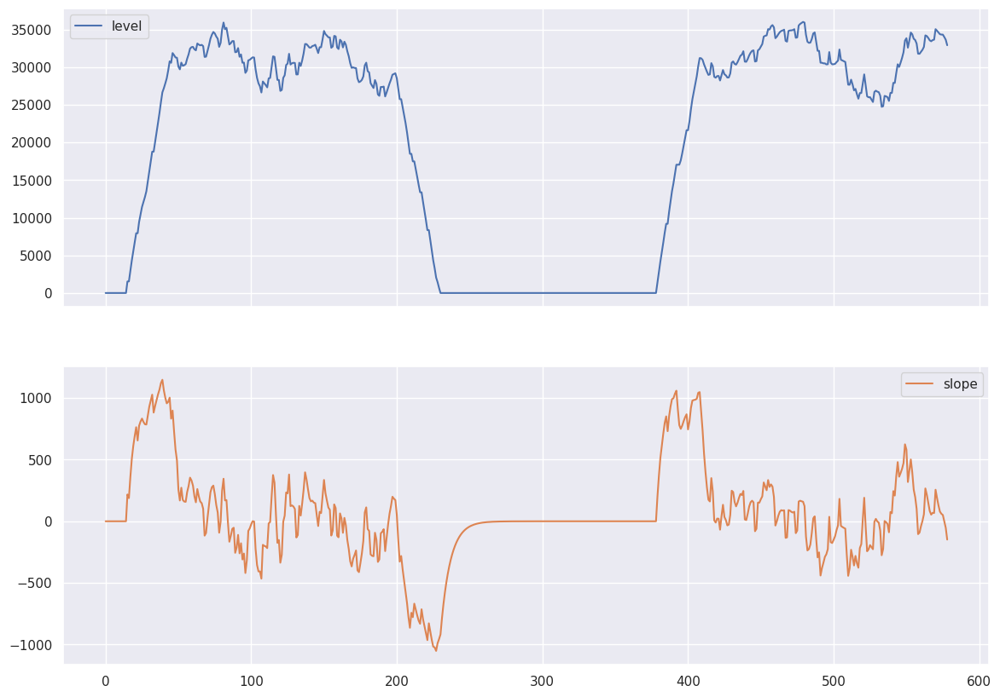

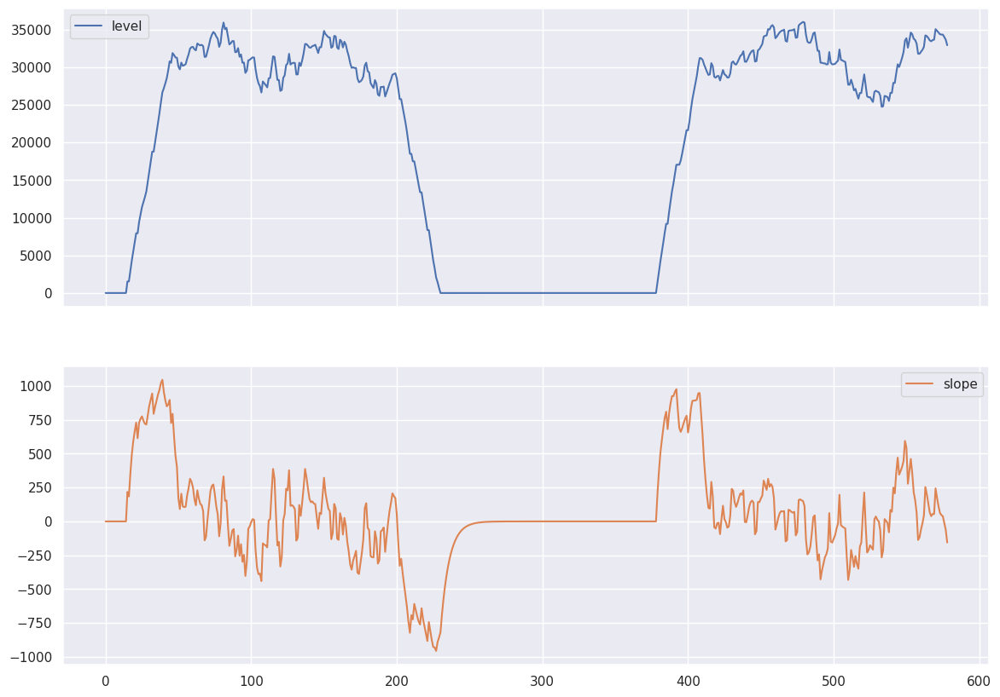

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


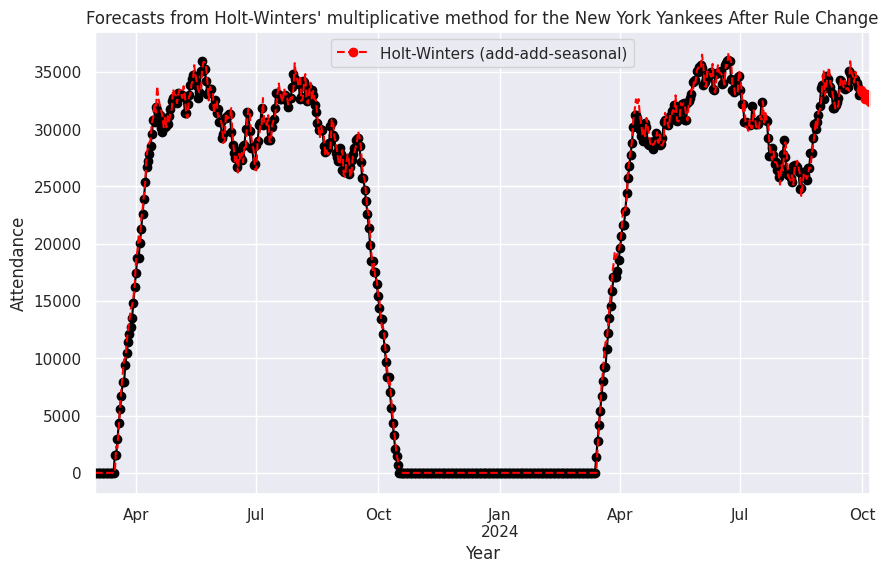

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds         184.116519   161.694444
Colorado Rockies        189.514749   159.975309
Pittsburgh Pirates      187.714391   159.348765
San Diego Padres        185.579646   163.802469
New York Mets           186.075221   164.271605
New York Yankees        191.371142   165.432099
Los Angeles Dodgers            NaN          NaN
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
22360.643763877615
19812.203907203908
18690.679738562092
21291.22520807482
Average Change in Yearly Attendance before ru

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
<ipython-input-4-1eb531660723>:8: UserWarning: The palette list has more values (11) than needed (10), which may not be intended.
  sns.lineplot(data = df, x = "Date", y = "Attendance", hue = "Year", palette = custom_palette).set(xlabel = "Game", ylabel = "Attendance", title = f"{team_name} Attendance");
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


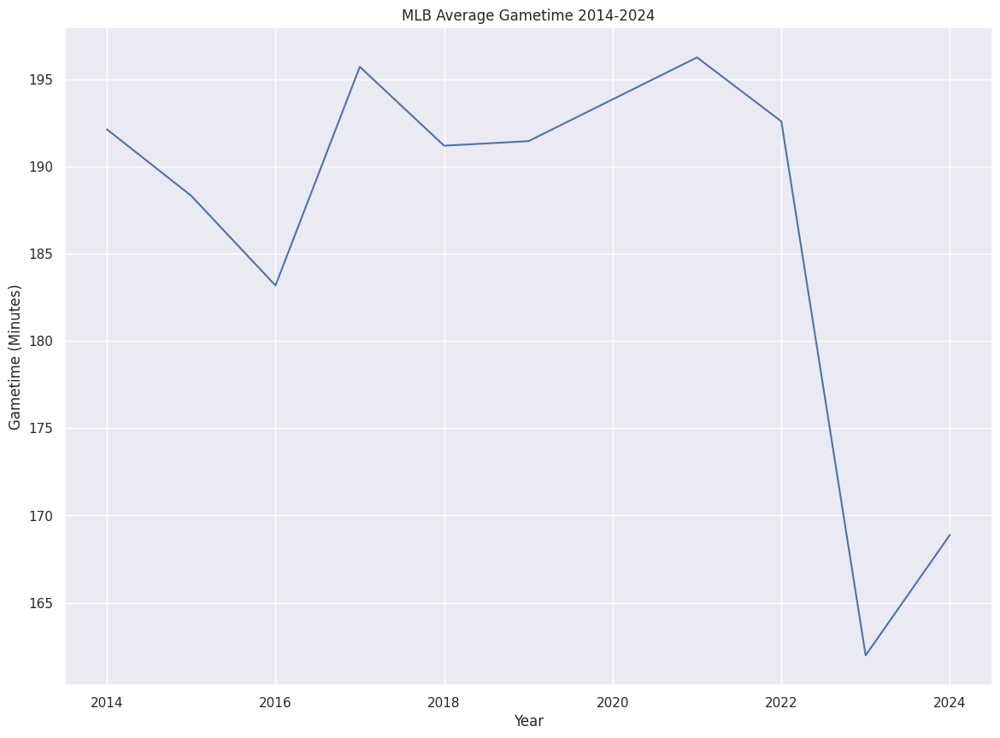

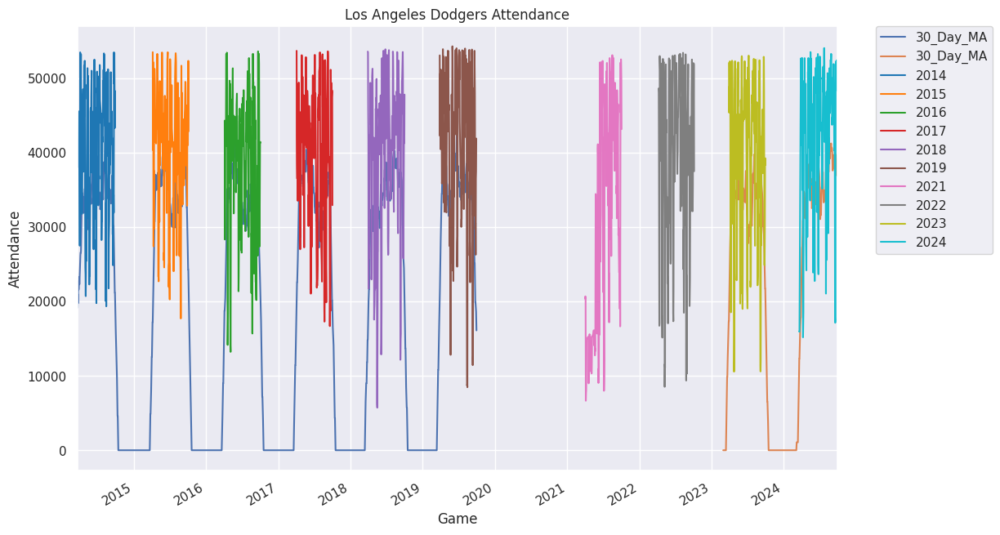

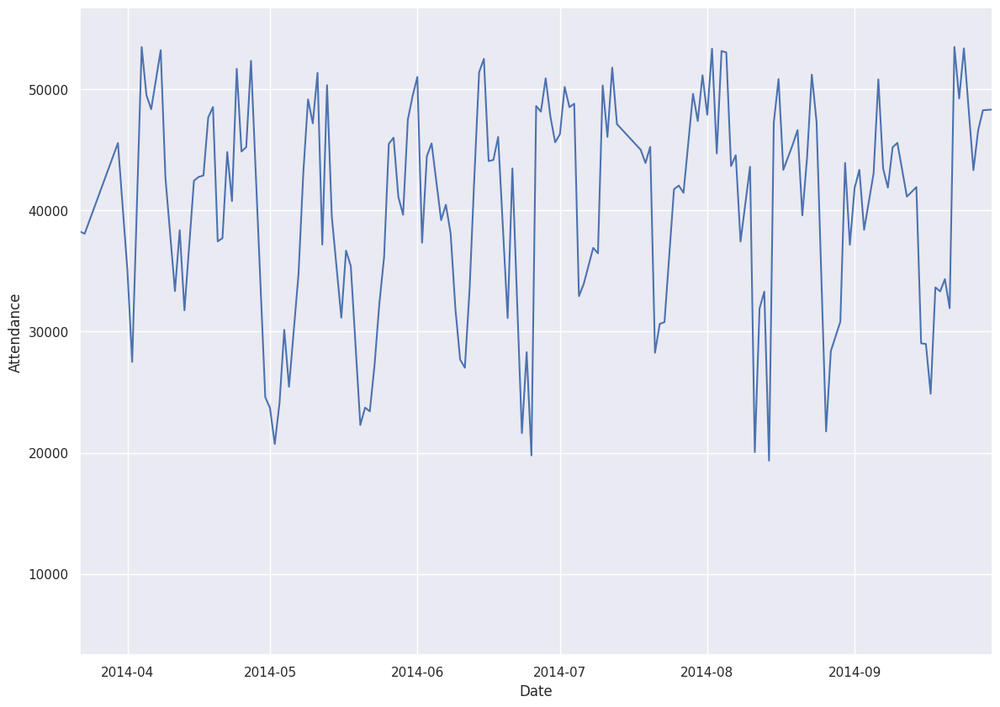

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


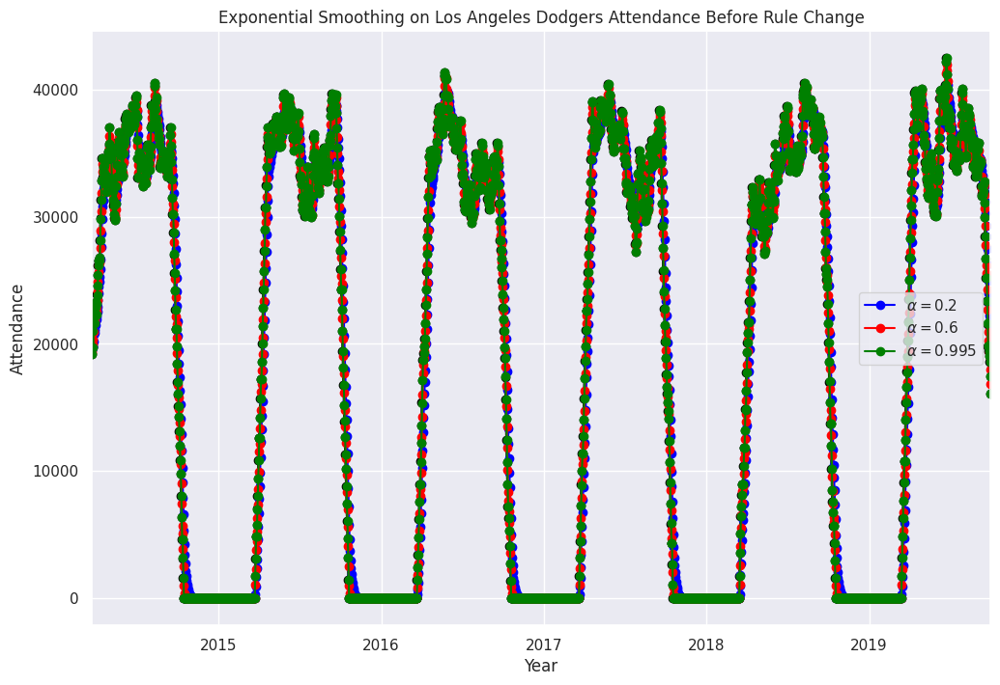

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

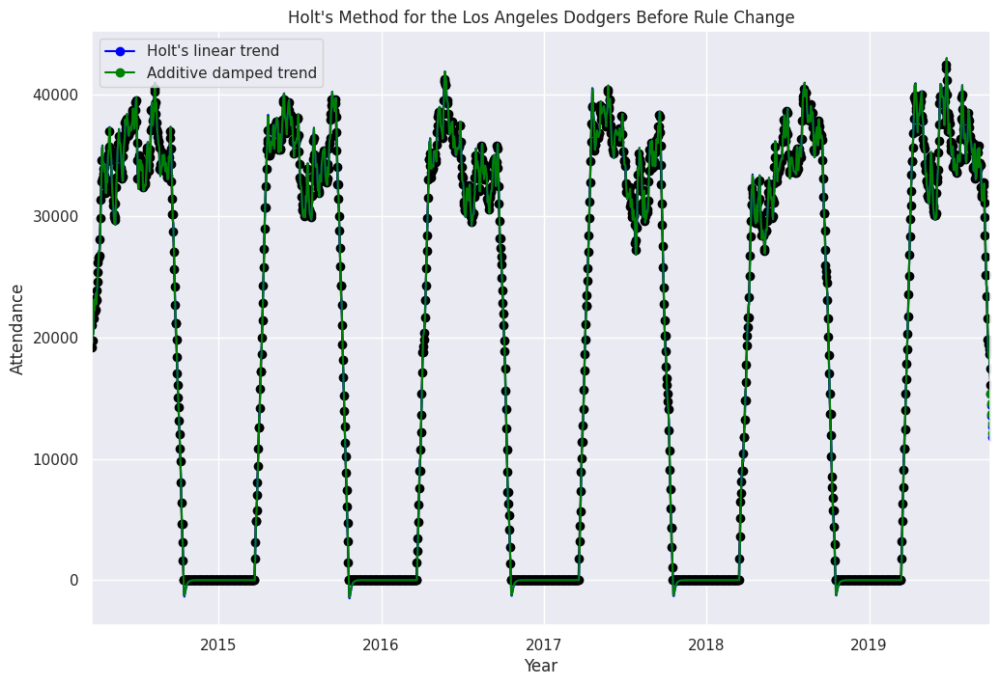

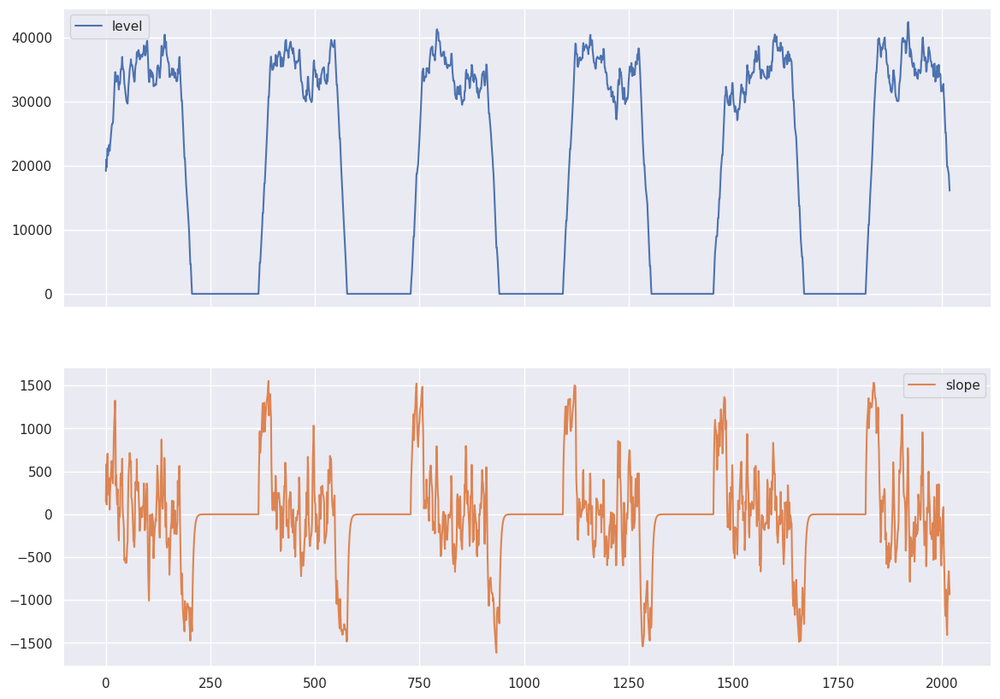

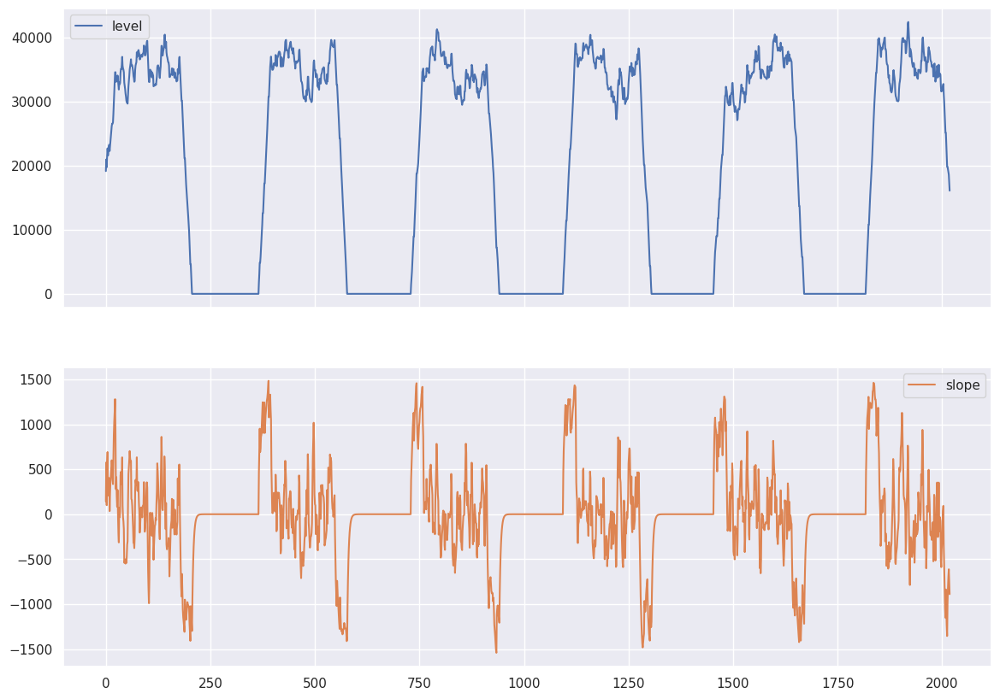

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


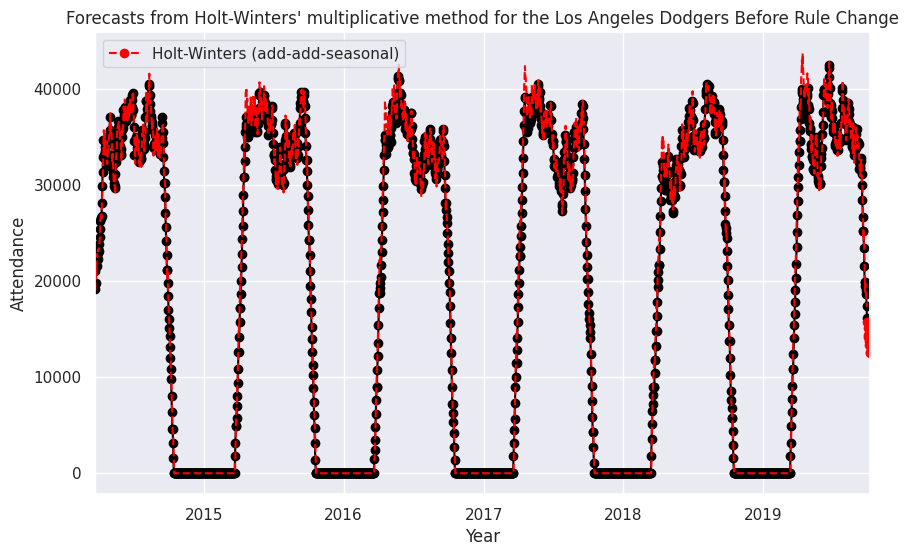

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


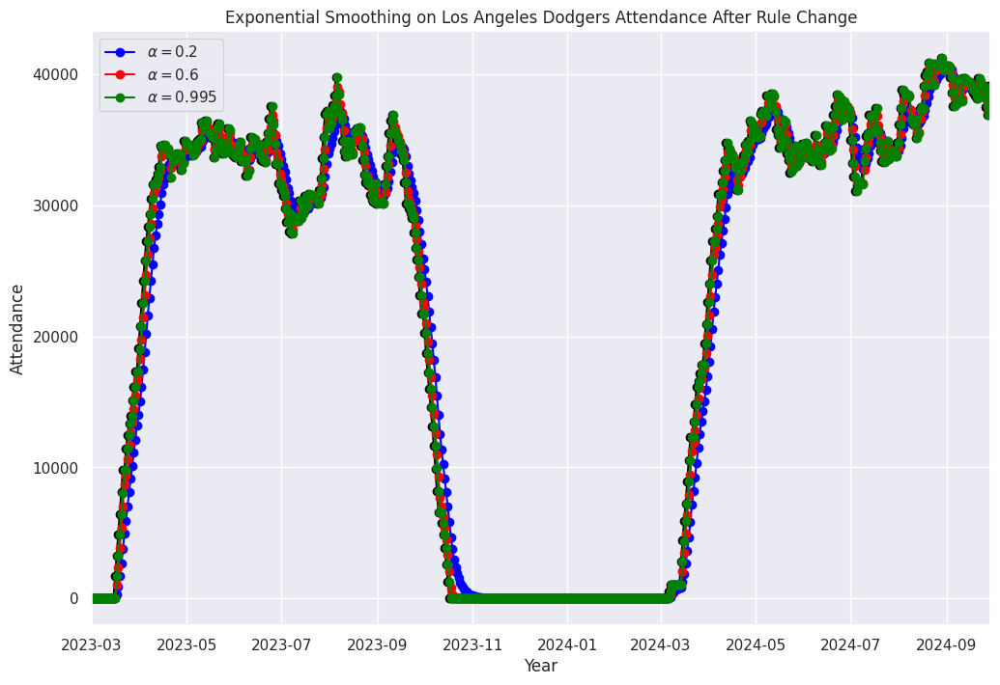

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

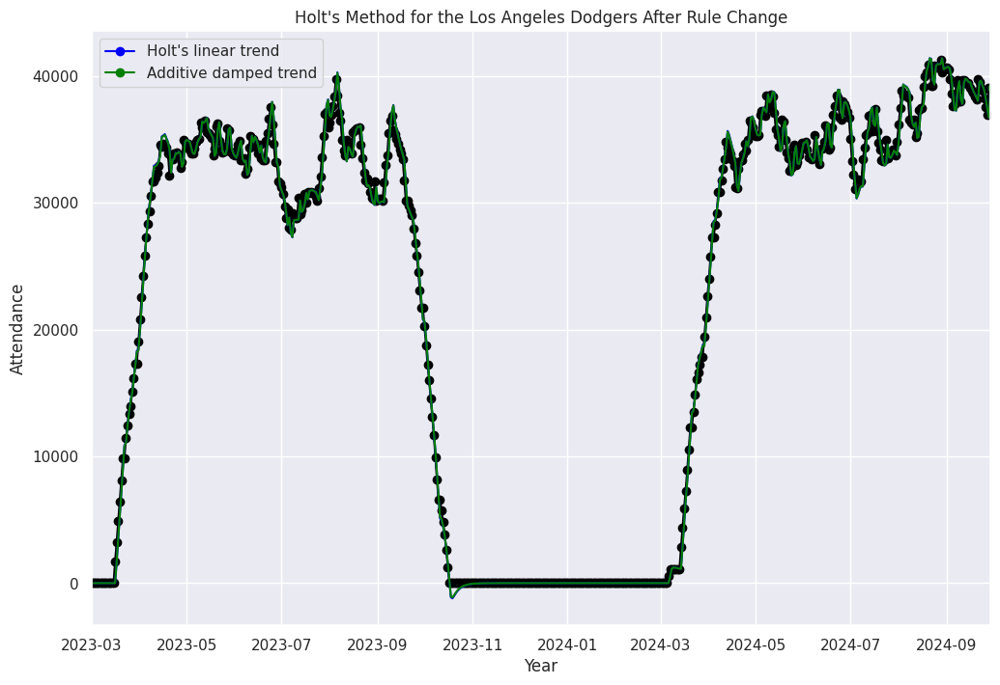

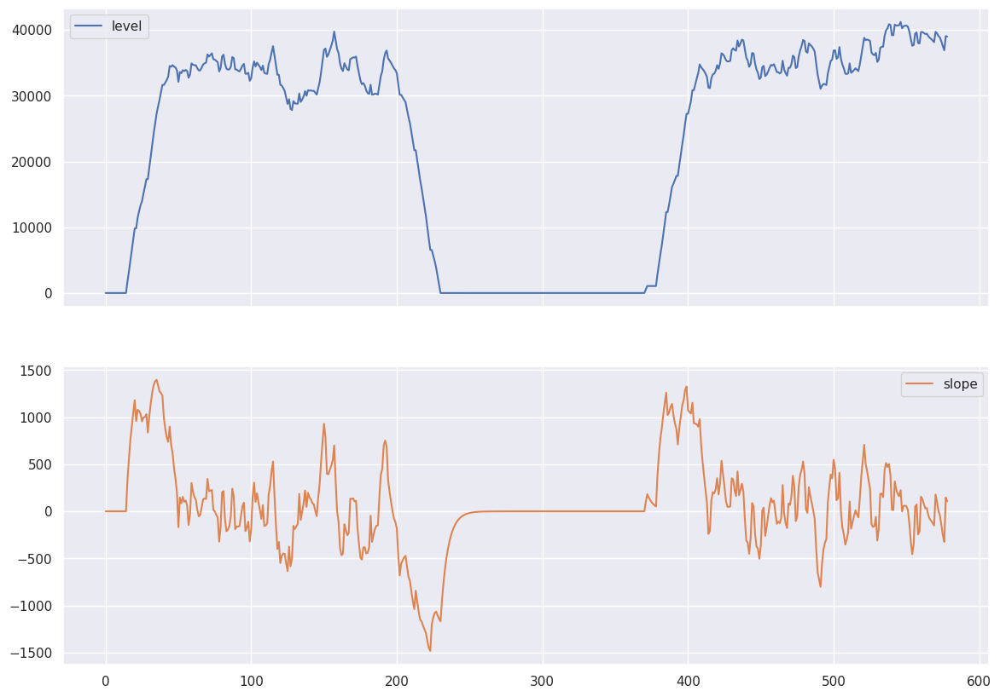

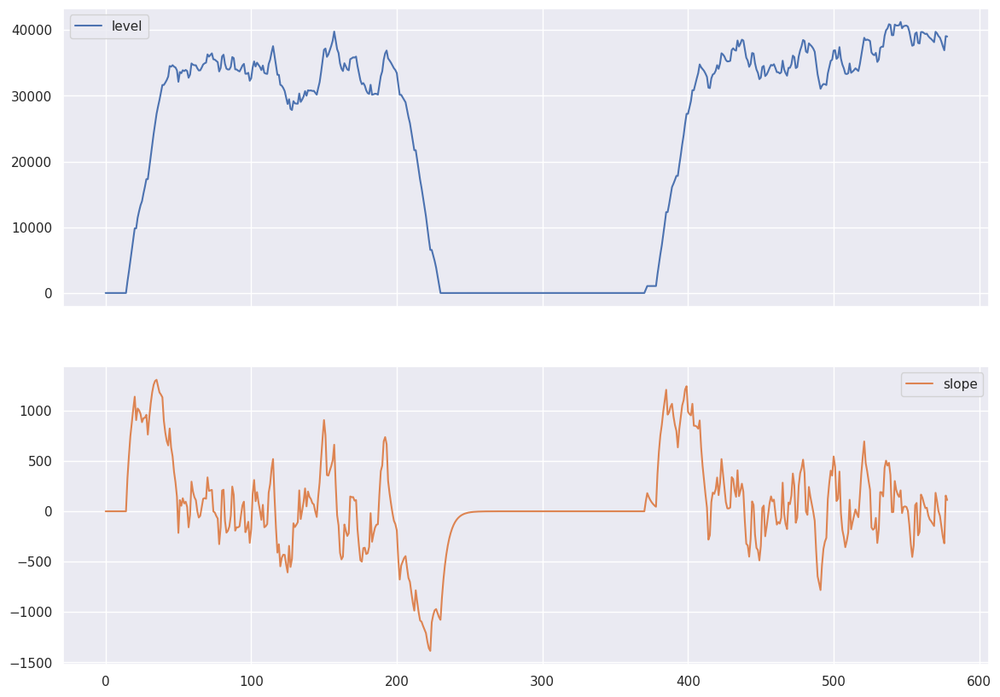

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


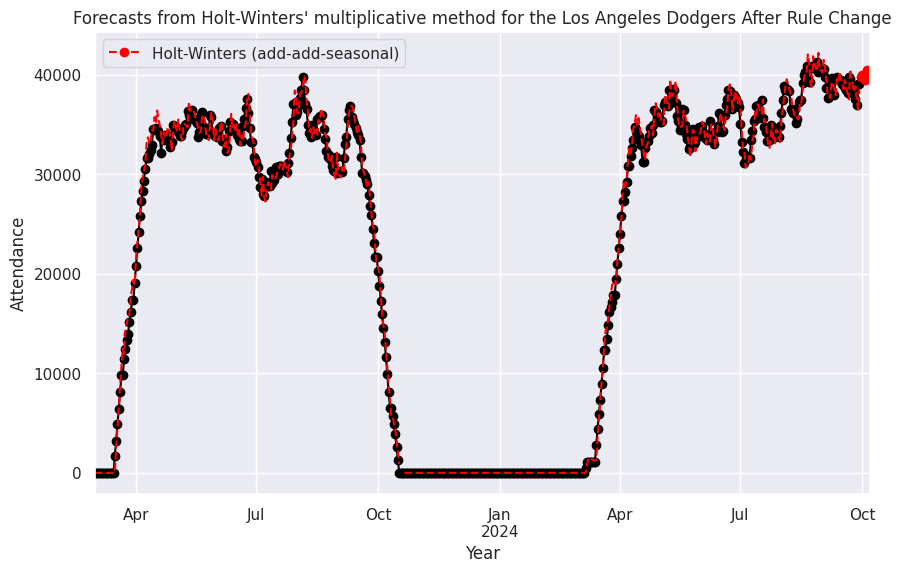

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds         184.116519   161.694444
Colorado Rockies        189.514749   159.975309
Pittsburgh Pirates      187.714391   159.348765
San Diego Padres        185.579646   163.802469
New York Mets           186.075221   164.271605
New York Yankees        191.371142   165.432099
Los Angeles Dodgers     191.195837   161.790123
Chicago Cubs                   NaN          NaN
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
22921.92641084705
24045.717216117217
20727.725490196077
24796.09568977827
Average Change in Yearly Attendance before rul

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


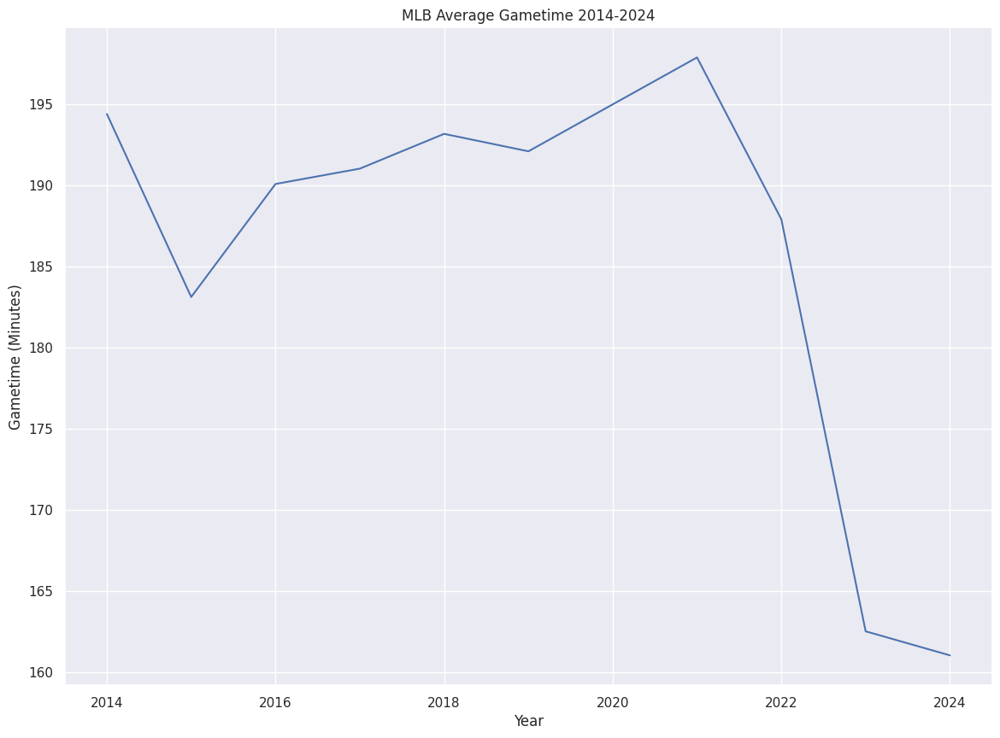

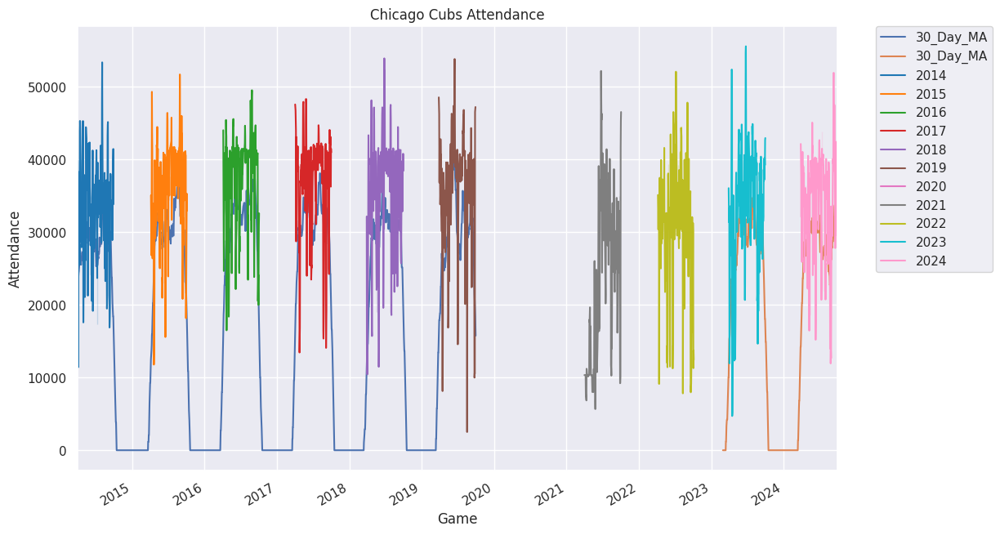

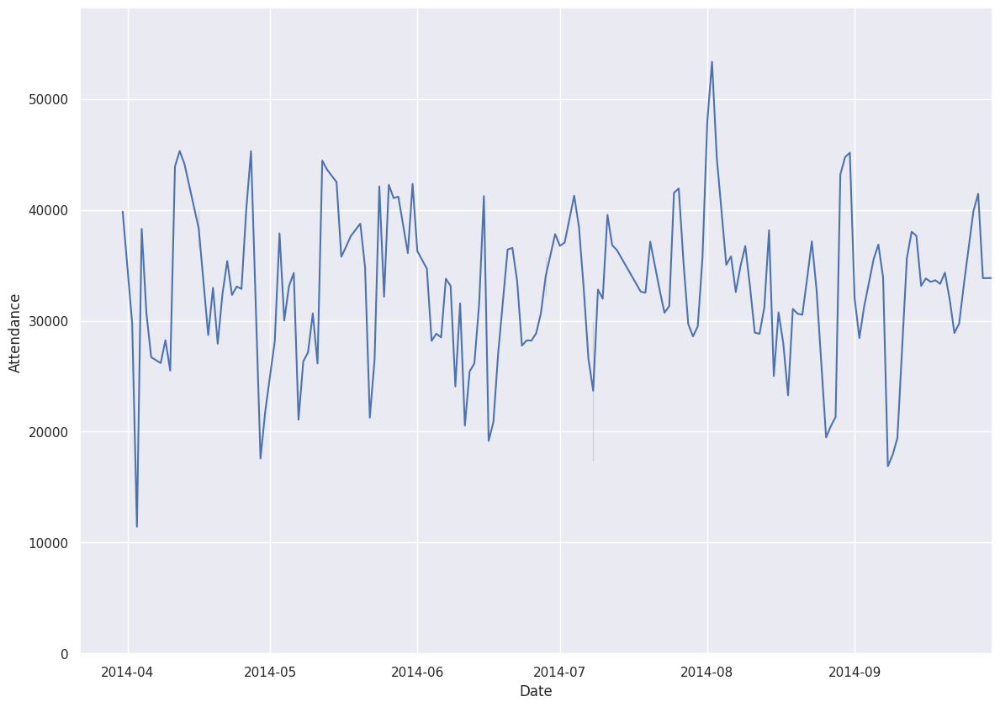

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


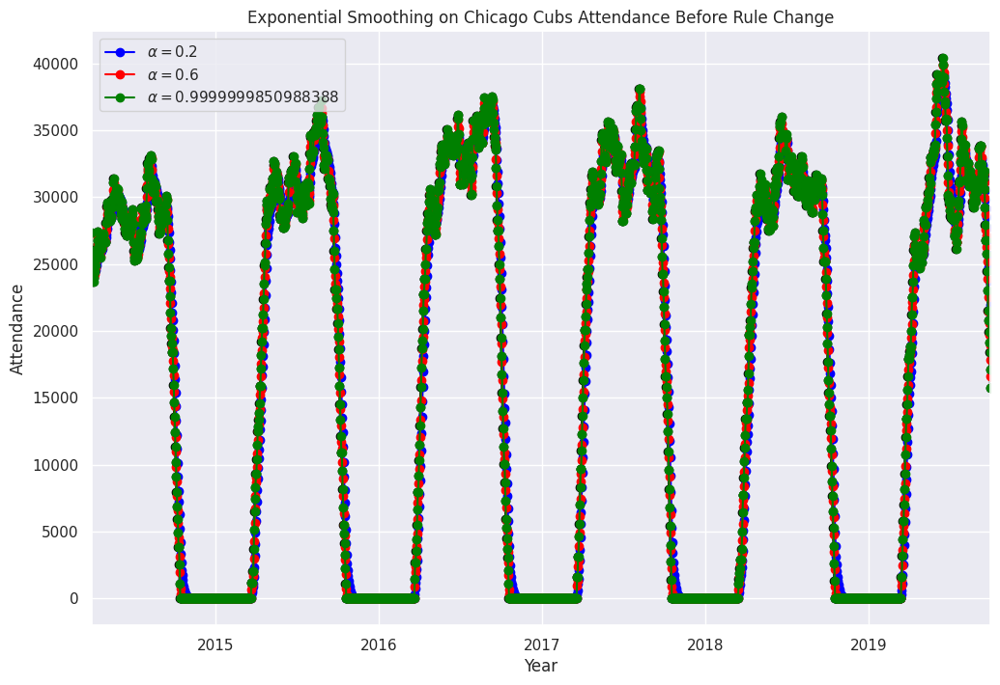

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

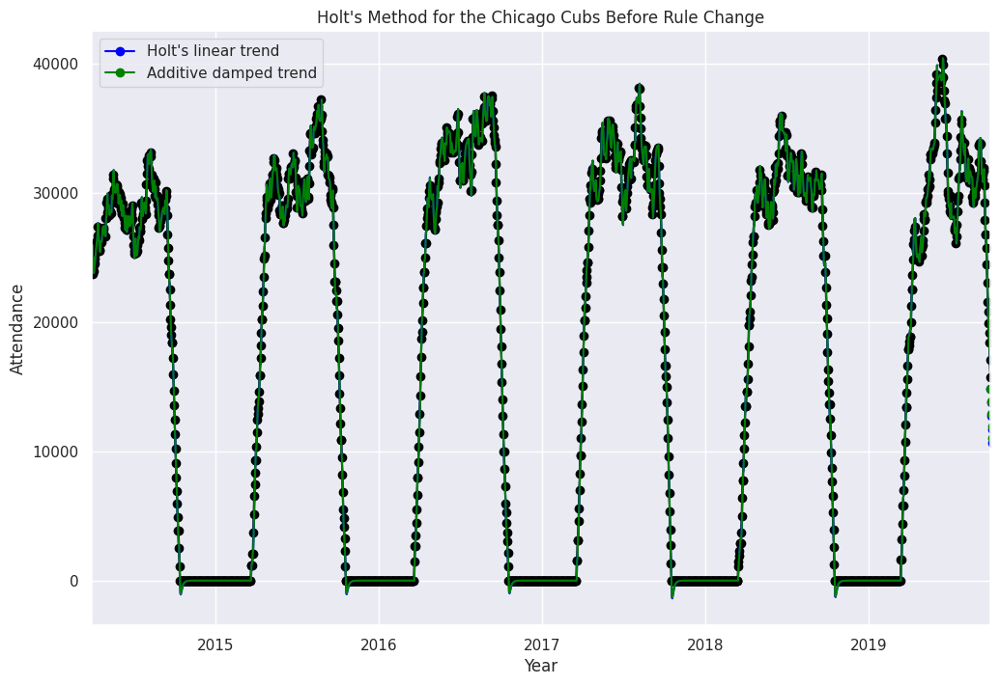

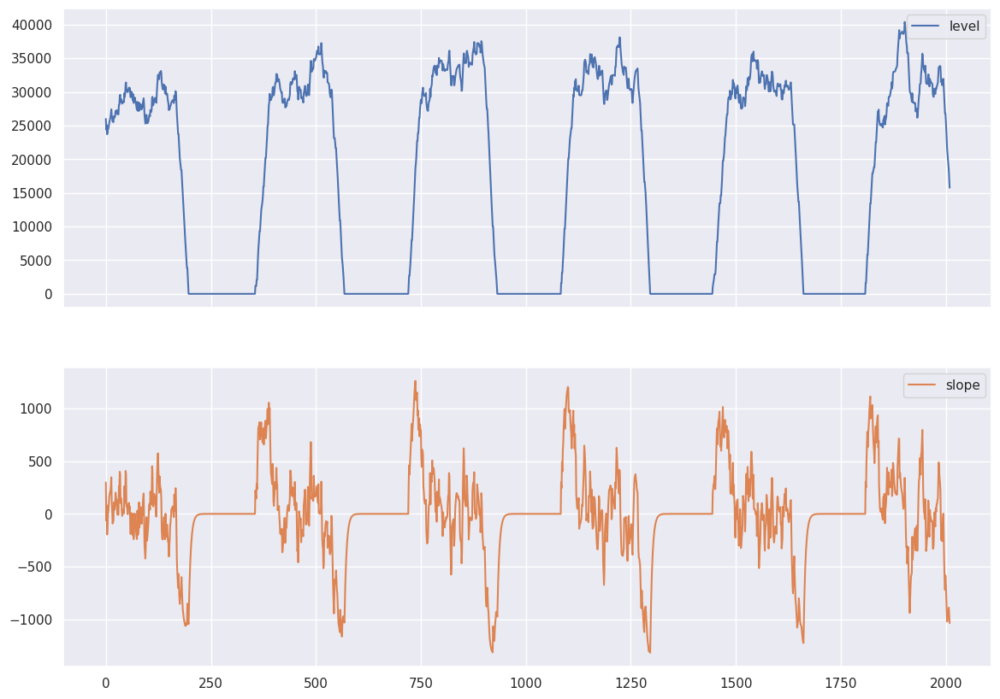

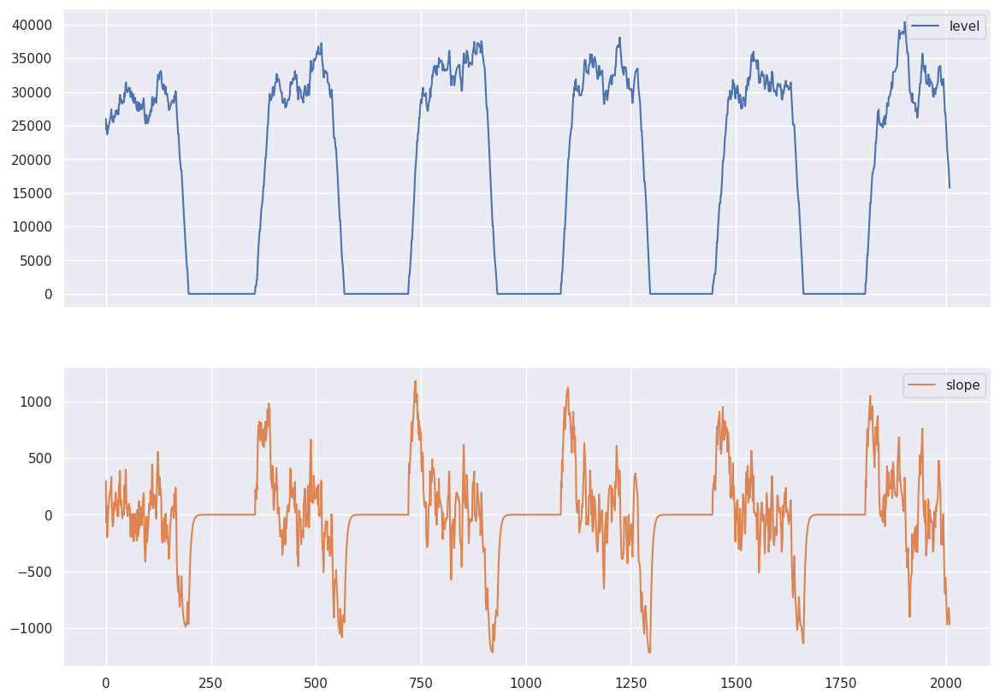

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


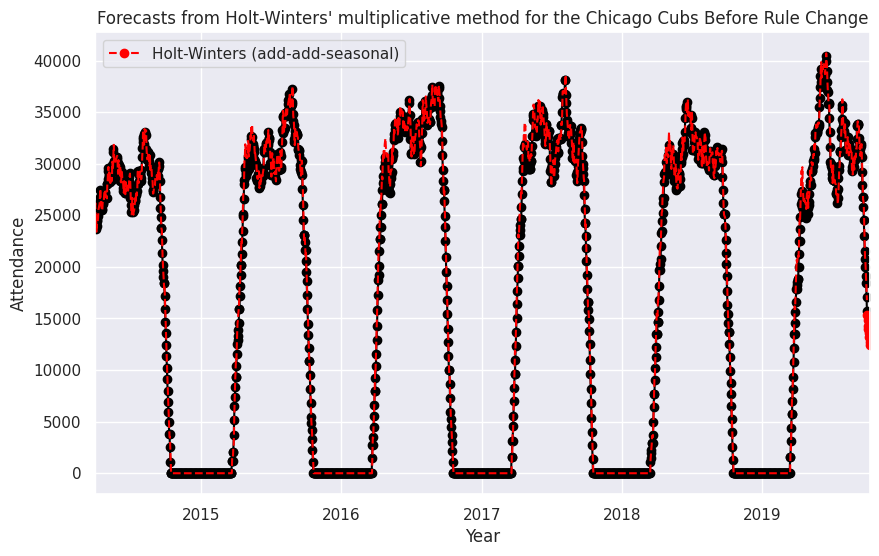

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


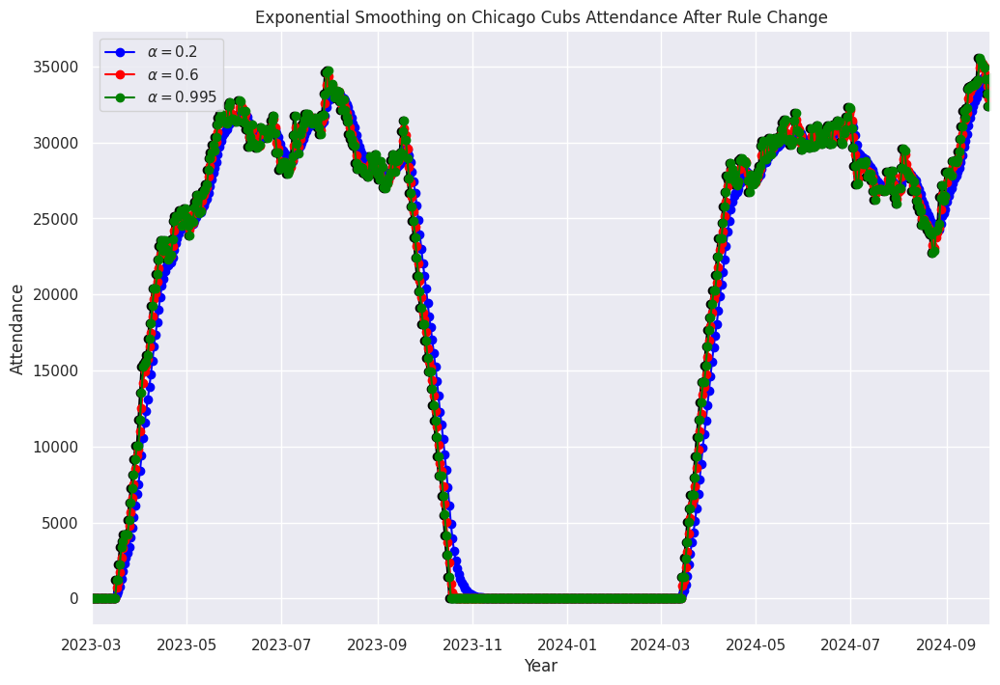

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

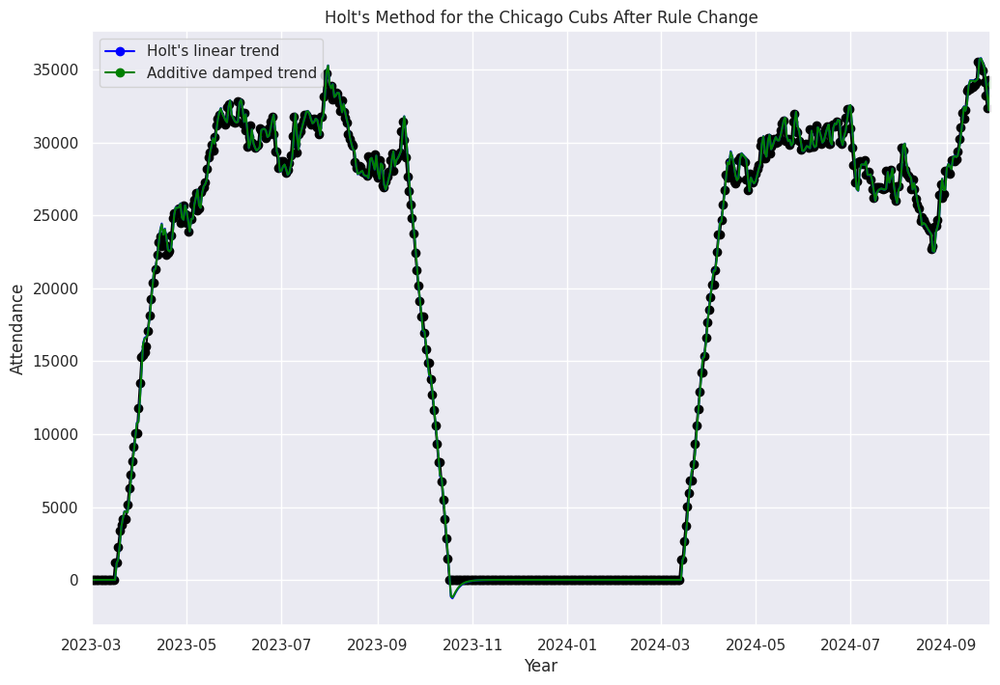

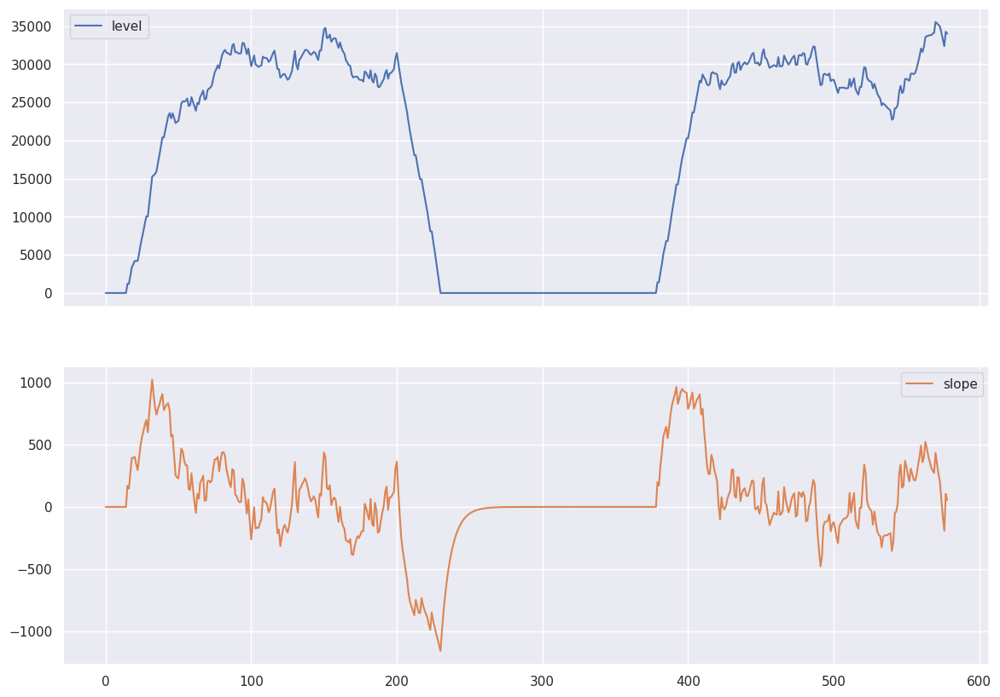

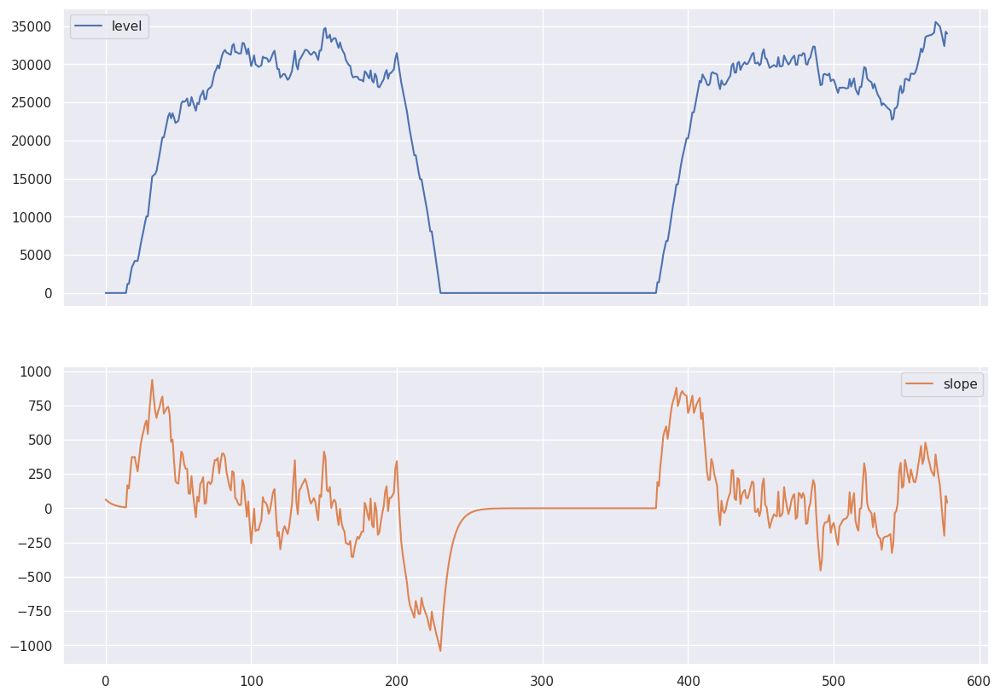

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


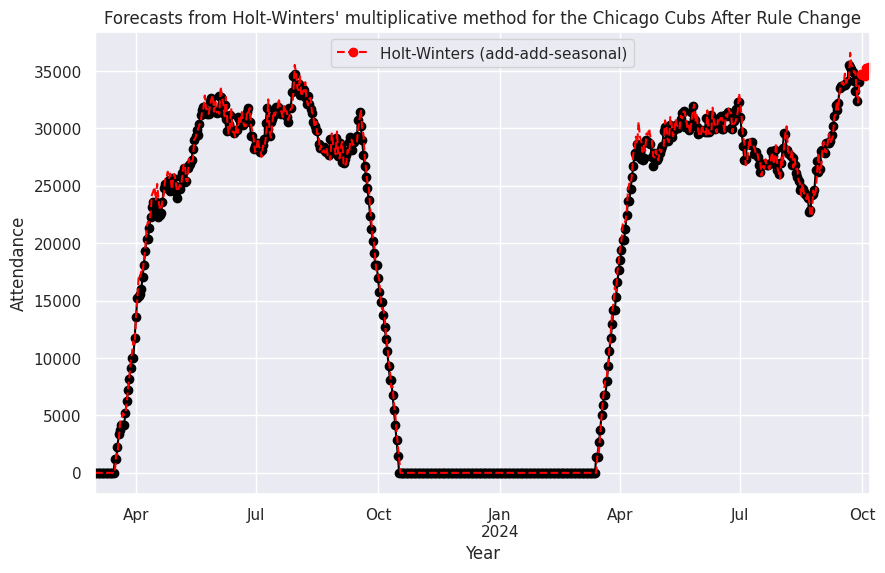

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds         184.116519   161.694444
Colorado Rockies        189.514749   159.975309
Pittsburgh Pirates      187.714391   159.348765
San Diego Padres        185.579646   163.802469
New York Mets           186.075221   164.271605
New York Yankees        191.371142   165.432099
Los Angeles Dodgers     191.195837   161.790123
Chicago Cubs            188.633014   160.398148
Baltimore Orioles              NaN          NaN
Kansas City Royals             NaN          NaN
18840.042778379353
20869.90280830281
17641.633986928104
19731.210074979757
Average Change in Yearly Attendance before ru

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


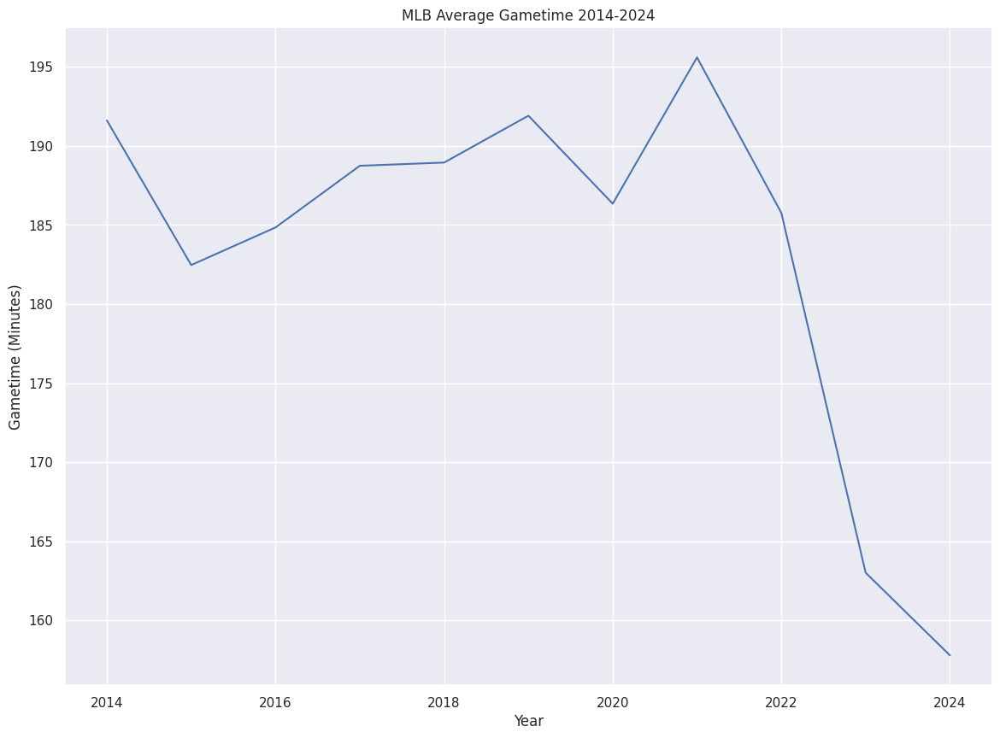

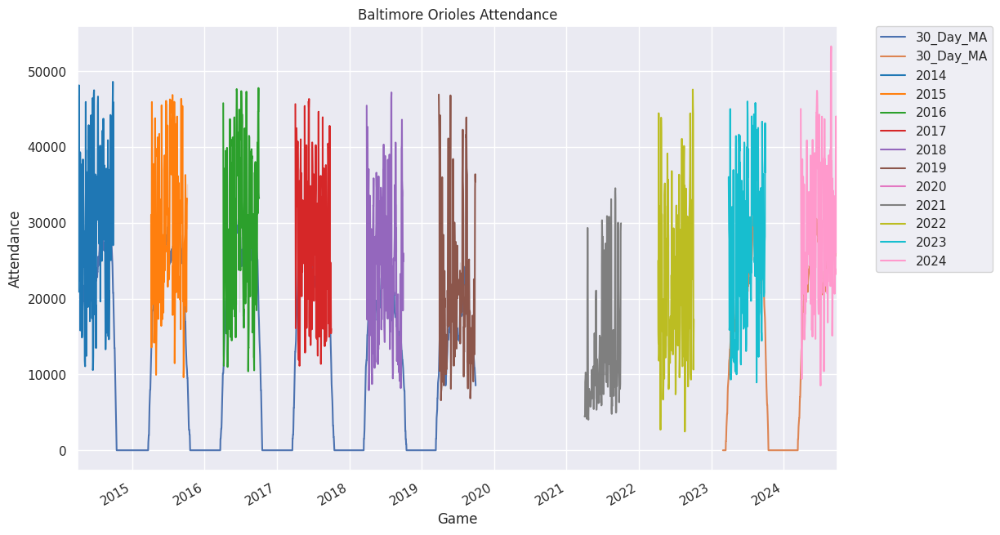

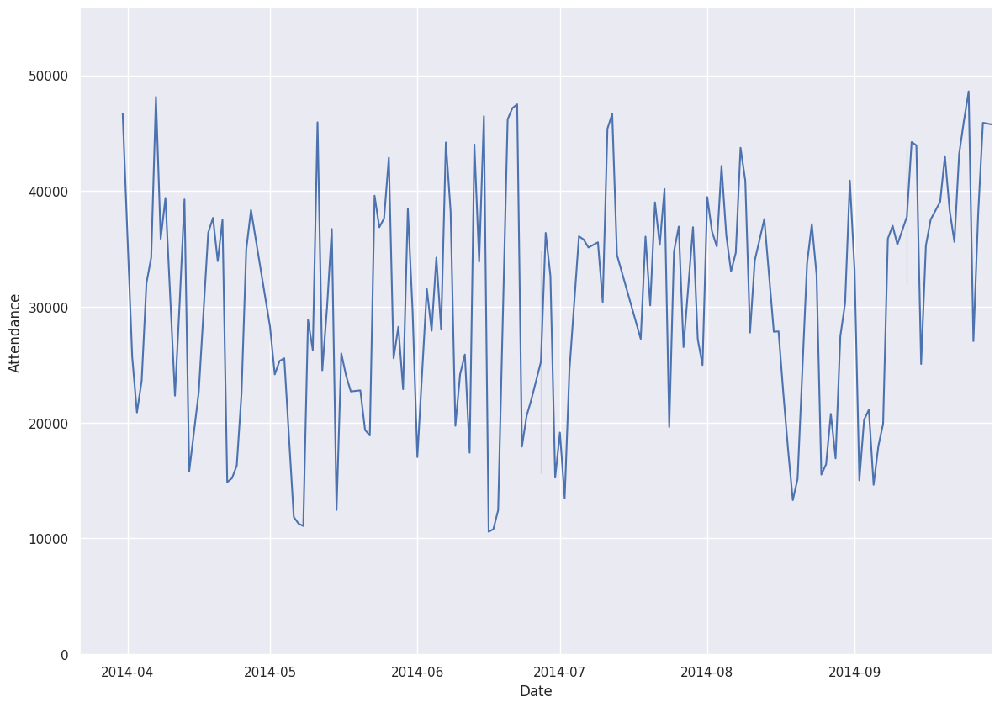

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


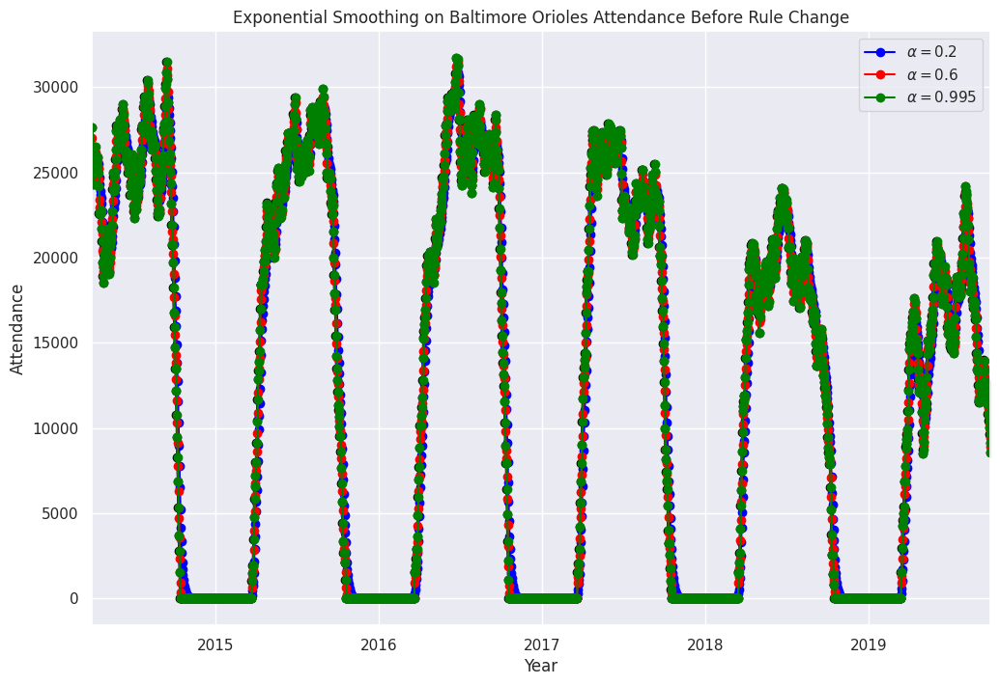

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

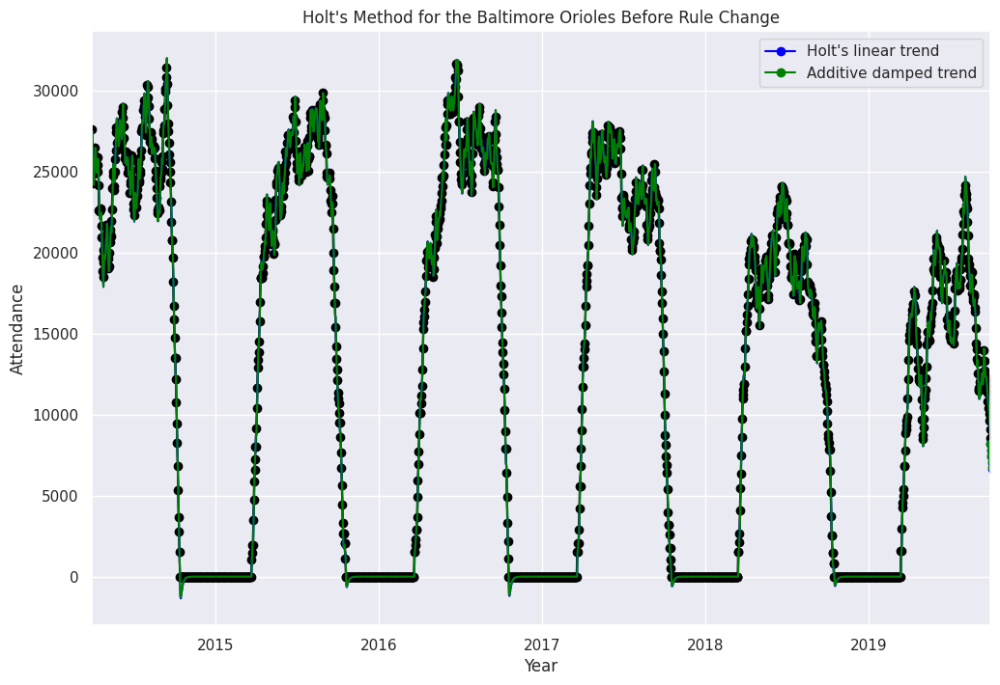

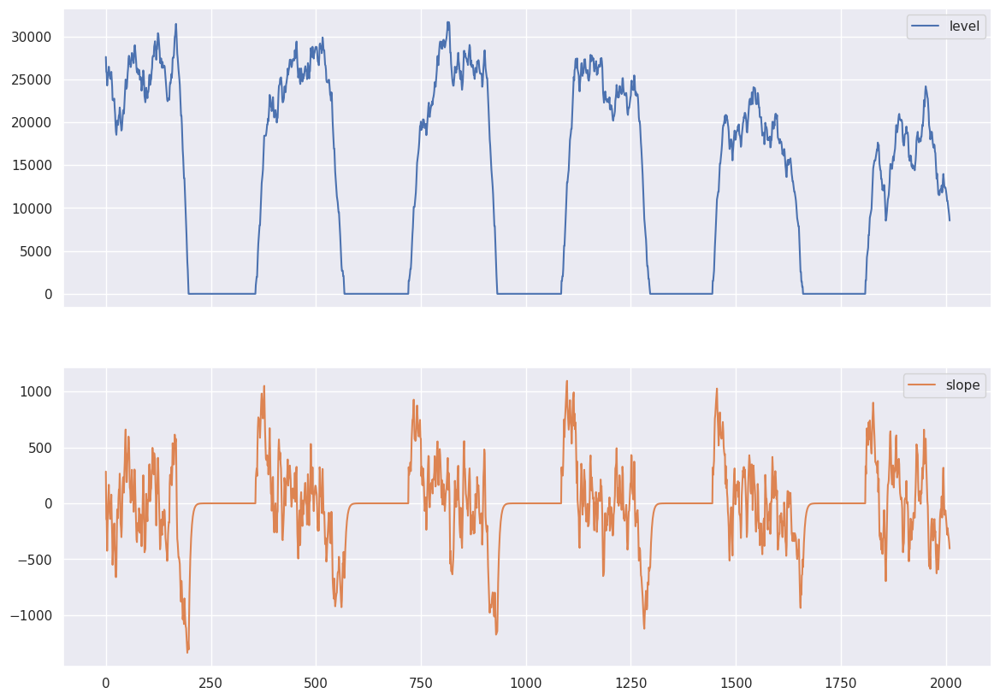

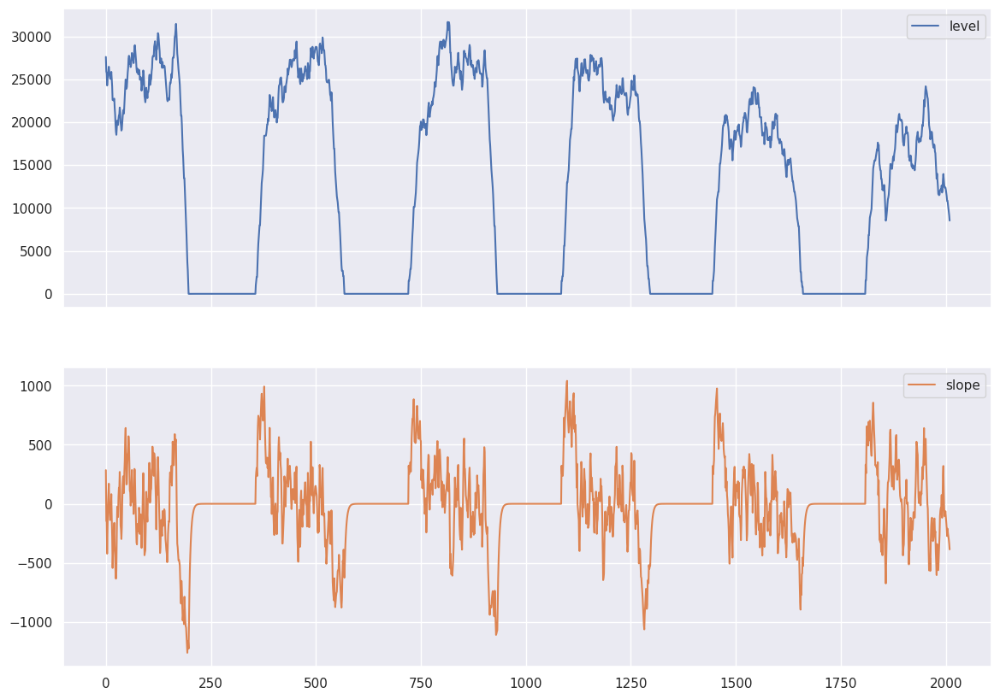

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


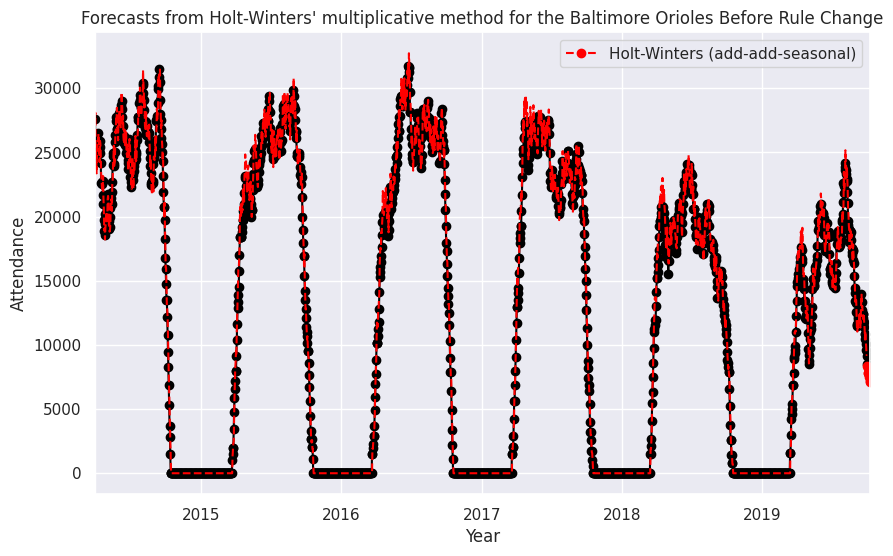

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


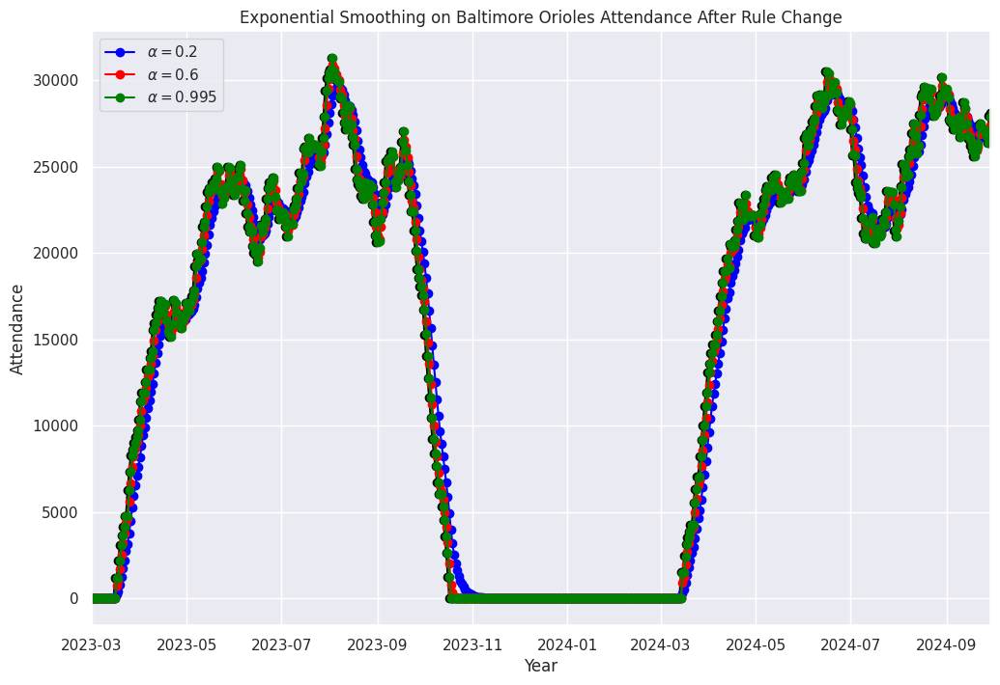

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

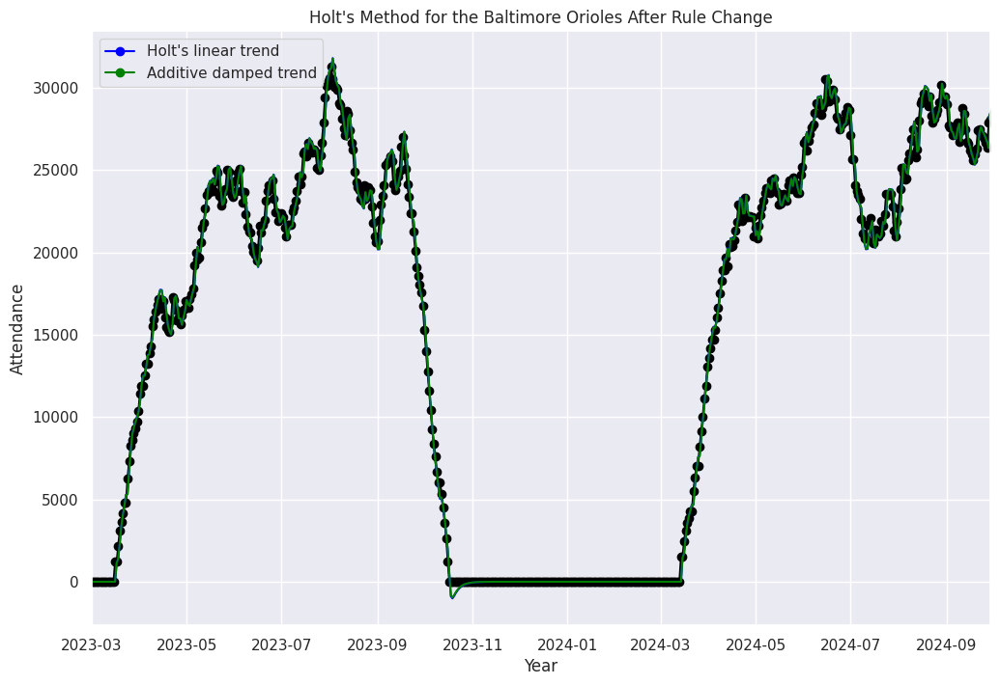

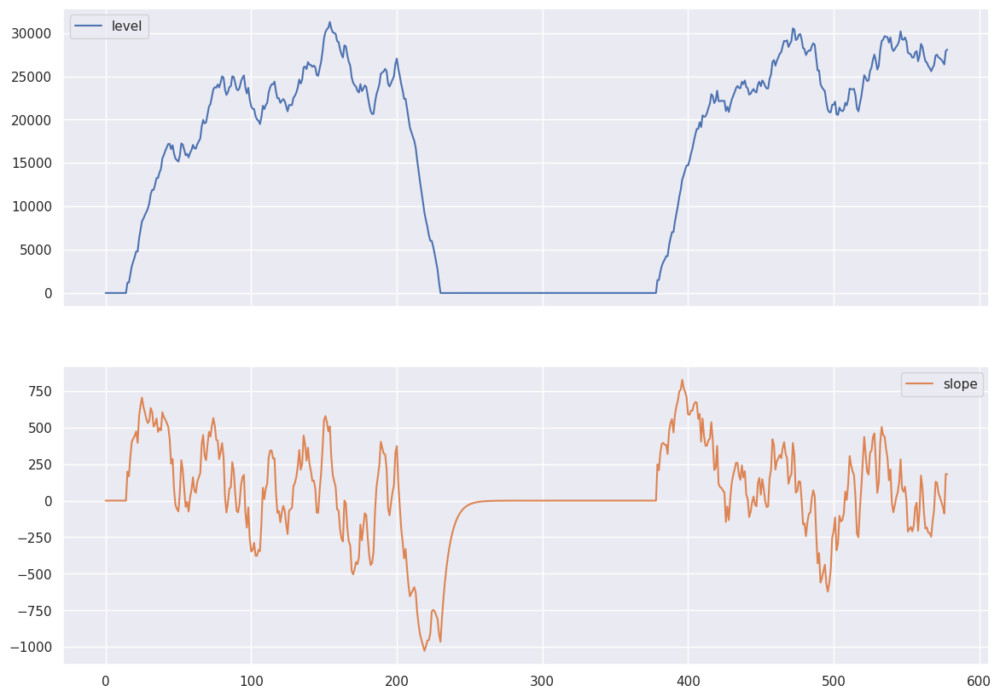

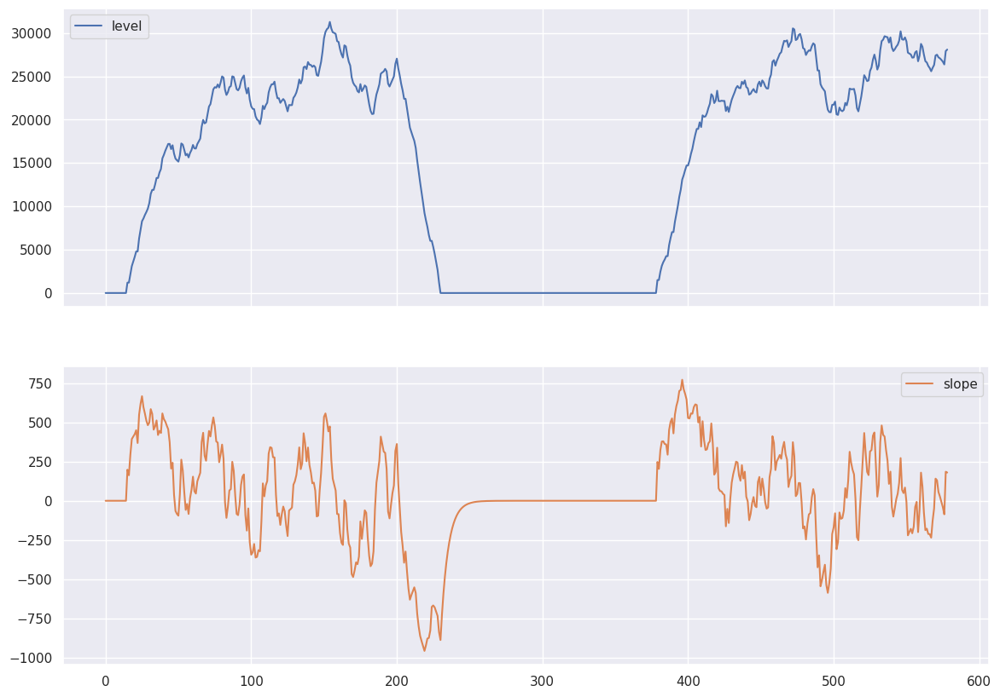

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


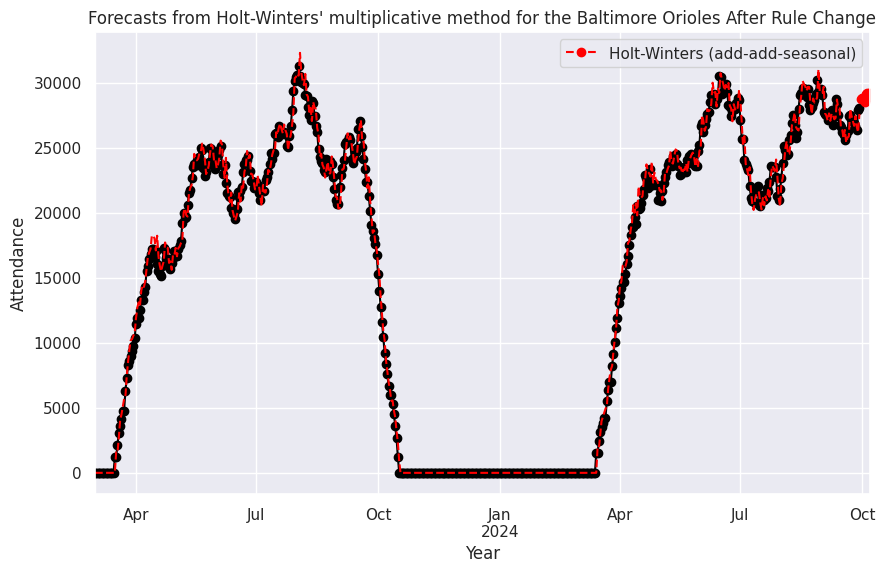

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds         184.116519   161.694444
Colorado Rockies        189.514749   159.975309
Pittsburgh Pirates      187.714391   159.348765
San Diego Padres        185.579646   163.802469
New York Mets           186.075221   164.271605
New York Yankees        191.371142   165.432099
Los Angeles Dodgers     191.195837   161.790123
Chicago Cubs            188.633014   160.398148
Baltimore Orioles       184.204277   164.953704
Kansas City Royals             NaN          NaN
17140.41599679881
11232.39768009768
14081.316993464052
16924.876138622018
Average Change in Yearly Attendance before rul

<ipython-input-3-daf8959546e9>:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df['30_Day_MA'] = df['30_Day_MA'].fillna(method='ffill')
/usr/local/lib/python3.11/dist-packages/seaborn/_base.py:1135: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  converter.update_units(seed_data)


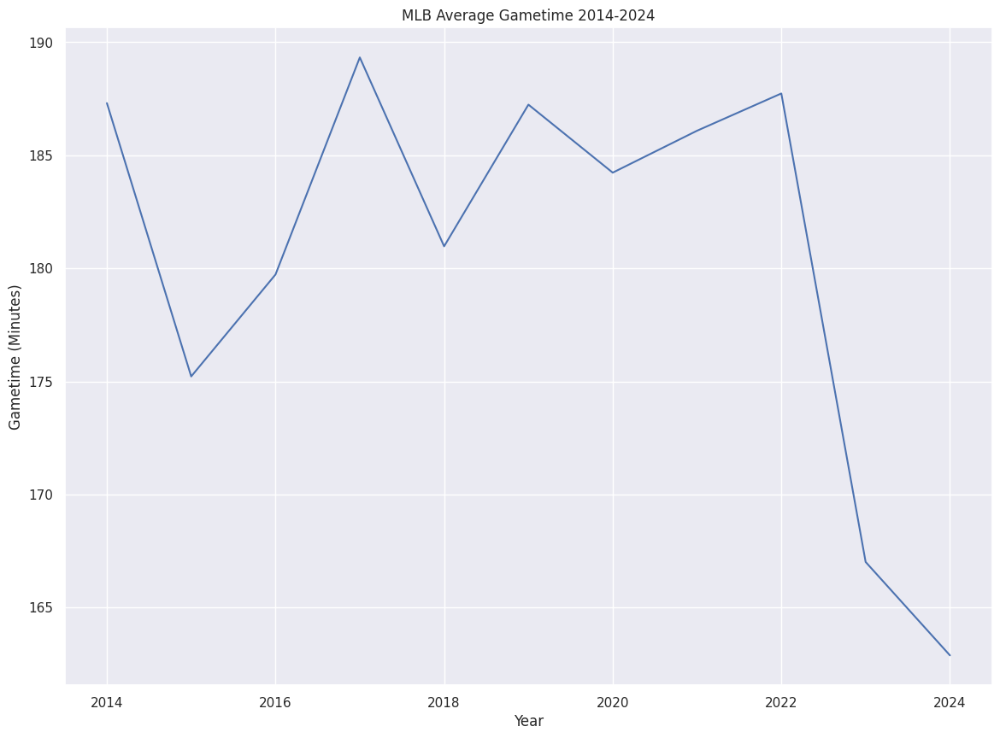

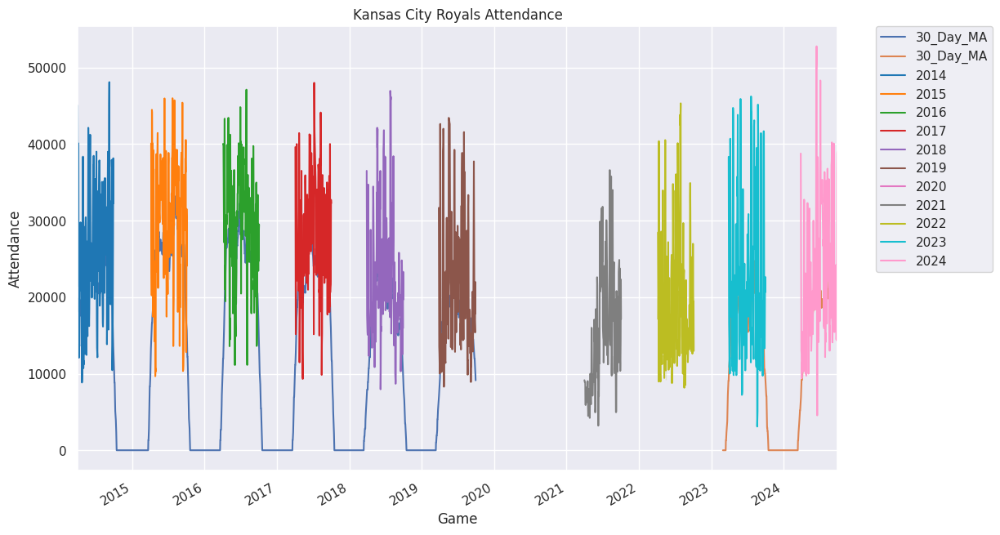

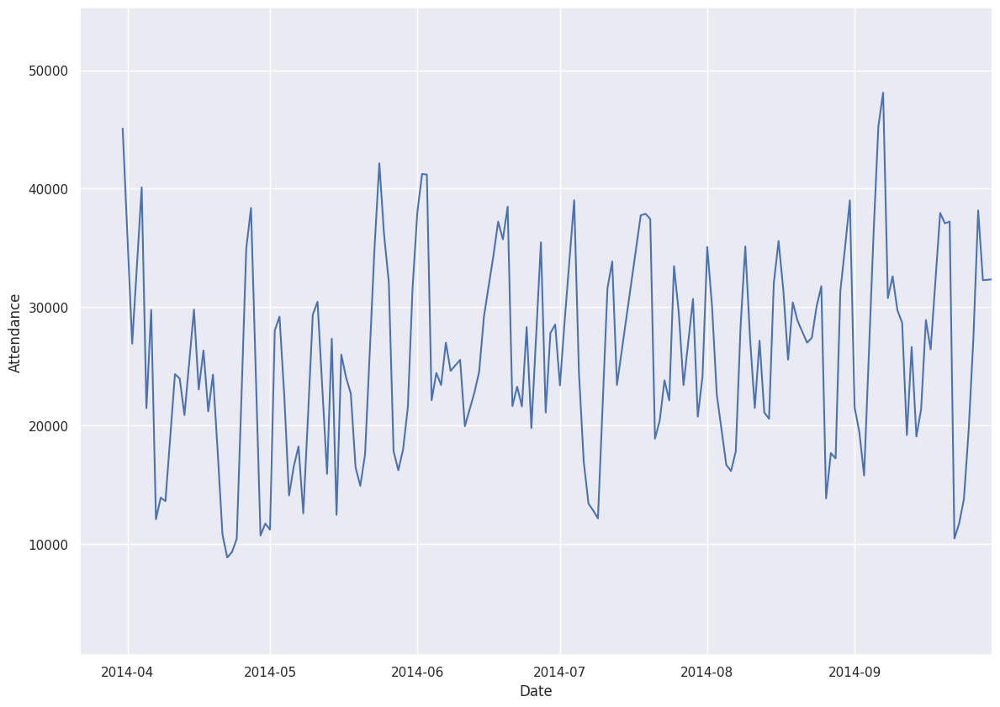

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


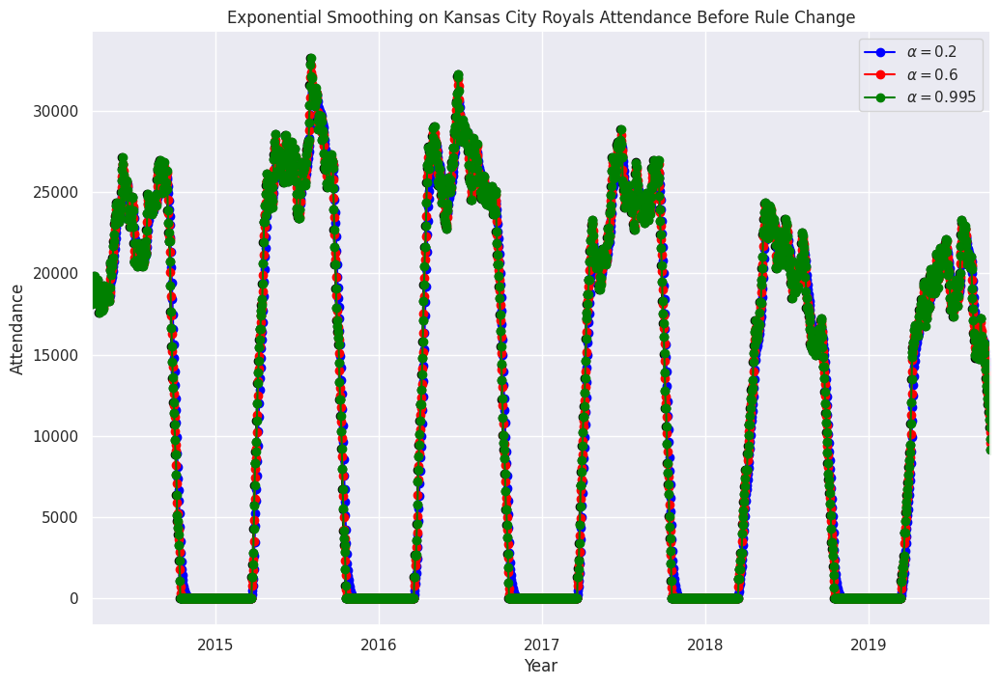

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

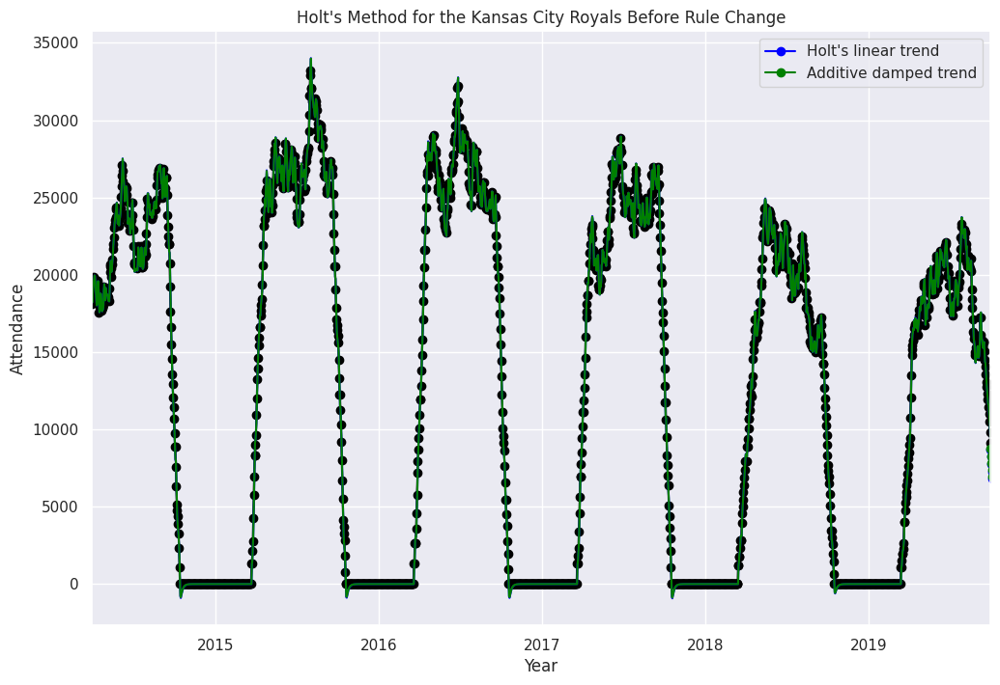

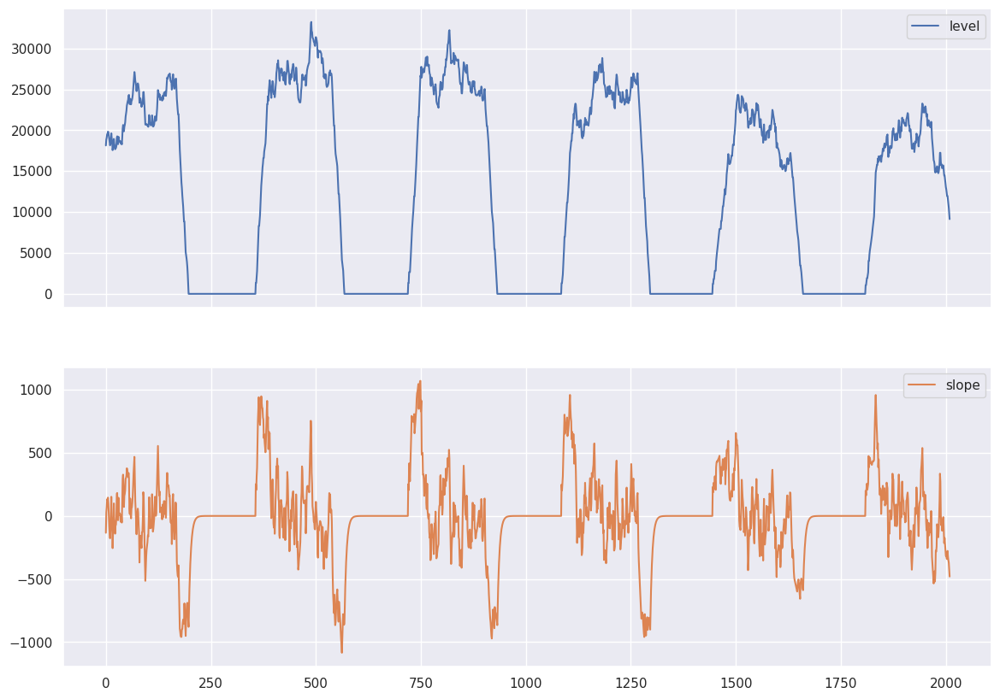

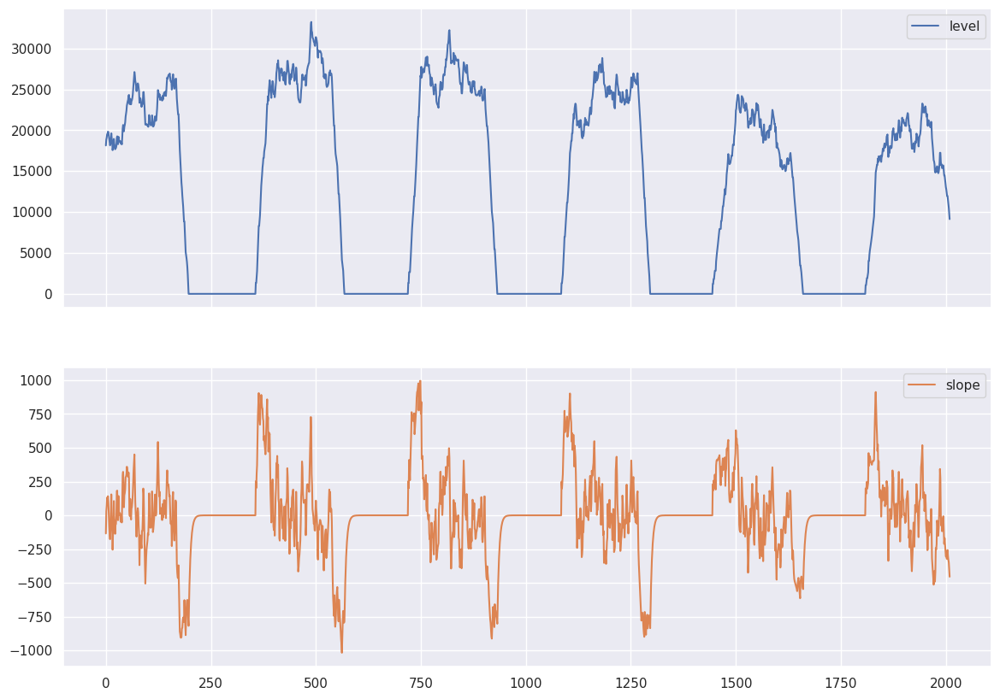

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


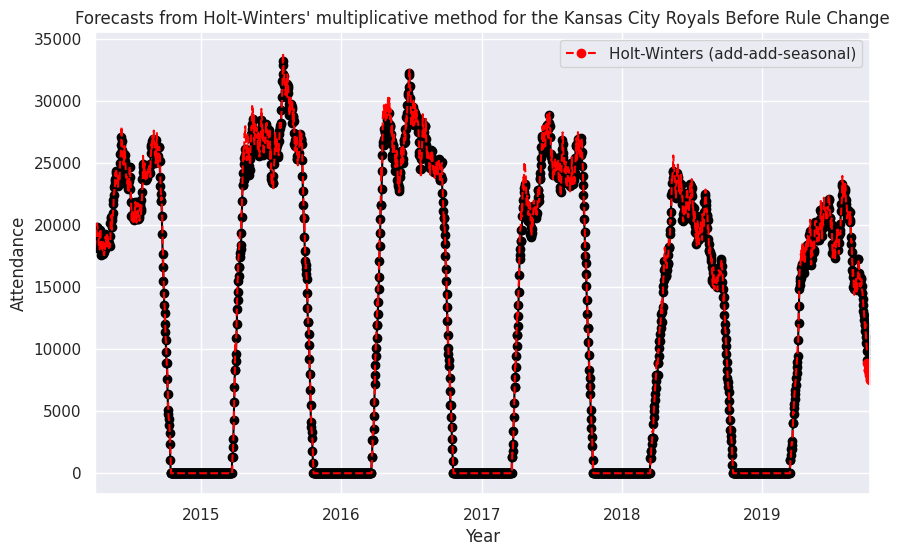

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-5-a23984301d26>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


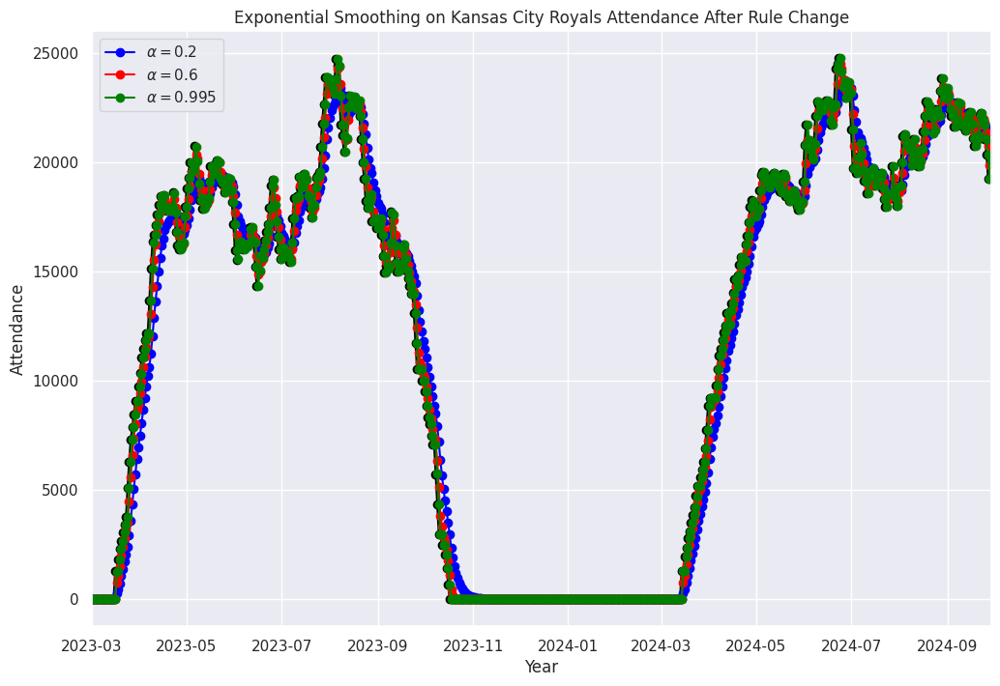

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
<ipython-input-6-37a5ade84125>:29: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:84: RuntimeWarning: overflow encountered in matmul
  return err.T @ err
/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/m

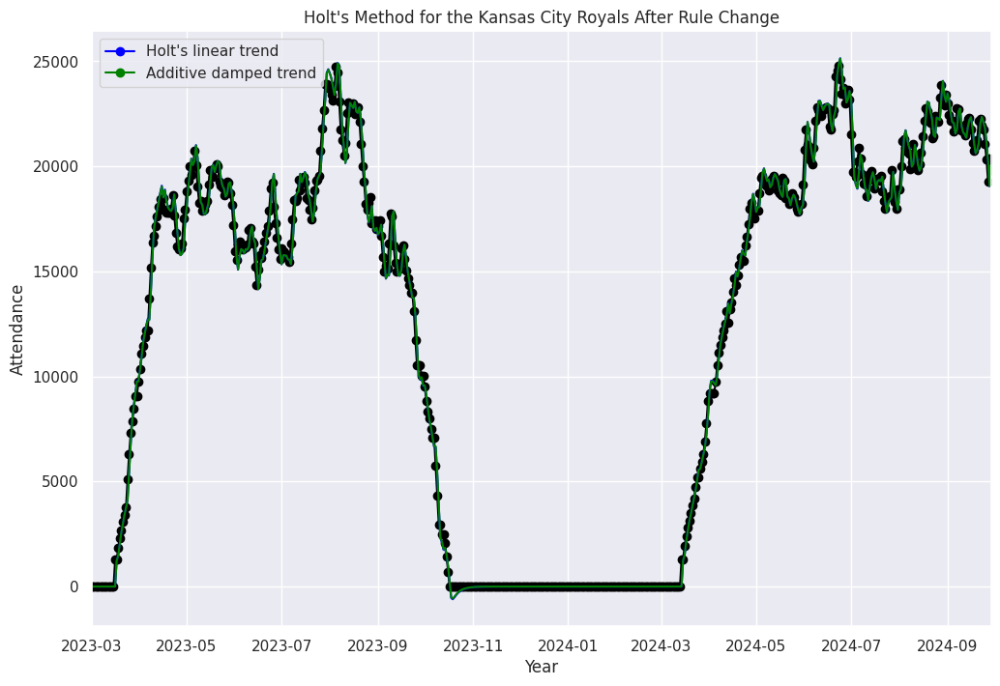

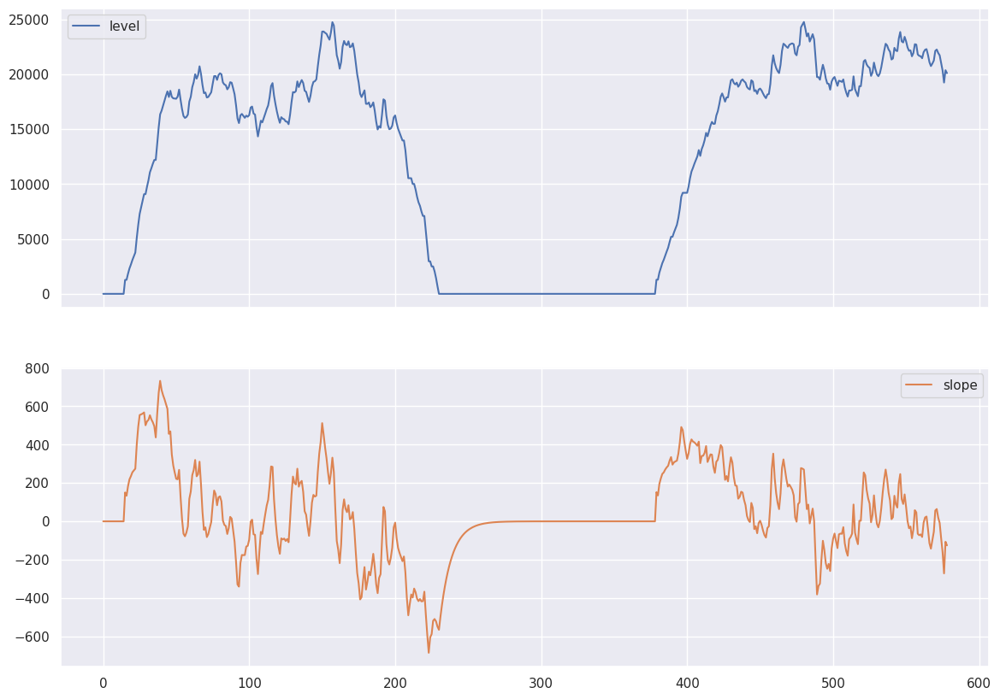

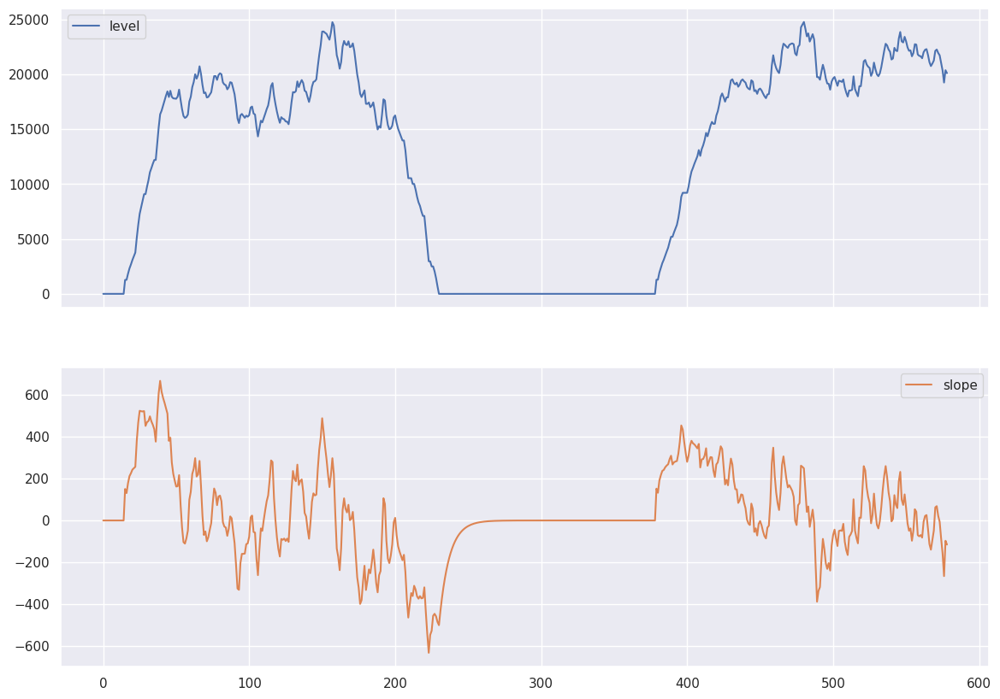

Figure 7.4: Level and slope components for Holt’s linear trend method and the additive damped trend method.


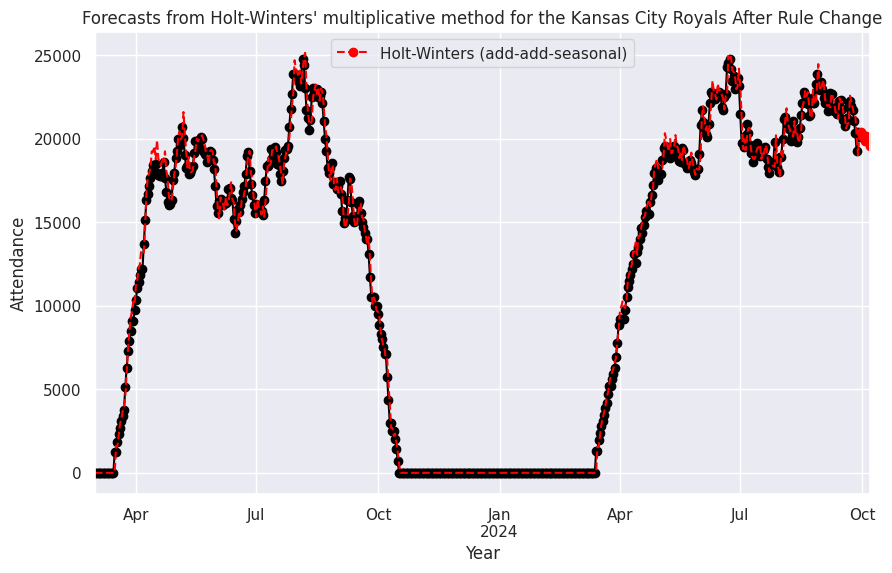

Figure 7.6: Forecasting Attendance using Holt-Winters method with both additive and multiplicative seasonality.
                     Before Change After Change
Arizona Diamondbacks    190.097345   163.493827
Detroit Tigers          185.696165   153.635802
Miami Marlins           183.902655   157.006173
Oakland Athletics       183.832596   159.728395
Seattle Mariners        183.817847   160.108025
Cincinnati Reds         184.116519   161.694444
Colorado Rockies        189.514749   159.975309
Pittsburgh Pirates      187.714391   159.348765
San Diego Padres        185.579646   163.802469
New York Mets           186.075221   164.271605
New York Yankees        191.371142   165.432099
Los Angeles Dodgers     191.195837   161.790123
Chicago Cubs            188.633014   160.398148
Baltimore Orioles       184.204277   164.953704
Kansas City Royals      181.815634       154.75
14990.485190302763
12352.516605616605
11148.441176470587
13333.037573731282
Average Change in Yearly Attendance before r

<ipython-input-10-2c06e9505449>:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=gametime_melted, x='Metric', y='Value', ax=axes[0], palette=['skyblue', 'coral'])
<ipython-input-10-2c06e9505449>:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=percentage_melted, x='Metric', y='Value', ax=axes[1], palette=['skyblue', 'coral'])


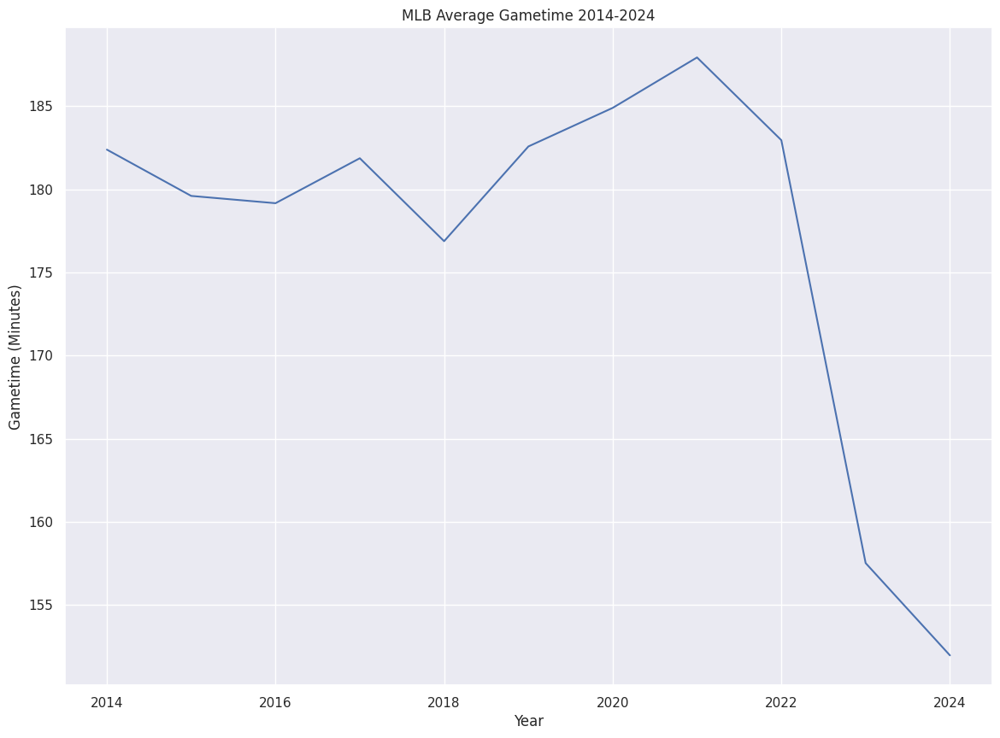

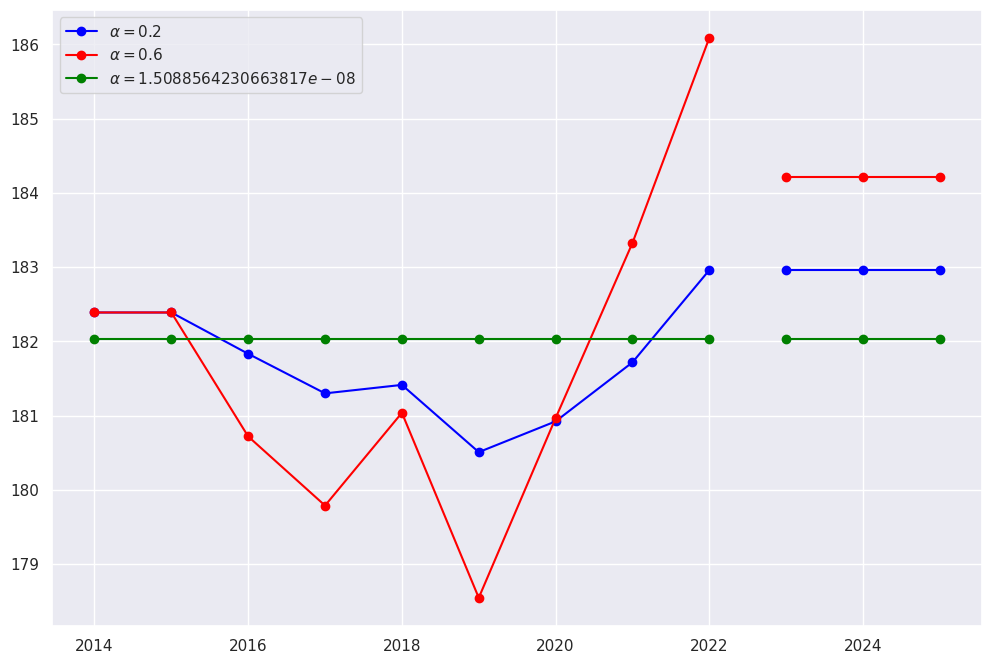

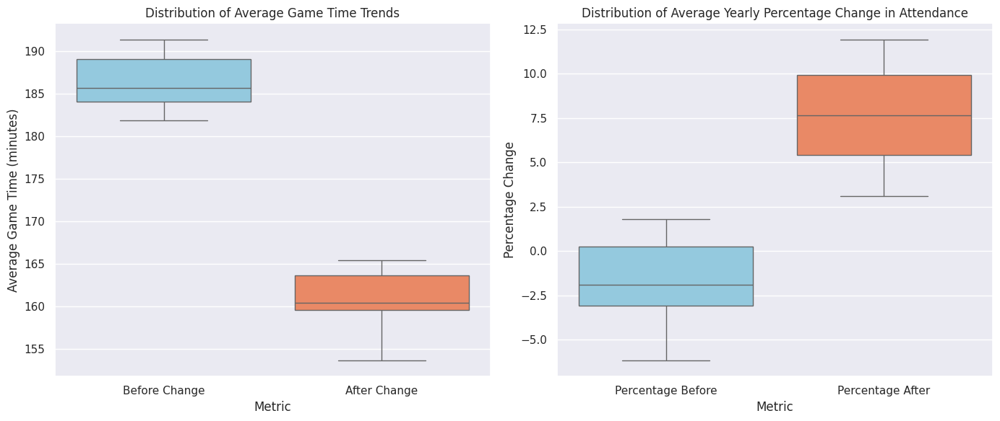



Total Average Percent Change in Yearly Attendance before rule changes -1.80%
Total Average Percent Change in Yearly Attendance after rule changes 7.59%

Total Average Change in game time before rule changes 186.50 mins
Total Average Change in game time after rule changes 160.69 mins


In [ ]:
currentNbrOfTeams = 0
team_names = ['Arizona Diamondbacks', 'Detroit Tigers', 'Miami Marlins', 'Oakland Athletics', 'Seattle Mariners', 'Cincinnati Reds', 'Colorado Rockies',
              'Pittsburgh Pirates', 'San Diego Padres', 'New York Mets', 'New York Yankees', 'Los Angeles Dodgers', 'Chicago Cubs', 'Baltimore Orioles', 'Kansas City Royals']
teams = ['AzDbacks', 'DetroitTigers', 'MiamiMarlins', 'OaklandAthletics', 'SeattleMariners', 'CinReds', 'ColRockies', 'PitPirates', 'SanPadres', 'NYMets',
         'Yankees', 'Dodgers', 'Cubs', 'Orioles', 'Royals']
path = '../datasets/'
excel_name = path + 'MarissaMasterMLB.xlsx'
time_period = 'Before'
runningPreviousTrend = 0
runningAfterTrend = 0
runningPercentageChangeBefore = 0
runningPercentageChangeAfter = 0
index = ['Previous Trend', 'After Trend', 'Percentage Before', 'Percentage After']
index_two = ['Before Change', 'After Change']

team_average_change_df = pd.DataFrame(columns=index, index=team_names)
game_time_df = pd.DataFrame(columns=index_two, index=team_names)


for team in teams:
  sheet = team
  team_name = team_names[currentNbrOfTeams]
  time_period = 'Before'

  if (currentNbrOfTeams == 5):
    excel_name = path + 'AlexFiveTeams.xlsx'

  if (currentNbrOfTeams == 10):
    excel_name = path + 'alecfiveteams.xlsx'

  df = get_data(excel_name, sheet)
  df_prior_attendance, df_after_attendance = get_time_series(df)
  df_prior_attendance.plot()
  df_after_attendance.plot()

  show_ten_years(df, team_name)

  ### Before Rule Change Analysis
  exponential_smoothing_method(df_prior_attendance, team_name, time_period)
  holt_method(df_prior_attendance, team_name, time_period)
  holt_winters_method(df_prior_attendance, team_name, time_period)

  time_period = 'After'

  ### After Rule Change Analysis
  exponential_smoothing_method(df_after_attendance, team_name, time_period)
  holt_method(df_after_attendance, team_name, time_period)
  holt_winters_method(df_after_attendance, team_name, time_period)

  ### Game Time Analysis
  df_prior_time, df_after_time = game_time_analysis(df)
  game_time_df.loc[team_name, 'Before Change'] = df_prior_time.loc[:, 'TimeMinutes'].mean()
  game_time_df.loc[team_name, 'After Change'] = df_after_time.loc[:, 'TimeMinutes'].mean()

  print(game_time_df)


  ### Average Yearly Attendance
  previousTrend, afterTrend, percentChangeBefore, percentChangeAfter = calculate_average_yearly_attendance(df_prior_attendance, df_after_attendance, team_name)

  team_average_change_df.loc[team_name, 'Previous Trend'] = previousTrend
  team_average_change_df.loc[team_name, 'After Trend'] = afterTrend
  team_average_change_df.loc[team_name, 'Percentage Before'] = percentChangeBefore
  team_average_change_df.loc[team_name, 'Percentage After'] = percentChangeAfter

  currentNbrOfTeams += 1


## Call Total Average Function after for loop
total_average_change(team_average_change_df, game_time_df)
